#Configurações

In [ ]:
import pandas as pd
import requests
from io import StringIO
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import plotly.offline as py
import plotly.graph_objs as go
import os
import shutil
from sklearn.utils import resample
from plotly.offline import plot, iplot
from google.colab import files
from matplotlib.pyplot import figure
import cufflinks as cf 
cf.go_offline()
py.offline.init_notebook_mode(connected = True)
import plotly.io as pio
pio.renderers
pio.renderers.default = 'colab'

  


Configurações para o tamanho da fonte dos gráficos. 
Não utilizar se estiver analisando pelo próprio notebook.

In [ ]:

matplotlib.rc('xtick', labelsize=47) 
matplotlib.rc('ytick', labelsize=55) 

font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 45}

matplotlib.rc('font', **font)

pd.set_option('display.float_format', lambda x: '%.10f' % x)
pd.options.display.float_format = '{:.10f}'.format

plt.rcParams["axes.formatter.limits"] = (-5, 12)


#Somatorio total de estudantes no FIES

In [ ]:
dataTotalPorSemestre = {'Estudantes': ['ORIGINAL', 'SEM REPETIÇÃO', 'SEM NULOS'],
         '2011.1': [576114, 92952, 92942],
         '2011.2': [1606435 , 185458 , 185435],
         '2012.1': [2137020 , 392690, 392606],
         '2012.2': [3170660 , 497368, 497111],
         '2013.1': [4890613 , 788016, 786756],
         '2013.2': [5888788, 945474, 943440],
         '2014.1': [7842802, 1277870, 1273413],
         '2014.2': [8271821 , 1399696, 1394126],
         '2015.1': [5934429 , 1311145, 1303993],
         '2015.2': [8523006, 1405101, 1397091],
         '2016.1': [9441074 , 1409165, 1399374],
         '2016.2': [2213957, 1227082, 1226605],
         '2017.1': [8071911 , 1240525, 1102478],
         '2017.2': [5712025 , 1076720, 859495],
         '2018.1': [6958469 , 1057998, 1057162],
         '2018.2': [3636464 , 712009, 711691],
         '2019.1': [3095907 , 512085, 511879],
         '2019.2': [553692 , 172789, 172592],
          'Total': [88525187,15704143,15308189]
         }

In [ ]:
dfTotalPorSemestre = pd.DataFrame(dataTotalPorSemestre)
dfTotalPorSemestre.set_index('Estudantes', inplace=True)
dfTotalPorSemestre

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2,Total
Estudantes,,,,,,,,,,,,,,,,,,,
ORIGINAL,576114,1606435,2137020,3170660,4890613,5888788,7842802,8271821,5934429,8523006,9441074,2213957,8071911,5712025,6958469,3636464,3095907,553692,88525187
SEM REPETIÇÃO,92952,185458,392690,497368,788016,945474,1277870,1399696,1311145,1405101,1409165,1227082,1240525,1076720,1057998,712009,512085,172789,15704143
SEM NULOS,92942,185435,392606,497111,786756,943440,1273413,1394126,1303993,1397091,1399374,1226605,1102478,859495,1057162,711691,511879,172592,15308189


In [ ]:
dfTotalPorSemestreTrasposta = dfTotalPorSemestre.T
dfTotalPorSemestreTrasposta 


Estudantes,ORIGINAL,SEM REPETIÇÃO,SEM NULOS
2011.1,576114,92952,92942
2011.2,1606435,185458,185435
2012.1,2137020,392690,392606
2012.2,3170660,497368,497111
2013.1,4890613,788016,786756
2013.2,5888788,945474,943440
2014.1,7842802,1277870,1273413
2014.2,8271821,1399696,1394126
2015.1,5934429,1311145,1303993
2015.2,8523006,1405101,1397091


Usaremos esses dados para as análises de quantidade geral de pessoas, e também com base para conferir se nossas contas e analises das outas categorias estão corretas. A maioria das análises terá uma secção totaisX, que representa o total da respectiva análise, e que deve possuir os valores iguais á estudantes sem nulos (na maioria dos casos).

#Grupo 1:

##Por escola de origem

In [ ]:
dataPorEscolaDeOrigem = {'Tipo de escola de origem': ['PUBLICA', 'PRIVADA', 'PARCIALMENTE-PUBLICA'],
         '2011.1': [61801, 23365, 7776],
         '2011.2': [124624, 44491, 16320],
         '2012.1': [284107, 77641, 30858],
         '2012.2': [365724, 94247, 37140],
         '2013.1': [595421, 137088, 54247],
         '2013.2': [709394, 168823, 65223],
         '2014.1': [972403, 216697, 84313],
         '2014.2': [1061402, 240080, 92644],
         '2015.1': [1007499, 212253, 84241],
         '2015.2': [1062420, 243170, 91501],
         '2016.1': [1059807, 248416, 91151],
         '2016.2': [925462, 222107, 79036],
         '2017.1': [828368, 202585, 71525],
         '2017.2': [647942, 157304, 54249],
         '2018.1': [797216, 192961, 66985],
         '2018.2': [526024, 140756, 44911],
         '2019.1': [373936, 105443, 32500],
         '2019.2': [125527, 37099, 9966],
         }

         

In [ ]:
dfPorEscolaDeOrigemPorSemestre = pd.DataFrame(dataPorEscolaDeOrigem)
dfPorEscolaDeOrigemPorSemestre.set_index('Tipo de escola de origem', inplace=True)
dfPorEscolaDeOrigemPorSemestre

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
Tipo de escola de origem,,,,,,,,,,,,,,,,,,
PUBLICA,61801,124624,284107,365724,595421,709394,972403,1061402,1007499,1062420,1059807,925462,828368,647942,797216,526024,373936,125527
PRIVADA,23365,44491,77641,94247,137088,168823,216697,240080,212253,243170,248416,222107,202585,157304,192961,140756,105443,37099
PARCIALMENTE-PUBLICA,7776,16320,30858,37140,54247,65223,84313,92644,84241,91501,91151,79036,71525,54249,66985,44911,32500,9966


In [ ]:
dfPorEscolaDeOrigemPorSemestreTransposta = dfPorEscolaDeOrigemPorSemestre.T
dfPorEscolaDeOrigemPorSemestreTransposta

Tipo de escola de origem,PUBLICA,PRIVADA,PARCIALMENTE-PUBLICA
2011.1,61801,23365,7776
2011.2,124624,44491,16320
2012.1,284107,77641,30858
2012.2,365724,94247,37140
2013.1,595421,137088,54247
2013.2,709394,168823,65223
2014.1,972403,216697,84313
2014.2,1061402,240080,92644
2015.1,1007499,212253,84241
2015.2,1062420,243170,91501


In [ ]:
totaisPorEscolaDeOrigemPorSemestre = dfPorEscolaDeOrigemPorSemestre.sum(0, numeric_only=True)
totaisPorEscolaDeOrigemPorSemestre

2011.1      92942
2011.2     185435
2012.1     392606
2012.2     497111
2013.1     786756
2013.2     943440
2014.1    1273413
2014.2    1394126
2015.1    1303993
2015.2    1397091
2016.1    1399374
2016.2    1226605
2017.1    1102478
2017.2     859495
2018.1    1057162
2018.2     711691
2019.1     511879
2019.2     172592
dtype: int64

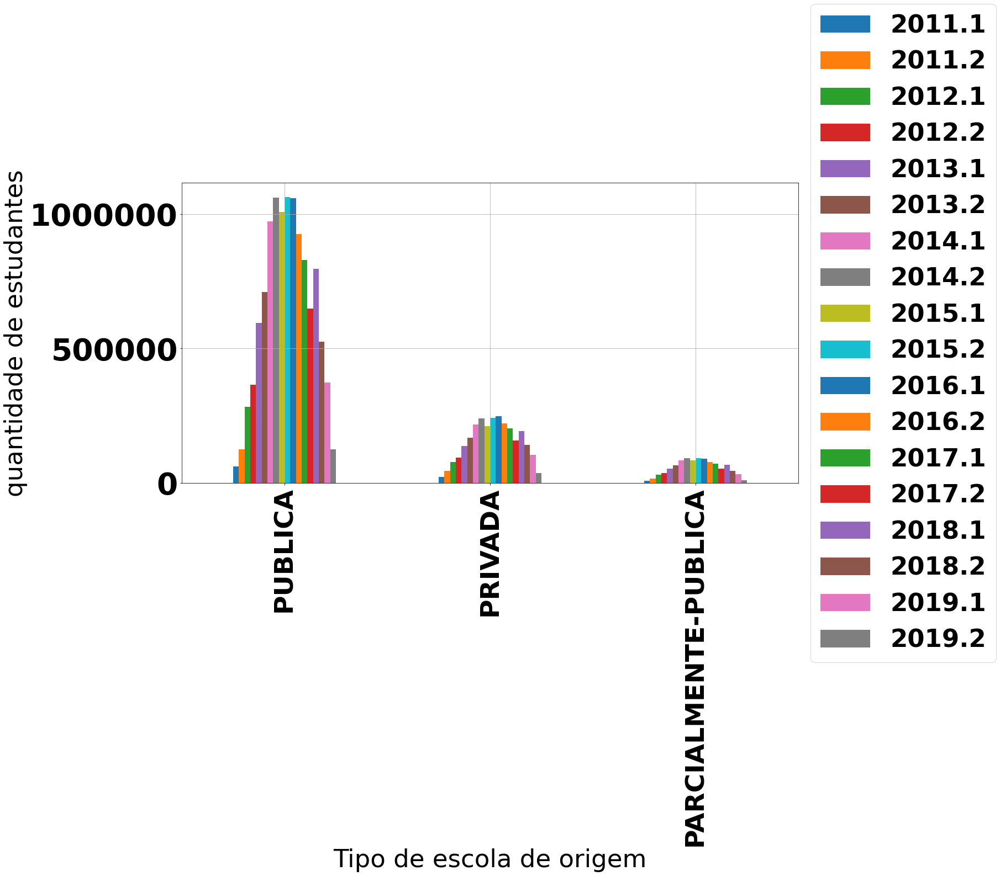

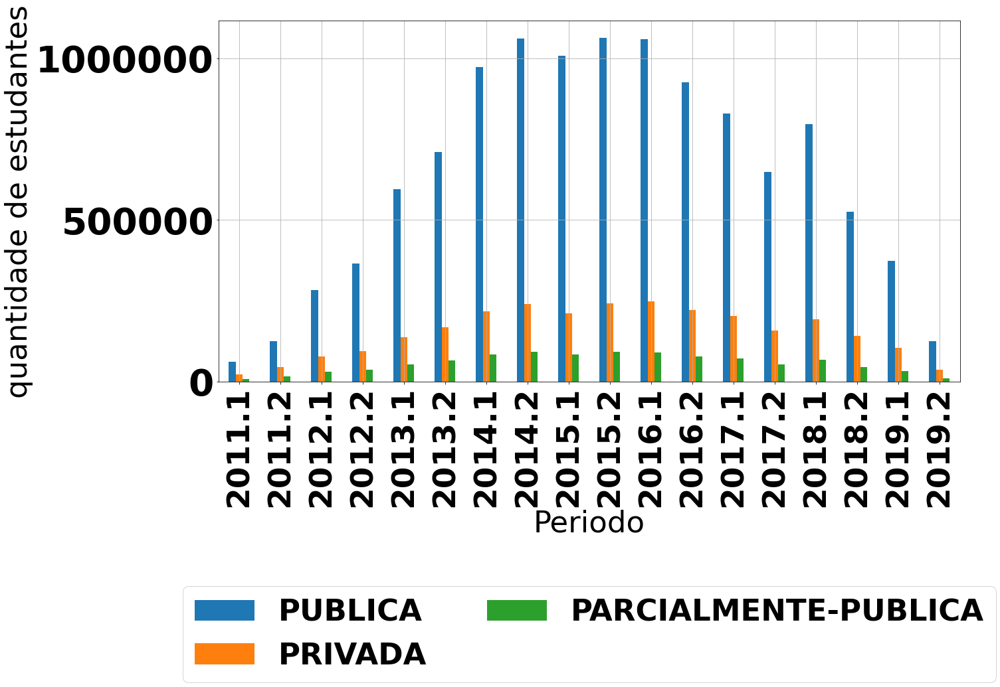

In [ ]:
graficoPorEscolaDeOrigemVsPeriodo = dfPorEscolaDeOrigemPorSemestre.plot.bar(grid=True, figsize= (20,10),
xlabel ="Tipo de escola de origem" ,ylabel= "quantidade de estudantes").legend(
    loc='center left',bbox_to_anchor=(1.0, 0.5));


graficoPorPeriodoVsPorEscolaDeOrigem = dfPorEscolaDeOrigemPorSemestreTransposta.plot.bar(grid=True, figsize= (20,10),
xlabel ="Periodo" ,ylabel= "quantidade de estudantes").legend(loc='center',ncol=2,bbox_to_anchor=(0.5, -0.7));


In [ ]:
dfPorEscolaDeOrigemPorcentagemCrescimento = dfPorEscolaDeOrigemPorSemestre[['2011.1','2011.2',
'2012.1','2012.2','2013.1','2013.2','2014.1','2014.2','2015.1','2015.2','2016.1','2016.2','2017.1','2017.2',
'2018.1','2018.2','2019.1','2019.2']].pct_change(periods = 1, axis = 1)
dfPorEscolaDeOrigemPorcentagemCrescimento

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
Tipo de escola de origem,,,,,,,,,,,,,,,,,,
PUBLICA,NaN,1.0165369492,1.2797133778,0.2872755687,0.6280610515,0.1914158217,0.3707516556,0.0915248102,-0.0507847168,0.0545122129,-0.0024594793,-0.1267636466,-0.1049140862,-0.2178089931,0.2303817317,-0.3401738048,-0.2891274923,-0.6643088657
PRIVADA,NaN,0.9041729082,0.7450945135,0.2138818408,0.4545608879,0.2314936391,0.2835751053,0.1079064316,-0.1159071976,0.1456610743,0.0215733849,-0.1059070269,-0.0878945733,-0.2235160550,0.2266757362,-0.2705468981,-0.2508809571,-0.6481606176
PARCIALMENTE-PUBLICA,NaN,1.0987654321,0.8908088235,0.2035776784,0.4606085083,0.2023337696,0.2926881622,0.0988103851,-0.0907020422,0.0861813131,-0.0038250948,-0.1329113230,-0.0950326434,-0.2415379238,0.2347693045,-0.3295364634,-0.2763465521,-0.6933538462


In [ ]:
dfPorEscolaDeOrigemPorcentagemCrescimentoTransposta = dfPorEscolaDeOrigemPorcentagemCrescimento.T
dfPorEscolaDeOrigemPorcentagemCrescimentoTransposta

Tipo de escola de origem,PUBLICA,PRIVADA,PARCIALMENTE-PUBLICA
2011.1,NaN,NaN,NaN
2011.2,1.0165369492,0.9041729082,1.0987654321
2012.1,1.2797133778,0.7450945135,0.8908088235
2012.2,0.2872755687,0.2138818408,0.2035776784
2013.1,0.6280610515,0.4545608879,0.4606085083
2013.2,0.1914158217,0.2314936391,0.2023337696
2014.1,0.3707516556,0.2835751053,0.2926881622
2014.2,0.0915248102,0.1079064316,0.0988103851
2015.1,-0.0507847168,-0.1159071976,-0.0907020422
2015.2,0.0545122129,0.1456610743,0.0861813131


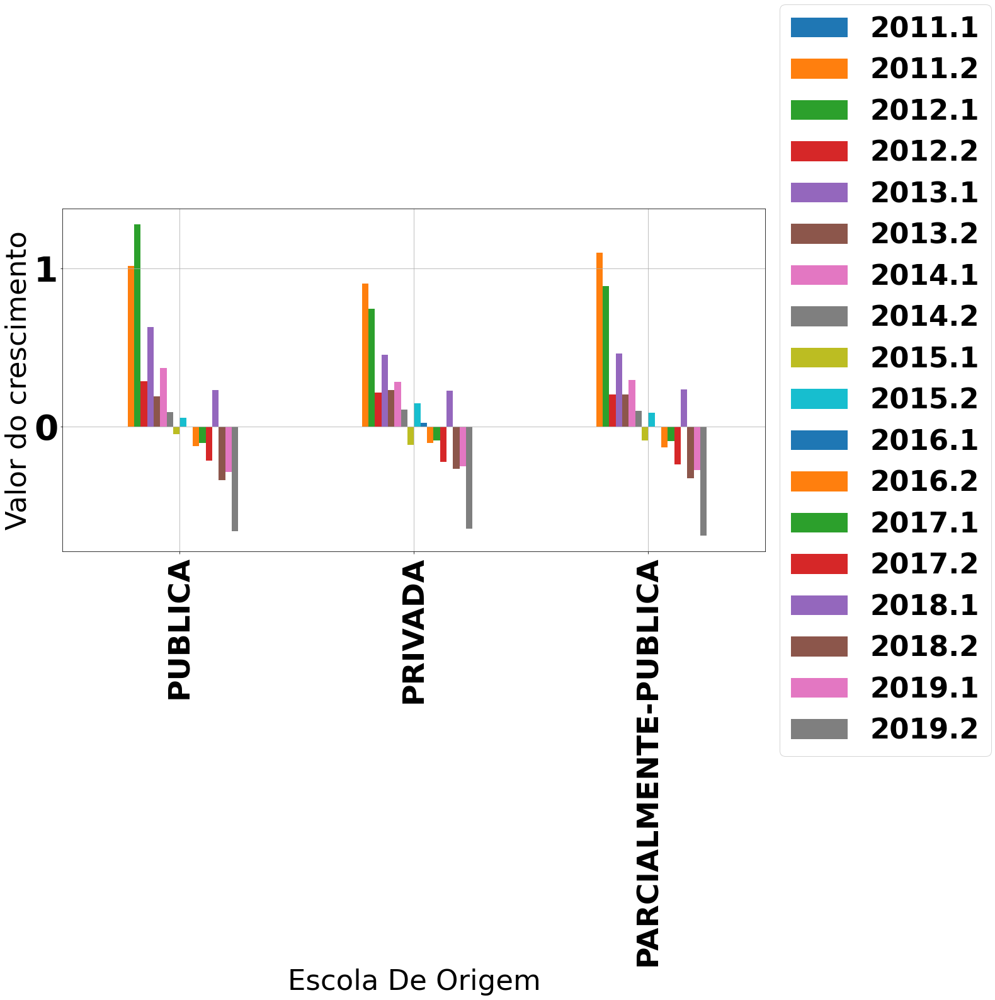

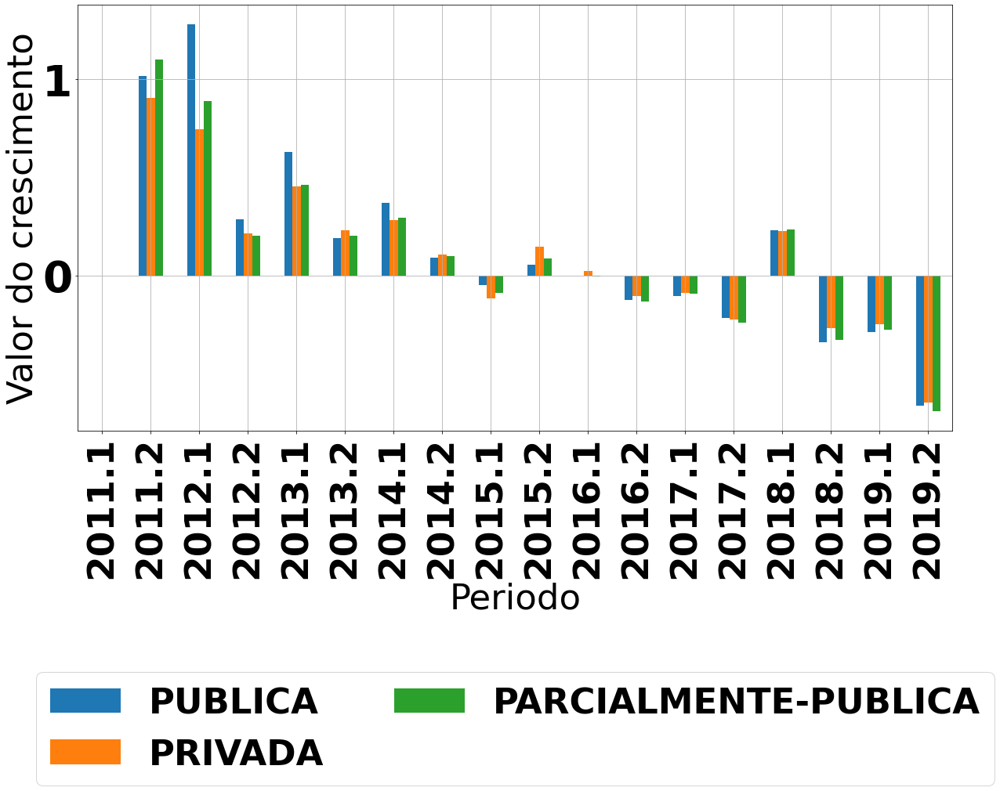

In [ ]:
graficoPorEscolaDeOrigemVsPeriodoCrescimento = dfPorEscolaDeOrigemPorcentagemCrescimento.plot.bar(grid=True, figsize= (20,10),
xlabel ="Escola De Origem" ,ylabel= "Valor do crescimento").legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

graficoPorPeriodoVsPorEscolaDeOrigemCrescimento = dfPorEscolaDeOrigemPorcentagemCrescimentoTransposta.plot.bar( 
grid=True, figsize= (20,10), xlabel ="Periodo" ,ylabel= "Valor do crescimento" ).legend(loc='center',ncol=2,bbox_to_anchor=(0.5, -0.7));


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f405f27d610>,
      dtype=object)

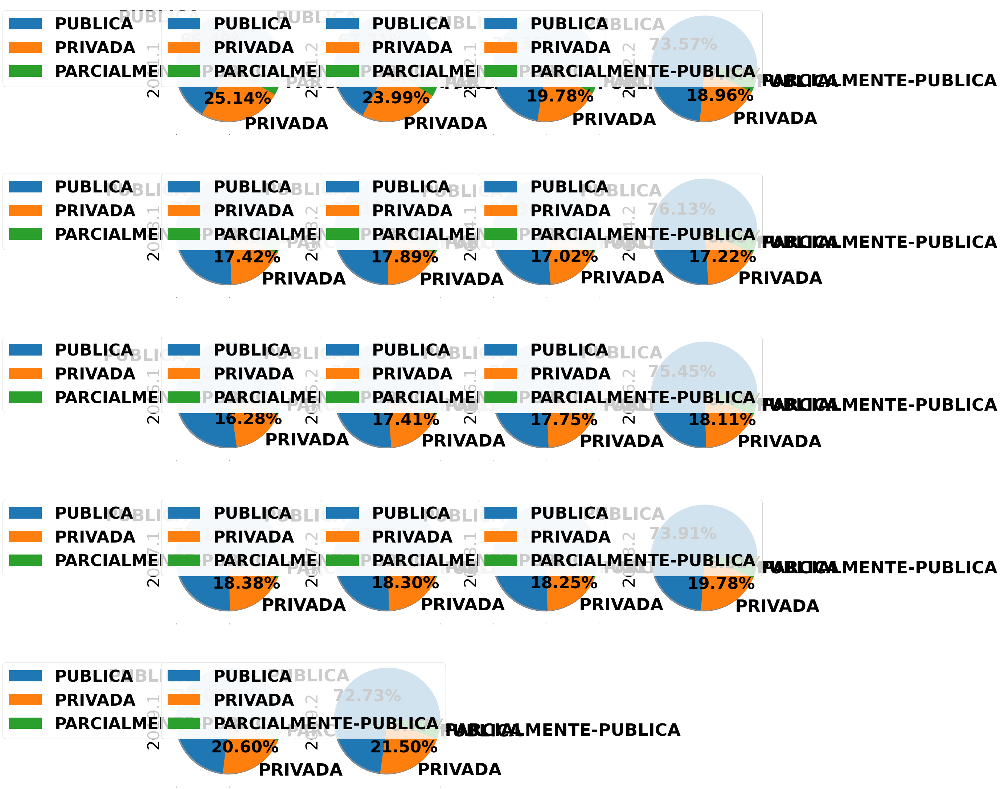

In [ ]:
dfPorEscolaDeOrigemPorSemestre.plot.pie(subplots=True, layout=(5,4), figsize=(30,40), shadow=True, autopct='%1.2f%%')

##Por raça

In [ ]:
dataPorRaca = {'Raça': ['BRANCO', 'PARDO', 'NEGRO', 'AMARELO', 'INDIO'],
         '2011.1': [55133, 28157, 7375, 2121, 156],
         '2011.2': [104734, 59849, 16081, 4398, 373],
         '2012.1': [209040, 135306, 38341, 9075, 844],
         '2012.2': [257653, 176264, 50614, 11493, 1087],
         '2013.1': [396041, 288321, 83144, 17568, 1682],
         '2013.2': [464384, 354173, 101349, 21440, 2094],
         '2014.1': [615110, 490276, 136676, 28516, 2835],
         '2014.2': [663968, 544648, 150732, 31628, 3150],
         '2015.1': [584569, 537523, 148690, 30199, 3012],
         '2015.2': [650331, 559771, 152345, 31609, 3035],
         '2016.1': [631669, 577349, 155394, 31913, 3049],
         '2016.2': [551655, 509617, 134756, 28002, 2575],
         '2017.1': [485739, 466264, 122984, 25125, 2366],
         '2017.2': [385174, 360591, 92478, 19453, 1799],
         '2018.1': [446248, 461328, 122986, 24210, 2390],
         '2018.2': [305414, 310415, 78150, 16215, 1497],
         '2019.1': [212445, 229005, 57565, 11764, 1100],
         '2019.2': [76088, 74823, 17560, 3786, 335],
         }

In [ ]:
dfPorRacaPorSemestre = pd.DataFrame(dataPorRaca)
dfPorRacaPorSemestre.set_index('Raça', inplace=True)
dfPorRacaPorSemestre

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
Raça,,,,,,,,,,,,,,,,,,
BRANCO,55133,104734,209040,257653,396041,464384,615110,663968,584569,650331,631669,551655,485739,385174,446248,305414,212445,76088
PARDO,28157,59849,135306,176264,288321,354173,490276,544648,537523,559771,577349,509617,466264,360591,461328,310415,229005,74823
NEGRO,7375,16081,38341,50614,83144,101349,136676,150732,148690,152345,155394,134756,122984,92478,122986,78150,57565,17560
AMARELO,2121,4398,9075,11493,17568,21440,28516,31628,30199,31609,31913,28002,25125,19453,24210,16215,11764,3786
INDIO,156,373,844,1087,1682,2094,2835,3150,3012,3035,3049,2575,2366,1799,2390,1497,1100,335


In [ ]:
dfPorRacaPorSemestreTransposta = dfPorRacaPorSemestre.T
dfPorRacaPorSemestreTransposta

Raça,BRANCO,PARDO,NEGRO,AMARELO,INDIO
2011.1,55133,28157,7375,2121,156
2011.2,104734,59849,16081,4398,373
2012.1,209040,135306,38341,9075,844
2012.2,257653,176264,50614,11493,1087
2013.1,396041,288321,83144,17568,1682
2013.2,464384,354173,101349,21440,2094
2014.1,615110,490276,136676,28516,2835
2014.2,663968,544648,150732,31628,3150
2015.1,584569,537523,148690,30199,3012
2015.2,650331,559771,152345,31609,3035


In [ ]:
totaisPorRacaPorSemestre = dfPorRacaPorSemestre.sum(0, numeric_only=True)
totaisPorRacaPorSemestre

2011.1      92942
2011.2     185435
2012.1     392606
2012.2     497111
2013.1     786756
2013.2     943440
2014.1    1273413
2014.2    1394126
2015.1    1303993
2015.2    1397091
2016.1    1399374
2016.2    1226605
2017.1    1102478
2017.2     859495
2018.1    1057162
2018.2     711691
2019.1     511879
2019.2     172592
dtype: int64

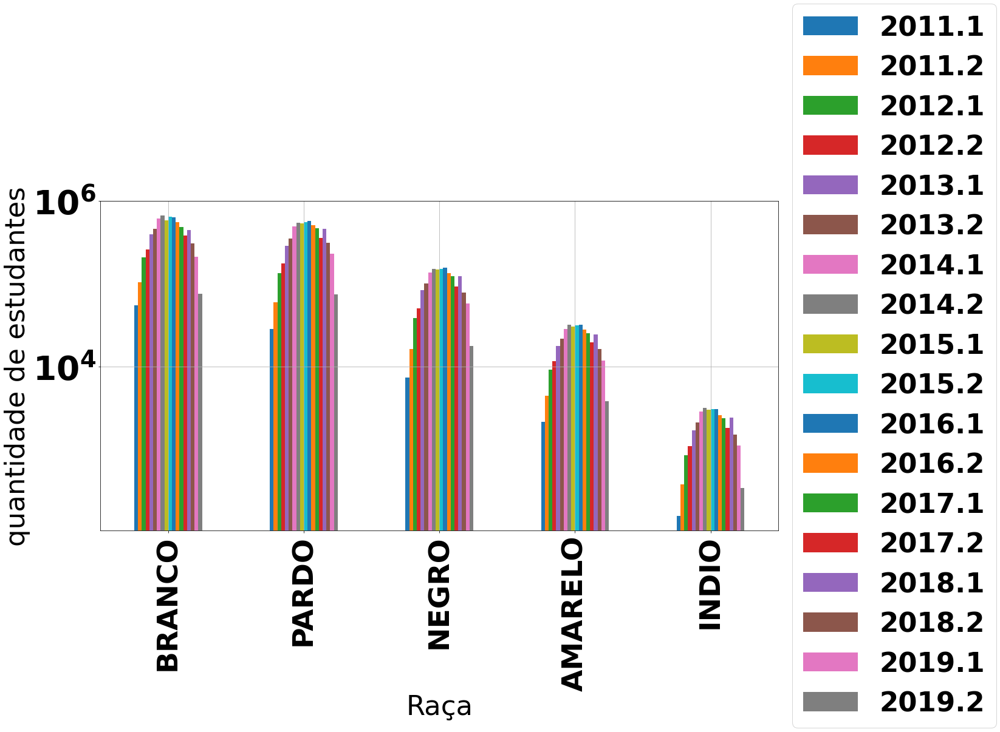

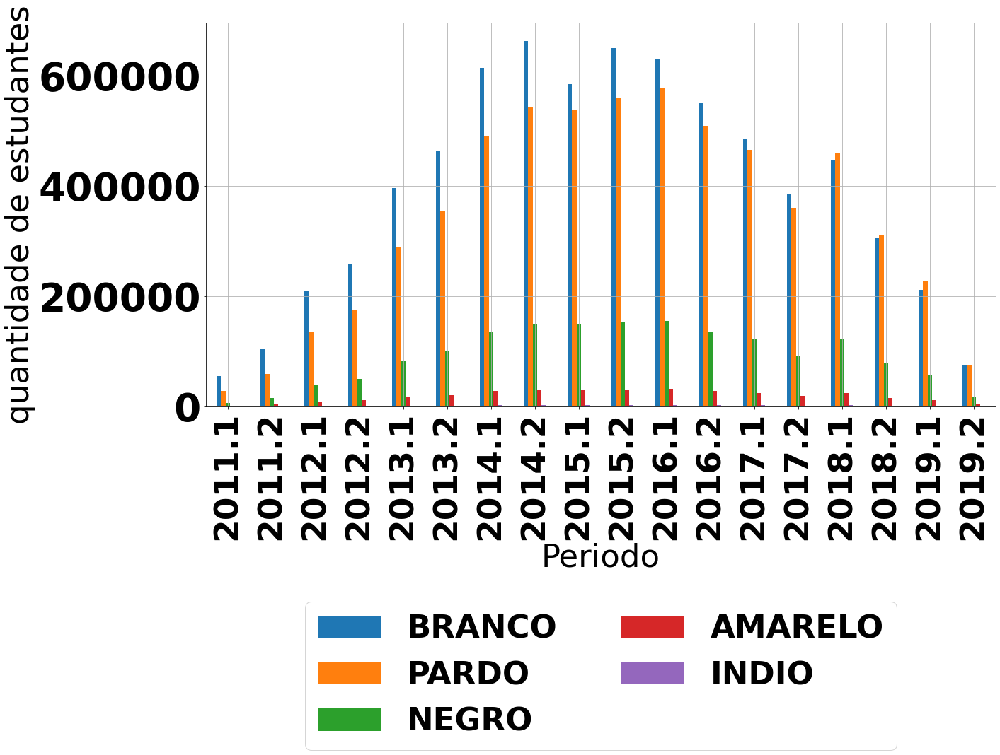

In [ ]:
graficoPorRacaVsPeriodo = dfPorRacaPorSemestre.plot.bar(grid=True, figsize= (20,10),
xlabel ="Raça" ,ylabel= "quantidade de estudantes", logy=True).legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

graficoPorPeriodoVsPorRaca = dfPorRacaPorSemestreTransposta.plot.bar(grid=True, figsize= (20,10),
xlabel ="Periodo" ,ylabel= "quantidade de estudantes").legend(loc='center',ncol=2,bbox_to_anchor=(0.5, -0.7));

In [ ]:
dfPorRacaPorcentagemCrescimento = dfPorRacaPorSemestre[['2011.1','2011.2',
'2012.1','2012.2','2013.1','2013.2','2014.1','2014.2','2015.1','2015.2','2016.1','2016.2','2017.1','2017.2',
'2018.1','2018.2','2019.1','2019.2']].pct_change(periods = 1, axis = 1)
dfPorRacaPorcentagemCrescimento

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
Raça,,,,,,,,,,,,,,,,,,
BRANCO,NaN,0.8996608202,0.9959134569,0.2325535783,0.5371099890,0.1725654667,0.3245719060,0.0794296955,-0.1195825702,0.1124965573,-0.0286961563,-0.1266707722,-0.1194877233,-0.2070350538,0.1585621044,-0.3155958122,-0.3044032035,-0.6418461249
PARDO,NaN,1.1255460454,1.2607896540,0.3027064580,0.6357338992,0.2283982089,0.3842839516,0.1109007987,-0.0130818437,0.0413898568,0.0314021269,-0.1173155232,-0.0850697681,-0.2266376988,0.2793663735,-0.3271273367,-0.2622618108,-0.6732691426
NEGRO,NaN,1.1804745763,1.3842422735,0.3201011972,0.6427075513,0.2189574714,0.3485678201,0.1028417571,-0.0135472229,0.0245813437,0.0200137845,-0.1328107906,-0.0873578913,-0.2480485266,0.3298946777,-0.3645618200,-0.2634037108,-0.6949535308
AMARELO,NaN,1.0735502122,1.0634379263,0.2664462810,0.5285826155,0.2204007286,0.3300373134,0.1091317155,-0.0451814848,0.0466902878,0.0096175140,-0.1225519381,-0.1027426612,-0.2257512438,0.2445381175,-0.3302354399,-0.2744989208,-0.6781706902
INDIO,NaN,1.3910256410,1.2627345845,0.2879146919,0.5473781049,0.2449464923,0.3538681948,0.1111111111,-0.0438095238,0.0076361222,0.0046128501,-0.1554608068,-0.0811650485,-0.2396449704,0.3285158421,-0.3736401674,-0.2651970608,-0.6954545455


In [ ]:
dfPorRacaPorcentagemCrescimentoTransposta = dfPorRacaPorcentagemCrescimento.T
dfPorRacaPorcentagemCrescimentoTransposta

Raça,BRANCO,PARDO,NEGRO,AMARELO,INDIO
2011.1,NaN,NaN,NaN,NaN,NaN
2011.2,0.8996608202,1.1255460454,1.1804745763,1.0735502122,1.3910256410
2012.1,0.9959134569,1.2607896540,1.3842422735,1.0634379263,1.2627345845
2012.2,0.2325535783,0.3027064580,0.3201011972,0.2664462810,0.2879146919
2013.1,0.5371099890,0.6357338992,0.6427075513,0.5285826155,0.5473781049
2013.2,0.1725654667,0.2283982089,0.2189574714,0.2204007286,0.2449464923
2014.1,0.3245719060,0.3842839516,0.3485678201,0.3300373134,0.3538681948
2014.2,0.0794296955,0.1109007987,0.1028417571,0.1091317155,0.1111111111
2015.1,-0.1195825702,-0.0130818437,-0.0135472229,-0.0451814848,-0.0438095238
2015.2,0.1124965573,0.0413898568,0.0245813437,0.0466902878,0.0076361222


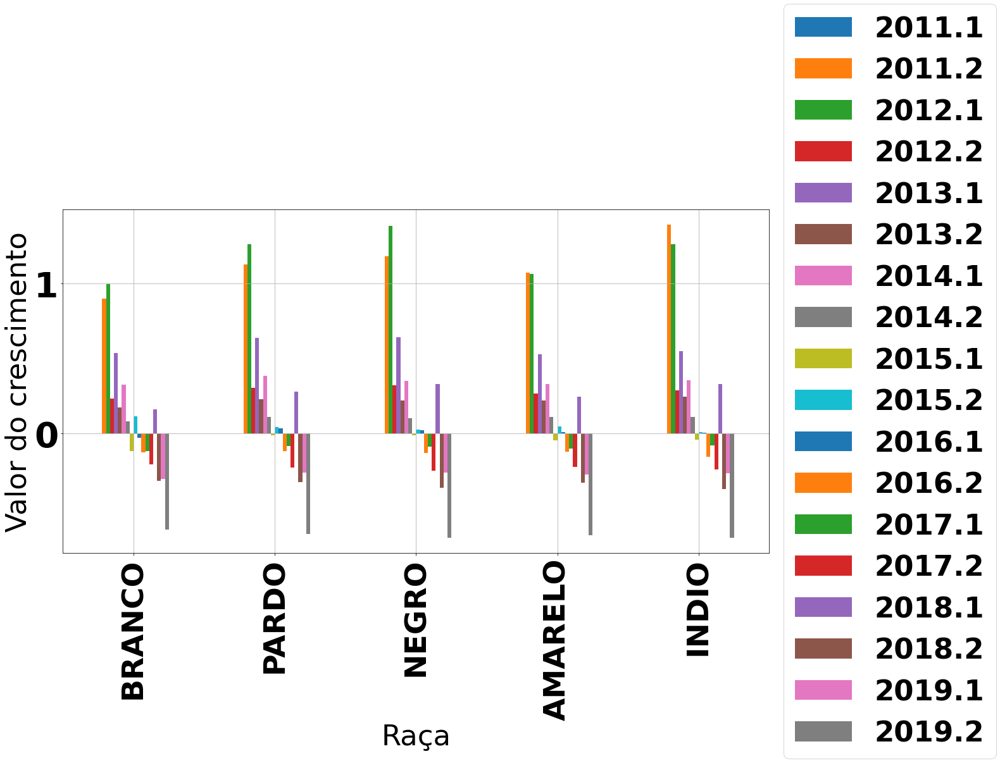

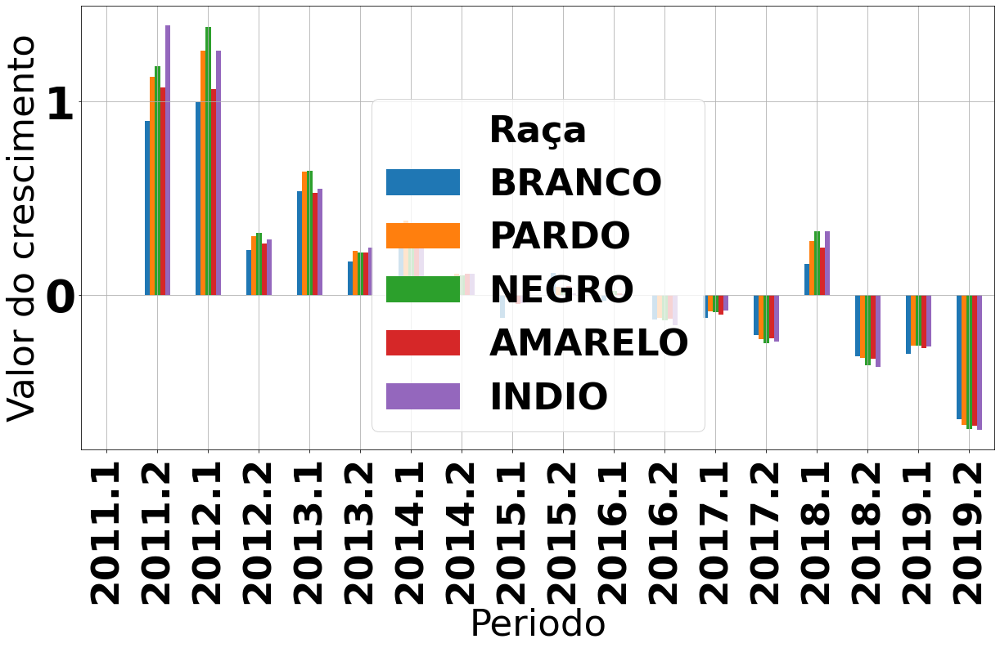

In [ ]:
graficoPorRacaVsPeriodoCrescimento = dfPorRacaPorcentagemCrescimento.plot.bar( grid=True, figsize= (20,10),
xlabel ="Raça" ,ylabel= "Valor do crescimento").legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

graficoPorPeriodoVsPorRacaCrescimento = dfPorRacaPorcentagemCrescimentoTransposta.plot.bar(
grid=True, figsize= (20,10), xlabel ="Periodo" ,ylabel= "Valor do crescimento" )

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f40652121c0>,
      dtype=object)

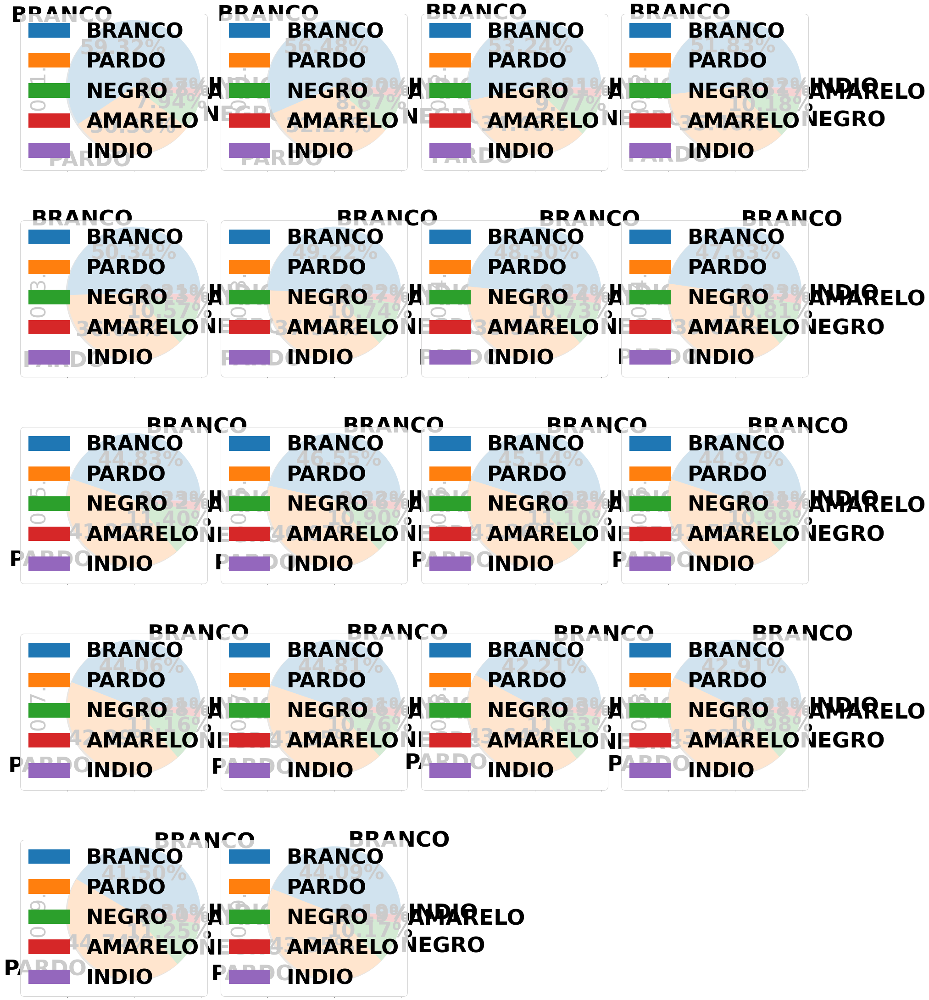

In [ ]:
dfPorRacaPorSemestre.plot.pie(subplots=True, layout=(5,4), figsize=(30,40), shadow=True, autopct='%1.2f%%')

##Por sexo

In [ ]:
dataPorSexo = {'SEXO': ['MASCULINO', 'FEMININO'],
         '2011.1': [38705, 54237],
         '2011.2': [77482, 107953],
         '2012.1': [162974, 229632],
         '2012.2': [203671, 293440],
         '2013.1': [319652, 467104],
         '2013.2': [383272, 560168],
         '2014.1': [516074, 757339],
         '2014.2': [562968, 831158],
         '2015.1': [522422, 781571],
         '2015.2': [557950, 839141],
         '2016.1': [556002, 843372],
         '2016.2': [480979, 745626],
         '2017.1': [435707, 666771],
         '2017.2': [335431, 524064],
         '2018.1': [411556, 645606],
         '2018.2': [275825, 435866],
         '2019.1': [199064, 312815],
         '2019.2': [64220, 108372],
         }

In [ ]:
dfPorSexoPorSemestre = pd.DataFrame(dataPorSexo)
dfPorSexoPorSemestre.set_index('SEXO', inplace=True)
dfPorSexoPorSemestre

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
SEXO,,,,,,,,,,,,,,,,,,
MASCULINO,38705,77482,162974,203671,319652,383272,516074,562968,522422,557950,556002,480979,435707,335431,411556,275825,199064,64220
FEMININO,54237,107953,229632,293440,467104,560168,757339,831158,781571,839141,843372,745626,666771,524064,645606,435866,312815,108372


In [ ]:
dfPorSexoPorSemestreTransposta = dfPorSexoPorSemestre.T
dfPorSexoPorSemestreTransposta

SEXO,MASCULINO,FEMININO
2011.1,38705,54237
2011.2,77482,107953
2012.1,162974,229632
2012.2,203671,293440
2013.1,319652,467104
2013.2,383272,560168
2014.1,516074,757339
2014.2,562968,831158
2015.1,522422,781571
2015.2,557950,839141


In [ ]:
totaisPorSexoPorSemestre = dfPorSexoPorSemestre.sum(0, numeric_only=True)
totaisPorSexoPorSemestre


2011.1      92942
2011.2     185435
2012.1     392606
2012.2     497111
2013.1     786756
2013.2     943440
2014.1    1273413
2014.2    1394126
2015.1    1303993
2015.2    1397091
2016.1    1399374
2016.2    1226605
2017.1    1102478
2017.2     859495
2018.1    1057162
2018.2     711691
2019.1     511879
2019.2     172592
dtype: int64

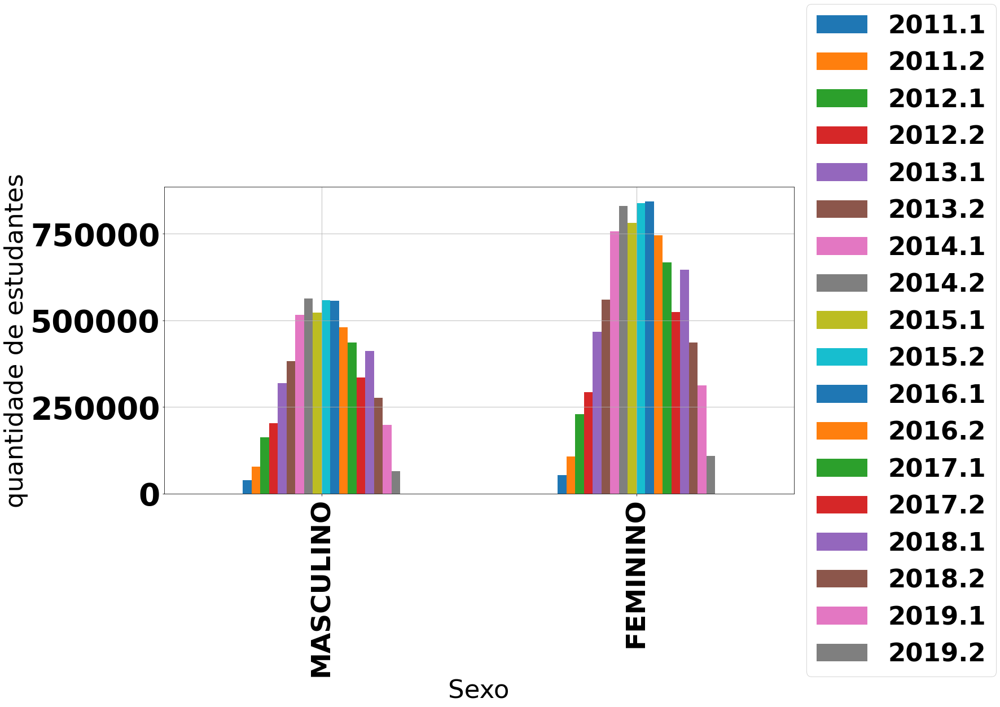

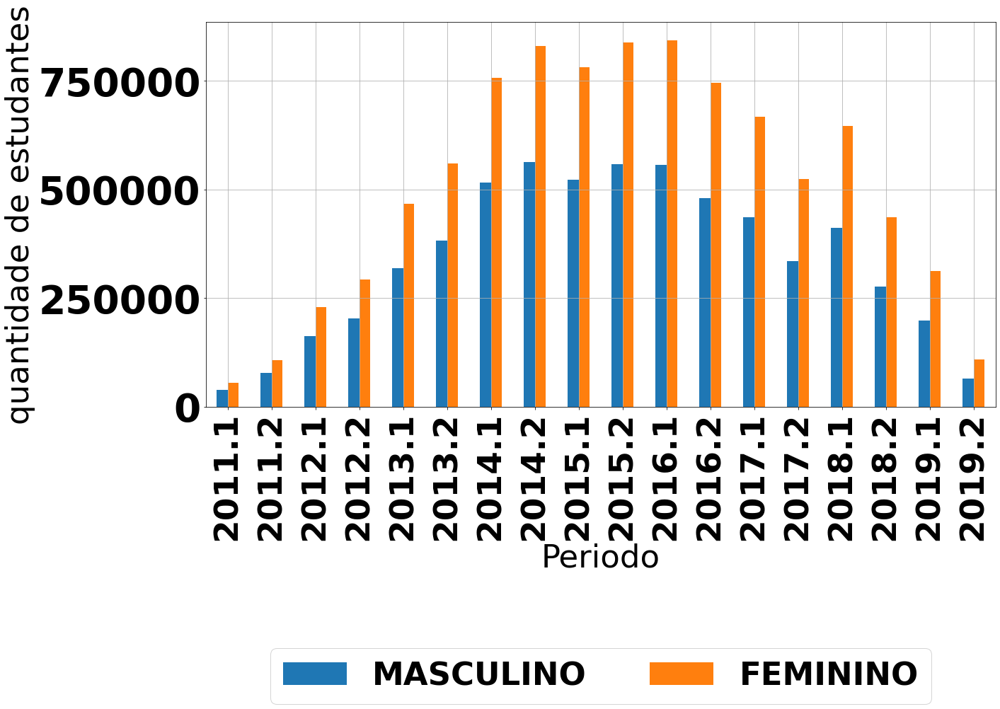

In [ ]:
graficoPorSexoVsPeriodo = dfPorSexoPorSemestre.plot.bar(grid=True, figsize= (20,10),
xlabel ="Sexo" ,ylabel= "quantidade de estudantes").legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

graficoPorPeriodoVsPorSexo = dfPorSexoPorSemestreTransposta.plot.bar( grid=True, figsize= (20,10),
xlabel ="Periodo" ,ylabel= "quantidade de estudantes").legend(loc='center',ncol=2,bbox_to_anchor=(0.5, -0.7));

In [ ]:
dfPorSexoPorcentagemCrescimento = dfPorSexoPorSemestre[['2011.1','2011.2',
'2012.1','2012.2','2013.1','2013.2','2014.1','2014.2','2015.1','2015.2','2016.1','2016.2','2017.1','2017.2',
'2018.1','2018.2','2019.1','2019.2']].pct_change(periods = 1, axis = 1)
dfPorSexoPorcentagemCrescimento

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
SEXO,,,,,,,,,,,,,,,,,,
MASCULINO,NaN,1.0018602248,1.1033788493,0.2497146784,0.5694526958,0.1990289440,0.3464954393,0.0908668137,-0.0720218556,0.0680063244,-0.0034913523,-0.1349329679,-0.0941246915,-0.2301454877,0.2269468236,-0.3297995898,-0.2782960210,-0.6773901861
FEMININO,NaN,0.9903940115,1.1271479255,0.2778706800,0.5918211559,0.1992361444,0.3519854758,0.0974715418,-0.0596601368,0.0736593349,0.0050420609,-0.1158990339,-0.1057567735,-0.2140270048,0.2319220553,-0.3248730650,-0.2823138304,-0.6535588127


In [ ]:
dfPorSexoPorcentagemCrescimentoTransposta = dfPorSexoPorcentagemCrescimento.T
dfPorSexoPorcentagemCrescimentoTransposta

SEXO,MASCULINO,FEMININO
2011.1,NaN,NaN
2011.2,1.0018602248,0.9903940115
2012.1,1.1033788493,1.1271479255
2012.2,0.2497146784,0.2778706800
2013.1,0.5694526958,0.5918211559
2013.2,0.1990289440,0.1992361444
2014.1,0.3464954393,0.3519854758
2014.2,0.0908668137,0.0974715418
2015.1,-0.0720218556,-0.0596601368
2015.2,0.0680063244,0.0736593349


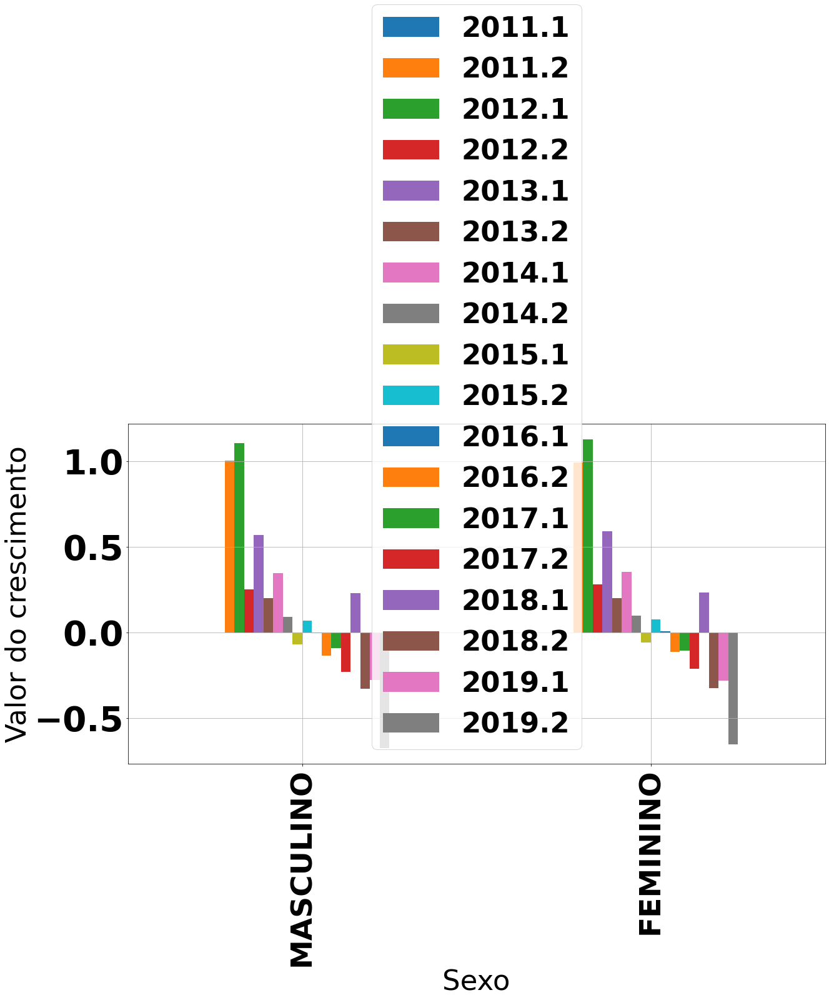

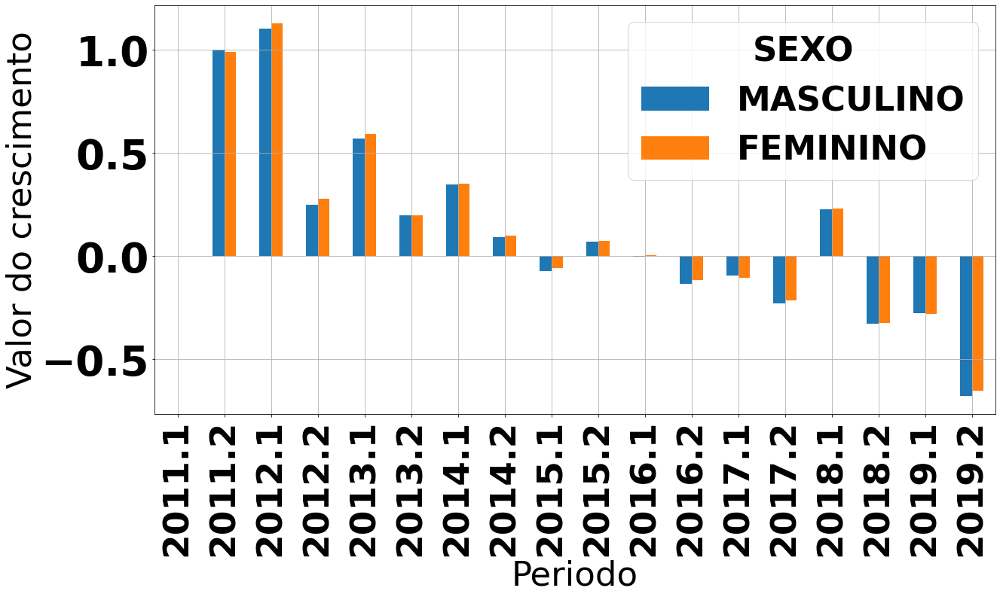

In [ ]:
graficoPorSexoVsPeriodoCrescimento = dfPorSexoPorcentagemCrescimento.plot.bar(grid=True, figsize= (20,10),
xlabel ="Sexo" ,ylabel= "Valor do crescimento")

graficoPorPeriodoVsPorSexoCrescimento = dfPorSexoPorcentagemCrescimentoTransposta.plot.bar( 
grid=True, figsize= (20,10), xlabel ="Periodo" ,ylabel= "Valor do crescimento" )

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f4065166430>,
      dtype=object)

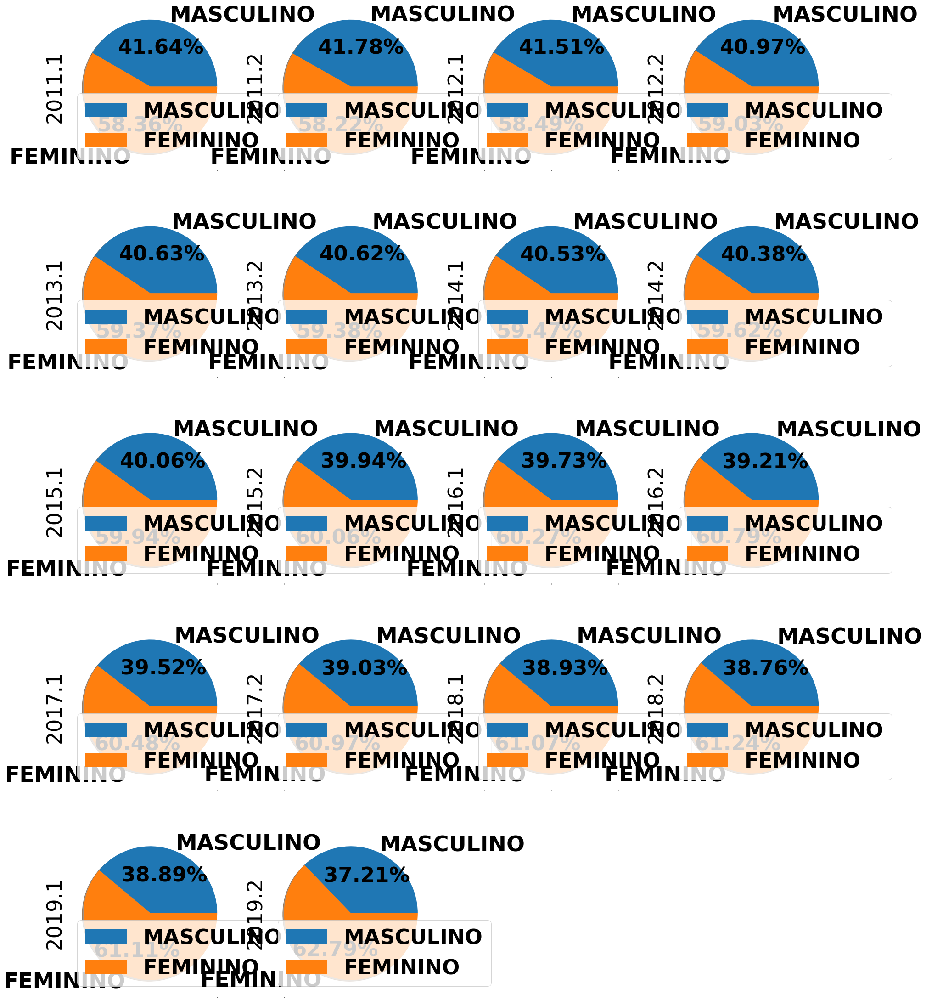

In [ ]:
dfPorSexoPorSemestre.plot.pie(subplots=True, layout=(5,4), figsize=(30,40), shadow=True, autopct='%1.2f%%')

##Por presença de deficiência

In [ ]:
dataPorPresencaDeDeficiencia = {'Possui alguma forma de deficiência': ['SIM', 'NÃO'],
         '2011.1': [541, 92401],
         '2011.2': [1027, 184408],
         '2012.1': [2254, 390352],
         '2012.2': [2789, 494322],
         '2013.1': [4366, 782390],
         '2013.2': [5484, 937956],
         '2014.1': [7671, 1265742],
         '2014.2': [8182, 1385944],
         '2015.1': [7459, 1296534],
         '2015.2': [7870, 1389221],
         '2016.1': [7688, 1391686],
         '2016.2': [6535, 1220070],
         '2017.1': [5978, 1096500],
         '2017.2': [4494, 855001],
         '2018.1': [5473, 1051689],
         '2018.2': [3558, 708133],
         '2019.1': [2564, 509315],
         '2019.2': [859, 171733],
         }

In [ ]:
dfPorPresencaDeDeficienciaPorSemestre = pd.DataFrame(dataPorPresencaDeDeficiencia)
dfPorPresencaDeDeficienciaPorSemestre.set_index('Possui alguma forma de deficiência', inplace=True)
dfPorPresencaDeDeficienciaPorSemestre

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
Possui alguma forma de deficiência,,,,,,,,,,,,,,,,,,
SIM,541,1027,2254,2789,4366,5484,7671,8182,7459,7870,7688,6535,5978,4494,5473,3558,2564,859
NÃO,92401,184408,390352,494322,782390,937956,1265742,1385944,1296534,1389221,1391686,1220070,1096500,855001,1051689,708133,509315,171733


In [ ]:
dfPorPresencaDeDeficienciaPorSemestreTransposta = dfPorPresencaDeDeficienciaPorSemestre.T
dfPorPresencaDeDeficienciaPorSemestreTransposta

Possui alguma forma de deficiência,SIM,NÃO
2011.1,541,92401
2011.2,1027,184408
2012.1,2254,390352
2012.2,2789,494322
2013.1,4366,782390
2013.2,5484,937956
2014.1,7671,1265742
2014.2,8182,1385944
2015.1,7459,1296534
2015.2,7870,1389221


In [ ]:
totaisPorPresencaDeDeficienciaPorSemestre = dfPorPresencaDeDeficienciaPorSemestre.sum(0, numeric_only=True)
totaisPorPresencaDeDeficienciaPorSemestre

2011.1      92942
2011.2     185435
2012.1     392606
2012.2     497111
2013.1     786756
2013.2     943440
2014.1    1273413
2014.2    1394126
2015.1    1303993
2015.2    1397091
2016.1    1399374
2016.2    1226605
2017.1    1102478
2017.2     859495
2018.1    1057162
2018.2     711691
2019.1     511879
2019.2     172592
dtype: int64

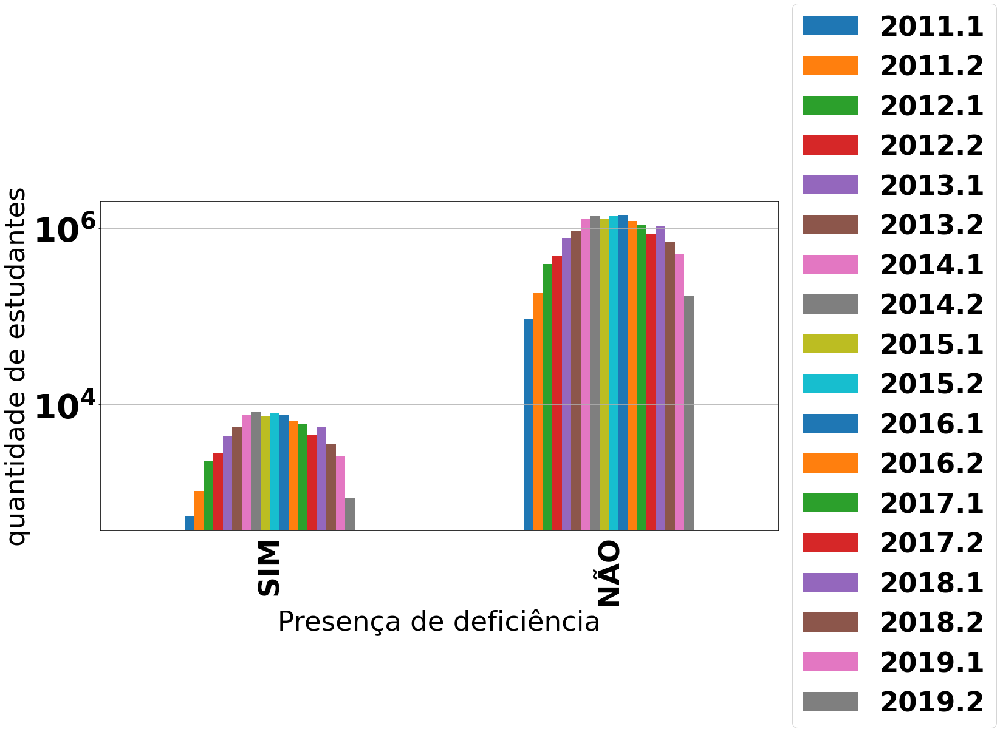

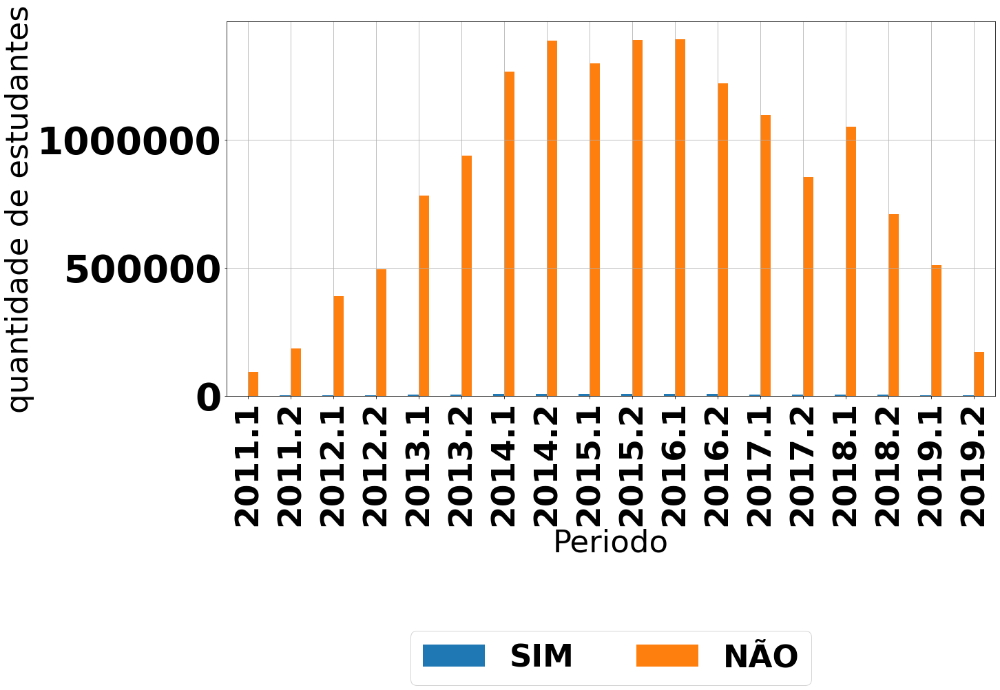

In [ ]:
graficoPorPresencaDeDeficienciaVsPeriodo = dfPorPresencaDeDeficienciaPorSemestre.plot.bar( grid=True, figsize= (20,10),
xlabel ="Presença de deficiência" ,ylabel= "quantidade de estudantes", 
logy=True).legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

graficoPorPeriodoVsPorPresencaDeDeficiencia = dfPorPresencaDeDeficienciaPorSemestreTransposta.plot.bar( grid=True, figsize= (20,10),
xlabel ="Periodo" ,ylabel= "quantidade de estudantes").legend(loc='center',ncol=2,bbox_to_anchor=(0.5, -0.7));

In [ ]:
dfPorPresencaDeDeficienciaPorcentagemCrescimento = dfPorPresencaDeDeficienciaPorSemestre[['2011.1','2011.2',
'2012.1','2012.2','2013.1','2013.2','2014.1','2014.2','2015.1','2015.2','2016.1','2016.2','2017.1','2017.2',
'2018.1','2018.2','2019.1','2019.2']].pct_change(periods = 1, axis = 1)
dfPorPresencaDeDeficienciaPorcentagemCrescimento

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
Possui alguma forma de deficiência,,,,,,,,,,,,,,,,,,
SIM,NaN,0.8983364140,1.1947419669,0.2373558119,0.5654356400,0.2560696290,0.3987964989,0.0666145222,-0.0883647030,0.0551012200,-0.0231257942,-0.1499739854,-0.0852333588,-0.2482435597,0.2178460169,-0.3498995067,-0.2793704328,-0.6649765991
NÃO,NaN,0.9957359769,1.1167845213,0.2663493462,0.5827537516,0.1988343409,0.3494684186,0.0949656407,-0.0645119861,0.0714882911,0.0017743757,-0.1233151731,-0.1012810740,-0.2202453260,0.2300441754,-0.3266707173,-0.2807636419,-0.6628157427


In [ ]:
dfPorPresencaDeDeficienciaPorcentagemCrescimentoTransposta = dfPorPresencaDeDeficienciaPorcentagemCrescimento.T
dfPorPresencaDeDeficienciaPorcentagemCrescimentoTransposta

Possui alguma forma de deficiência,SIM,NÃO
2011.1,NaN,NaN
2011.2,0.8983364140,0.9957359769
2012.1,1.1947419669,1.1167845213
2012.2,0.2373558119,0.2663493462
2013.1,0.5654356400,0.5827537516
2013.2,0.2560696290,0.1988343409
2014.1,0.3987964989,0.3494684186
2014.2,0.0666145222,0.0949656407
2015.1,-0.0883647030,-0.0645119861
2015.2,0.0551012200,0.0714882911


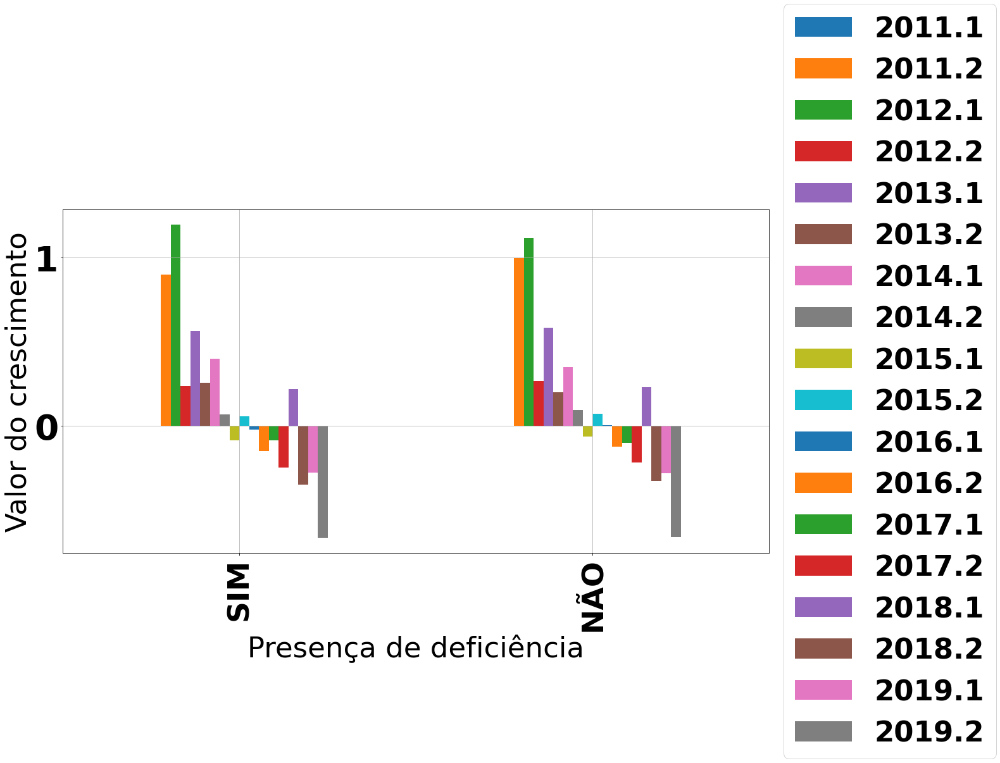

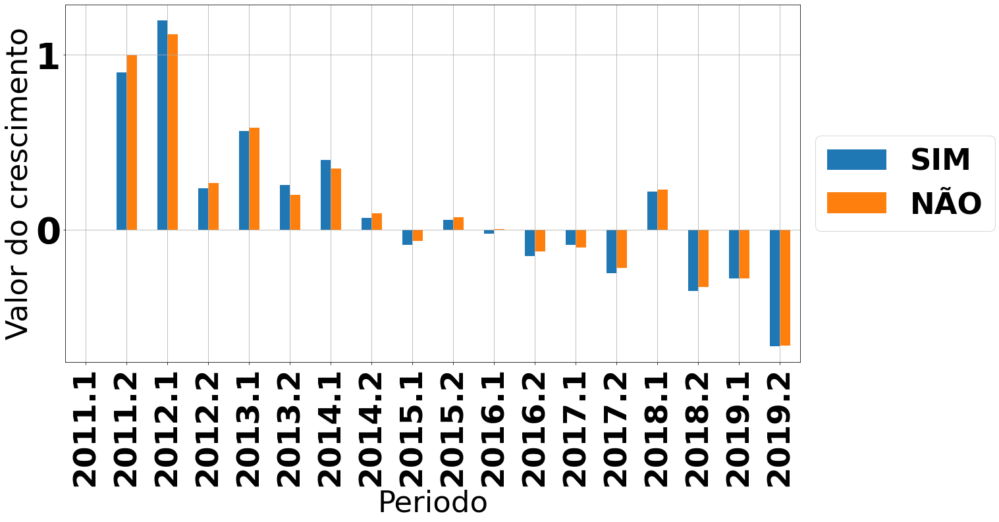

In [ ]:
graficoPorPresencaDeDeficienciaVsPeriodoCrescimento = dfPorPresencaDeDeficienciaPorcentagemCrescimento.plot.bar( grid=True, figsize= (20,10),
xlabel ="Presença de deficiência" ,ylabel= "Valor do crescimento").legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

graficoPorPeriodoVsPorPresencaDeDeficienciaCrescimento = dfPorPresencaDeDeficienciaPorcentagemCrescimentoTransposta.plot.bar( 
grid=True, figsize= (20,10), xlabel ="Periodo" ,ylabel= "Valor do crescimento" ).legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f40545365b0>,
      dtype=object)

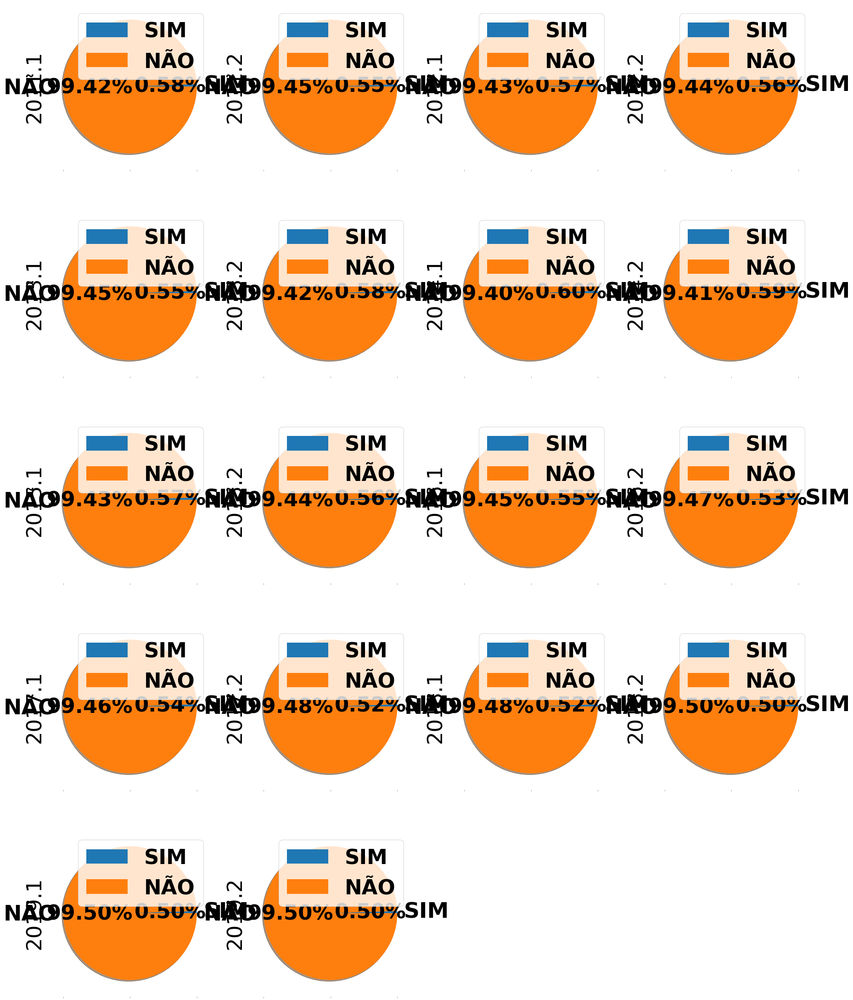

In [ ]:
dfPorPresencaDeDeficienciaPorSemestre.plot.pie(subplots=True, layout=(5,4), figsize=(30,40), shadow=True, autopct='%1.2f%%')

##Por estado civil

In [ ]:
dataPorEstadoCivil = {'Estado civil': ['SOLTEIRO', 'CASADO', 'UNIAO ESTAVEL', 'DIVORCIADO', 'SEPARADO', 'VIUVO'],
         '2011.1': [77736, 10478, 2281, 1389, 948, 110],
         '2011.2': [150117, 24111, 5207, 3528, 2199, 273],
         '2012.1': [311079, 56064, 11768, 8468, 4547, 680],
         '2012.2': [390710, 74185, 14573, 11309, 5425, 909],
         '2013.1': [621108, 116195, 21760, 18489, 7743, 1461],
         '2013.2': [742165, 141031, 26299, 23229, 9017, 1699],
         '2014.1': [1011709, 184119, 34256, 30311, 10813, 2205],
         '2014.2': [1107917, 201064, 37475, 33658, 11600, 2412],
         '2015.1': [1033059, 191222, 35210, 31802, 10418, 2282],
         '2015.2': [1118569, 195619, 37480, 32431, 10688, 2304],
         '2016.1': [1136723, 183521, 37293, 30097, 9615, 2125],
         '2016.2': [1005834, 154216, 31559, 25621, 7643, 1732],
         '2017.1': [908619, 135369, 28061, 22246, 6690, 1493],
         '2017.2': [709429, 104990, 21629, 17208, 5128, 1111],
         '2018.1': [874221, 127507, 26529, 21139, 6286, 1480],
         '2018.2': [601908, 76319, 17109, 12188, 3418, 749],
         '2019.1': [437028, 51715, 12168, 8153, 2305, 510],
         '2019.2': [148958, 16294, 3854, 2667, 669, 150],
         }

In [ ]:
dfPorEstadoCivilPorSemestre = pd.DataFrame(dataPorEstadoCivil)
dfPorEstadoCivilPorSemestre.set_index('Estado civil', inplace=True)
dfPorEstadoCivilPorSemestre

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
Estado civil,,,,,,,,,,,,,,,,,,
SOLTEIRO,77736,150117,311079,390710,621108,742165,1011709,1107917,1033059,1118569,1136723,1005834,908619,709429,874221,601908,437028,148958
CASADO,10478,24111,56064,74185,116195,141031,184119,201064,191222,195619,183521,154216,135369,104990,127507,76319,51715,16294
UNIAO ESTAVEL,2281,5207,11768,14573,21760,26299,34256,37475,35210,37480,37293,31559,28061,21629,26529,17109,12168,3854
DIVORCIADO,1389,3528,8468,11309,18489,23229,30311,33658,31802,32431,30097,25621,22246,17208,21139,12188,8153,2667
SEPARADO,948,2199,4547,5425,7743,9017,10813,11600,10418,10688,9615,7643,6690,5128,6286,3418,2305,669
VIUVO,110,273,680,909,1461,1699,2205,2412,2282,2304,2125,1732,1493,1111,1480,749,510,150


In [ ]:
dfPorEstadoCivilPorSemestreTransposta = dfPorEstadoCivilPorSemestre.T
dfPorEstadoCivilPorSemestreTransposta

Estado civil,SOLTEIRO,CASADO,UNIAO ESTAVEL,DIVORCIADO,SEPARADO,VIUVO
2011.1,77736,10478,2281,1389,948,110
2011.2,150117,24111,5207,3528,2199,273
2012.1,311079,56064,11768,8468,4547,680
2012.2,390710,74185,14573,11309,5425,909
2013.1,621108,116195,21760,18489,7743,1461
2013.2,742165,141031,26299,23229,9017,1699
2014.1,1011709,184119,34256,30311,10813,2205
2014.2,1107917,201064,37475,33658,11600,2412
2015.1,1033059,191222,35210,31802,10418,2282
2015.2,1118569,195619,37480,32431,10688,2304


In [ ]:
totaisPorEstadoCivilPorSemestre = dfPorEstadoCivilPorSemestre.sum(0, numeric_only=True)
totaisPorEstadoCivilPorSemestre

2011.1      92942
2011.2     185435
2012.1     392606
2012.2     497111
2013.1     786756
2013.2     943440
2014.1    1273413
2014.2    1394126
2015.1    1303993
2015.2    1397091
2016.1    1399374
2016.2    1226605
2017.1    1102478
2017.2     859495
2018.1    1057162
2018.2     711691
2019.1     511879
2019.2     172592
dtype: int64

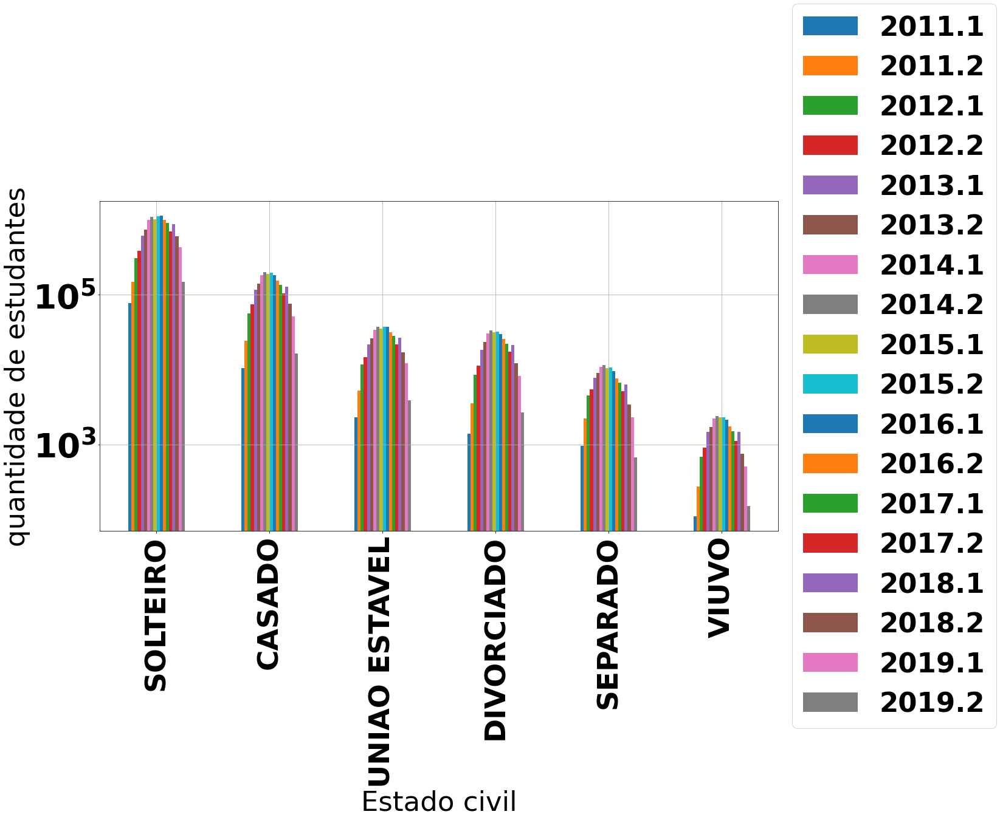

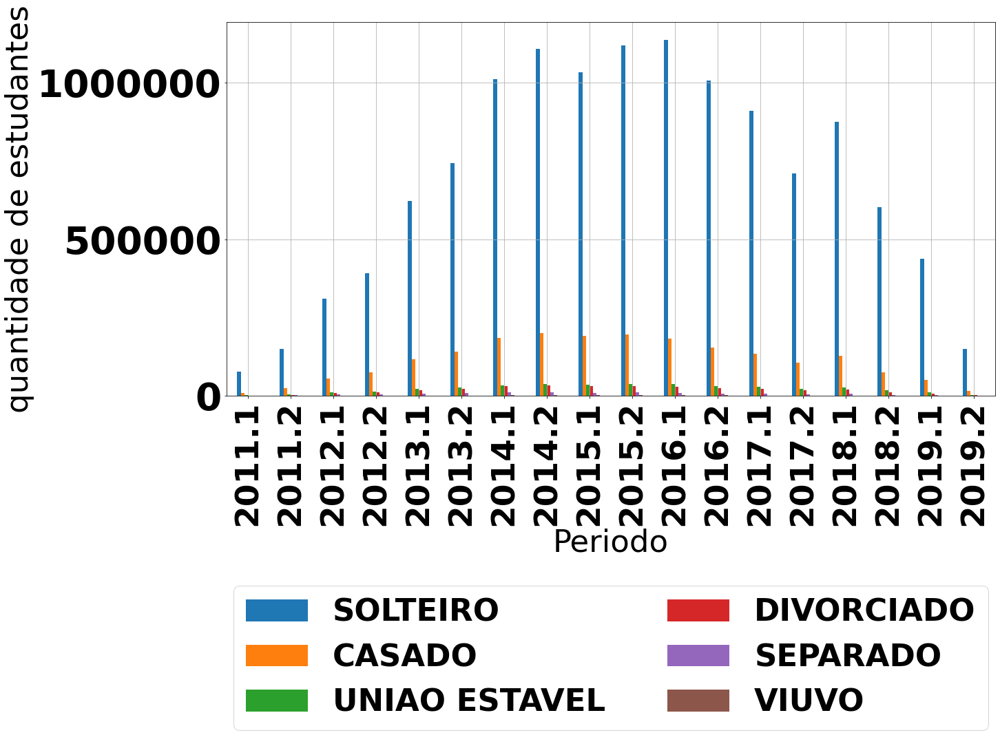

In [ ]:
graficoPorEstadoCivilVsPeriodo = dfPorEstadoCivilPorSemestre.plot.bar( grid=True, figsize= (20,10),
xlabel ="Estado civil" ,ylabel= "quantidade de estudantes", logy=True).legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

graficoPorPeriodoVsPorEstadoCivil = dfPorEstadoCivilPorSemestreTransposta.plot.bar( grid=True, figsize= (20,10),
xlabel ="Periodo" ,ylabel= "quantidade de estudantes").legend(loc='center',ncol=2,bbox_to_anchor=(0.5, -0.7));

In [ ]:
dfPorEstadoCivilPorcentagemCrescimento = dfPorEstadoCivilPorSemestre[['2011.1','2011.2',
'2012.1','2012.2','2013.1','2013.2','2014.1','2014.2','2015.1','2015.2','2016.1','2016.2','2017.1','2017.2',
'2018.1','2018.2','2019.1','2019.2']].pct_change(periods = 1, axis = 1)
dfPorEstadoCivilPorcentagemCrescimento

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
Estado civil,,,,,,,,,,,,,,,,,,
SOLTEIRO,NaN,0.9311129978,1.0722436500,0.2559832068,0.5896905633,0.1949049119,0.3631860840,0.0950945381,-0.0675664332,0.0827735880,0.0162296649,-0.1151459063,-0.0966511373,-0.2192227986,0.2322882205,-0.3114921742,-0.2739289061,-0.6591568504
CASADO,NaN,1.3011070815,1.3252457385,0.3232198916,0.5662869852,0.2137441370,0.3055214811,0.0920328700,-0.0489495882,0.0229942161,-0.0618447083,-0.1596819982,-0.1222117031,-0.2244162253,0.2144680446,-0.4014524693,-0.3223836790,-0.6849270038
UNIAO ESTAVEL,NaN,1.2827707146,1.2600345688,0.2383582597,0.4931723049,0.2085937500,0.3025590327,0.0939689397,-0.0604402935,0.0644703209,-0.0049893276,-0.1537553965,-0.1108400139,-0.2292149246,0.2265476906,-0.3550831166,-0.2887953709,-0.6832675871
DIVORCIADO,NaN,1.5399568035,1.4002267574,0.3354983467,0.6348925634,0.2563686516,0.3048775238,0.1104219590,-0.0551429081,0.0197786303,-0.0719681786,-0.1487191414,-0.1317278795,-0.2264676796,0.2284402603,-0.4234353565,-0.3310633410,-0.6728811480
SEPARADO,NaN,1.3196202532,1.0677580719,0.1930943479,0.4272811060,0.1645357097,0.1991793279,0.0727827615,-0.1018965517,0.0259166827,-0.1003929641,-0.2050962038,-0.1246892581,-0.2334828102,0.2258190328,-0.4562519885,-0.3256290228,-0.7097613883
VIUVO,NaN,1.4818181818,1.4908424908,0.3367647059,0.6072607261,0.1629021218,0.2978222484,0.0938775510,-0.0538971808,0.0096406661,-0.0776909722,-0.1849411765,-0.1379907621,-0.2558606832,0.3321332133,-0.4939189189,-0.3190921228,-0.7058823529


In [ ]:
dfPorEstadoCivilPorcentagemCrescimentoTransposta = dfPorEstadoCivilPorcentagemCrescimento.T
dfPorEstadoCivilPorcentagemCrescimentoTransposta

Estado civil,SOLTEIRO,CASADO,UNIAO ESTAVEL,DIVORCIADO,SEPARADO,VIUVO
2011.1,NaN,NaN,NaN,NaN,NaN,NaN
2011.2,0.9311129978,1.3011070815,1.2827707146,1.5399568035,1.3196202532,1.4818181818
2012.1,1.0722436500,1.3252457385,1.2600345688,1.4002267574,1.0677580719,1.4908424908
2012.2,0.2559832068,0.3232198916,0.2383582597,0.3354983467,0.1930943479,0.3367647059
2013.1,0.5896905633,0.5662869852,0.4931723049,0.6348925634,0.4272811060,0.6072607261
2013.2,0.1949049119,0.2137441370,0.2085937500,0.2563686516,0.1645357097,0.1629021218
2014.1,0.3631860840,0.3055214811,0.3025590327,0.3048775238,0.1991793279,0.2978222484
2014.2,0.0950945381,0.0920328700,0.0939689397,0.1104219590,0.0727827615,0.0938775510
2015.1,-0.0675664332,-0.0489495882,-0.0604402935,-0.0551429081,-0.1018965517,-0.0538971808
2015.2,0.0827735880,0.0229942161,0.0644703209,0.0197786303,0.0259166827,0.0096406661


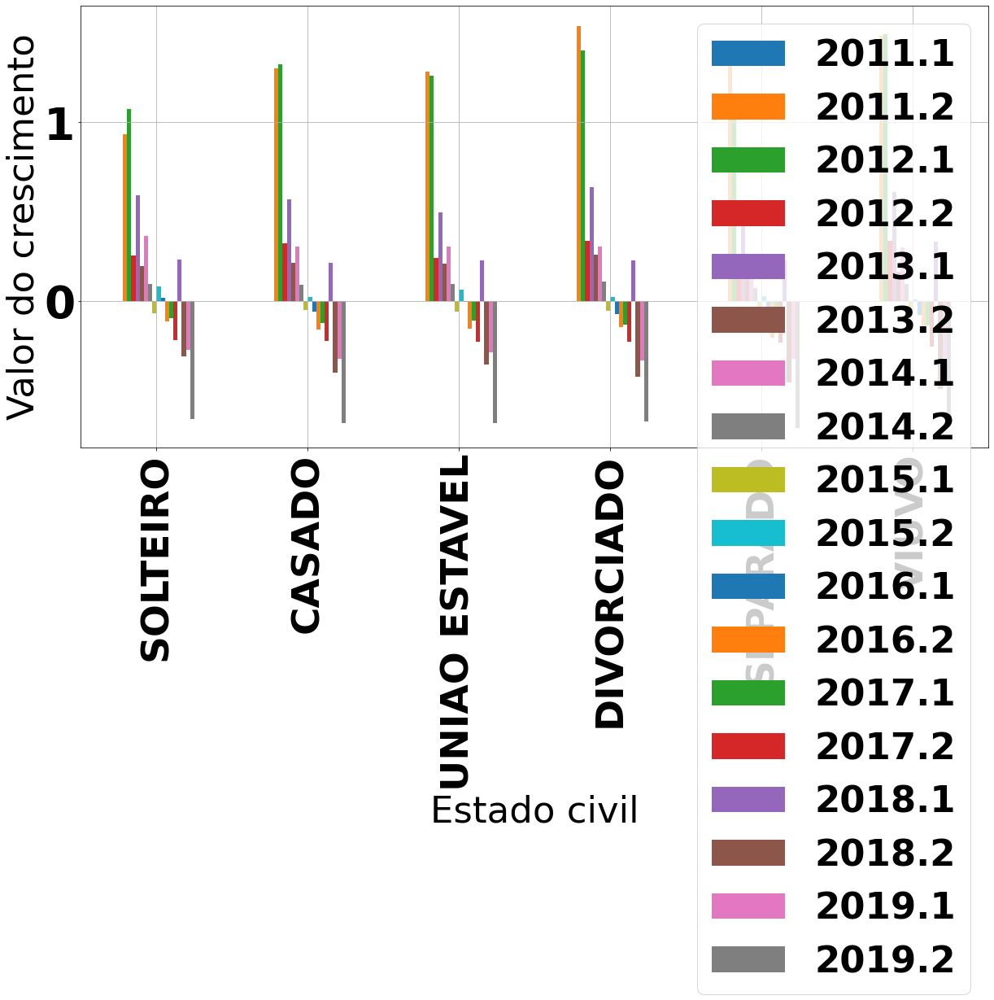

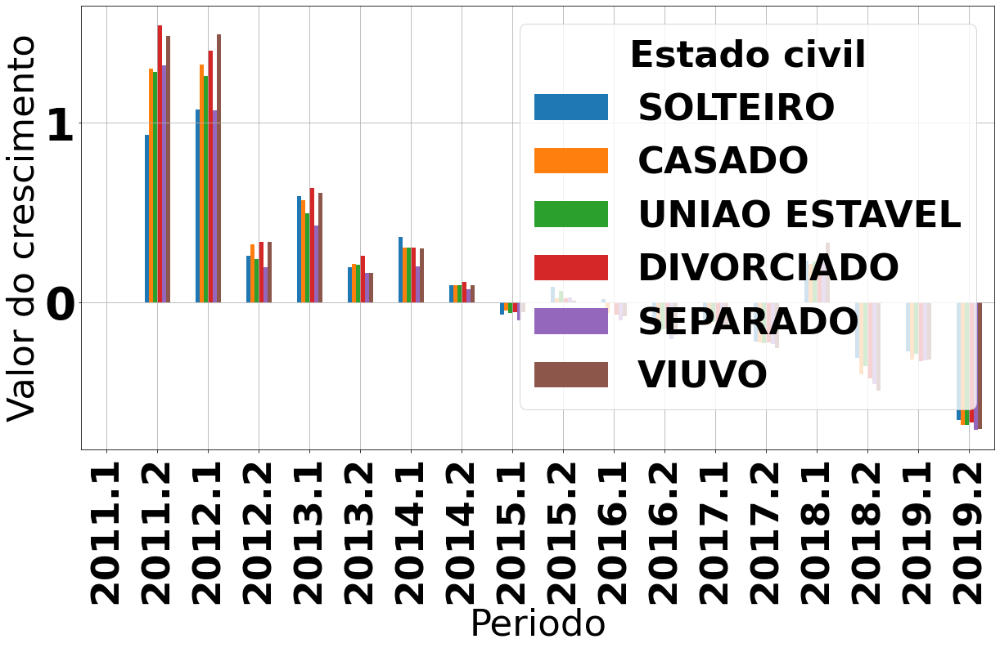

In [ ]:
graficoPorEstadoCivilVsPeriodoCrescimento = dfPorEstadoCivilPorcentagemCrescimento.plot.bar( grid=True, figsize= (20,10),
xlabel ="Estado civil" ,ylabel= "Valor do crescimento")

graficoPorPeriodoVsPorEstadoCivilCrescimento = dfPorEstadoCivilPorcentagemCrescimentoTransposta.plot.bar( 
grid=True, figsize= (20,10), xlabel ="Periodo" ,ylabel= "Valor do crescimento" )

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f40537d8a90>,
      dtype=object)

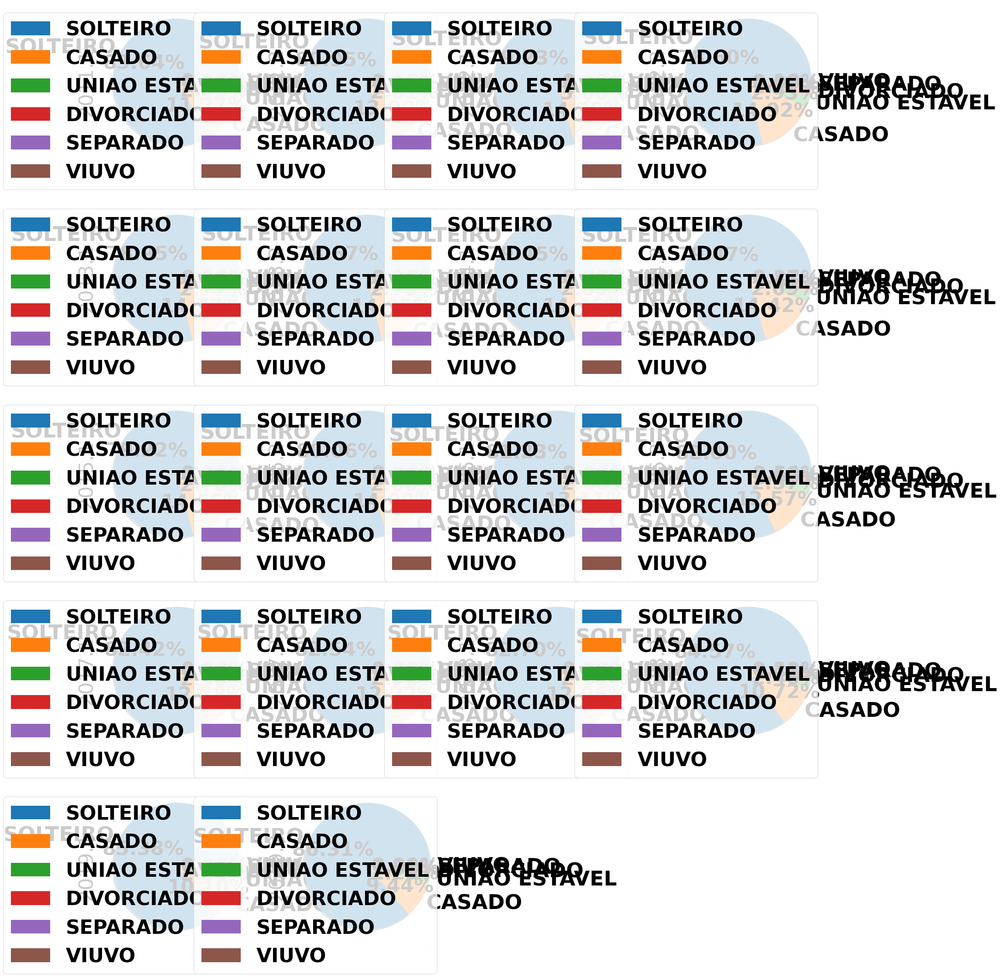

In [ ]:
dfPorEstadoCivilPorSemestre.plot.pie(subplots=True, layout=(5,4), figsize=(30,40), shadow=True, autopct='%1.2f%%')

#Grupo 2:

##Por região

In [ ]:
dataPorRegiaoPorSemestre = {'REGIAO': ['SUDESTE', 'SUL', 'NORDESTE', 'CENTRO-OESTE', 'NORTE'],
         '2011.1': [42511, 21097, 19298, 7784, 2252],
         '2011.2': [83866, 37078, 40578, 18300, 5613],
         '2012.1': [206107, 59851, 74285, 39471, 12892],
         '2012.2': [270147, 68014, 92379, 49418, 17153],
         '2013.1': [442645, 95702, 142440, 77395, 28574],
         '2013.2': [522380, 108796, 179716, 94183, 38365],
         '2014.1': [701060, 145778, 243051, 126172, 57352],
         '2014.2': [756344, 158152, 271201, 140131, 68298],
         '2015.1': [709233, 111245, 278675, 135180, 69660],
         '2015.2': [747827, 154211, 285052, 138391, 71610],
         '2016.1': [723486, 150112, 308543, 138215, 79018],
         '2016.2': [621921, 133663, 278820, 120696, 71505],
         '2017.1': [550009, 117311, 259609, 108897, 66652],
         '2017.2': [428950, 94082, 199964, 86137, 50362],
         '2018.1': [541059, 98021, 259620, 94226, 64236],
         '2018.2': [334753, 83767, 184038, 64307, 44826],
         '2019.1': [233612, 57700, 148423, 42104, 30040],
         '2019.2': [72683, 24053, 48961, 16062, 10833],
         }

In [ ]:
dfPorRegiaoPorSemestre = pd.DataFrame(dataPorRegiaoPorSemestre)
dfPorRegiaoPorSemestre.set_index('REGIAO', inplace=True)
dfPorRegiaoPorSemestre

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
REGIAO,,,,,,,,,,,,,,,,,,
SUDESTE,42511,83866,206107,270147,442645,522380,701060,756344,709233,747827,723486,621921,550009,428950,541059,334753,233612,72683
SUL,21097,37078,59851,68014,95702,108796,145778,158152,111245,154211,150112,133663,117311,94082,98021,83767,57700,24053
NORDESTE,19298,40578,74285,92379,142440,179716,243051,271201,278675,285052,308543,278820,259609,199964,259620,184038,148423,48961
CENTRO-OESTE,7784,18300,39471,49418,77395,94183,126172,140131,135180,138391,138215,120696,108897,86137,94226,64307,42104,16062
NORTE,2252,5613,12892,17153,28574,38365,57352,68298,69660,71610,79018,71505,66652,50362,64236,44826,30040,10833


In [ ]:
dfPorRegiaoPorSemestreTransposta = dfPorRegiaoPorSemestre.T
dfPorRegiaoPorSemestreTransposta

REGIAO,SUDESTE,SUL,NORDESTE,CENTRO-OESTE,NORTE
2011.1,42511,21097,19298,7784,2252
2011.2,83866,37078,40578,18300,5613
2012.1,206107,59851,74285,39471,12892
2012.2,270147,68014,92379,49418,17153
2013.1,442645,95702,142440,77395,28574
2013.2,522380,108796,179716,94183,38365
2014.1,701060,145778,243051,126172,57352
2014.2,756344,158152,271201,140131,68298
2015.1,709233,111245,278675,135180,69660
2015.2,747827,154211,285052,138391,71610


In [ ]:
totaisPorRegiaoPorSemestre = dfPorRegiaoPorSemestre.sum(0, numeric_only=True)
totaisPorRegiaoPorSemestre

2011.1      92942
2011.2     185435
2012.1     392606
2012.2     497111
2013.1     786756
2013.2     943440
2014.1    1273413
2014.2    1394126
2015.1    1303993
2015.2    1397091
2016.1    1399374
2016.2    1226605
2017.1    1102478
2017.2     859495
2018.1    1057162
2018.2     711691
2019.1     511879
2019.2     172592
dtype: int64

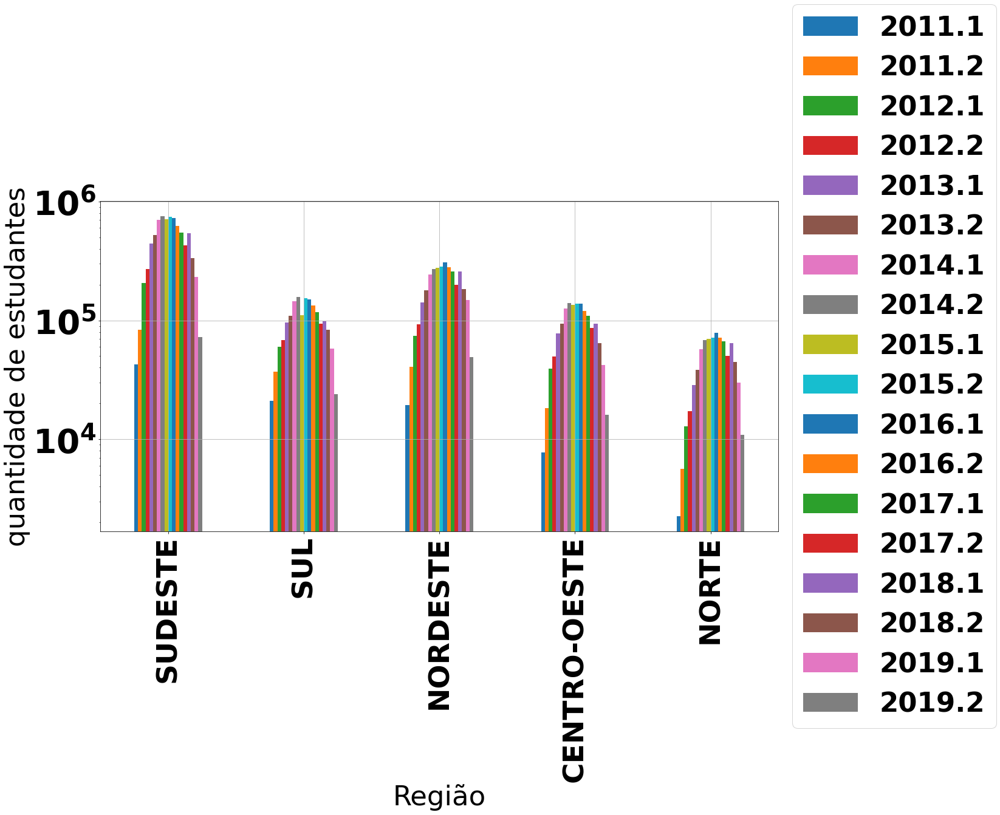

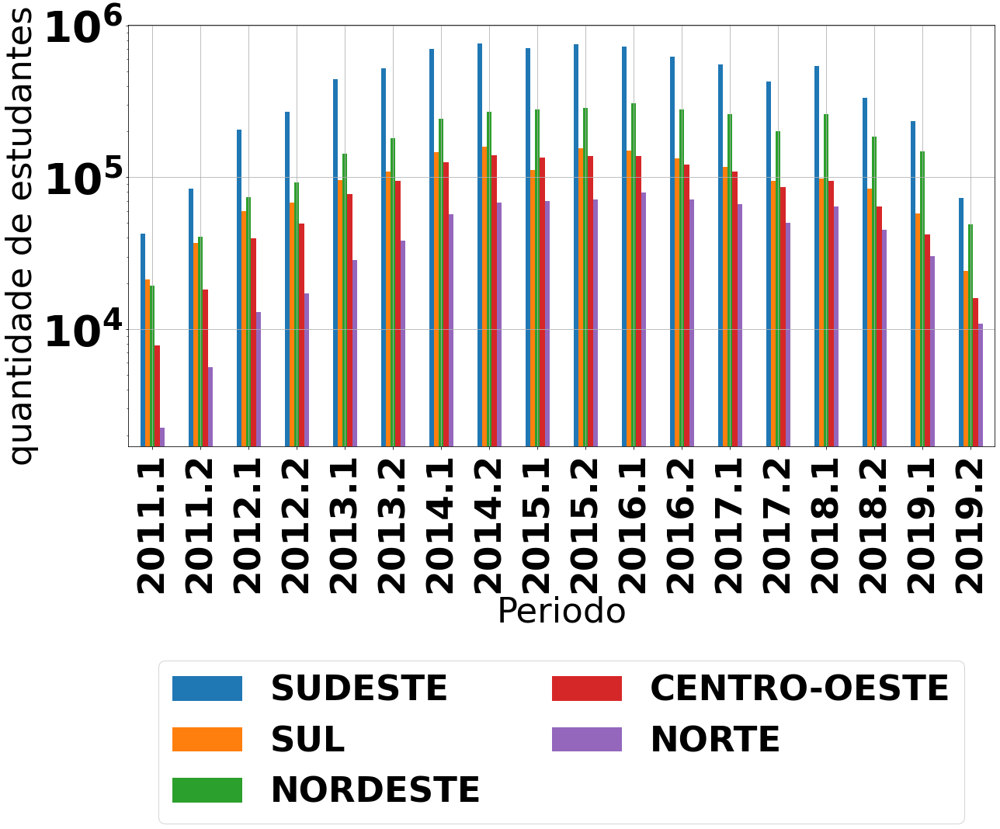

In [ ]:
graficoPorRegiaoVsPeriodo = dfPorRegiaoPorSemestre.plot.bar( grid=True, figsize= (20,10),
xlabel ="Região" ,ylabel= "quantidade de estudantes", logy= True).legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

graficoPorPeriodoVsRegiao = dfPorRegiaoPorSemestreTransposta.plot.bar( grid=True, figsize= (20,10),
xlabel ="Periodo" ,ylabel= "quantidade de estudantes", logy= True).legend(loc='center',ncol=2,bbox_to_anchor=(0.5, -0.7));


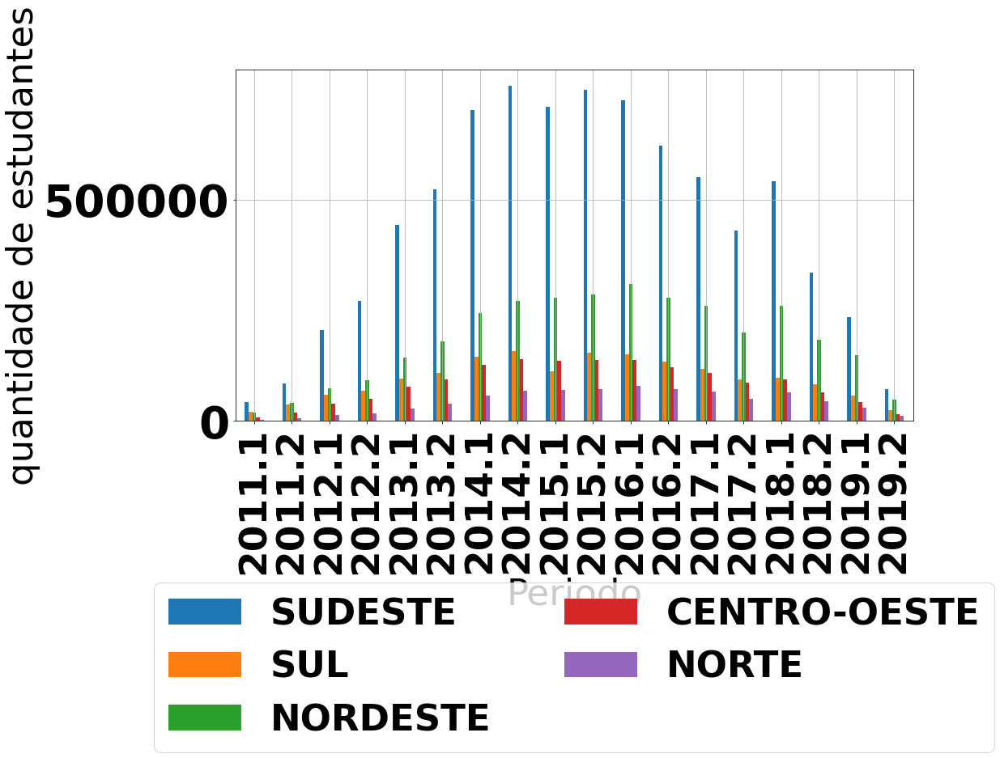

In [ ]:
graficoPorRegiao = dfPorRegiaoPorSemestreTransposta.plot.bar( grid=True, figsize= (15,8),
xlabel ="Periodo" ,ylabel= "quantidade de estudantes").legend(loc='center',ncol=2,bbox_to_anchor=(0.5, -0.7));

In [ ]:
dfPorRegiaoPorcentagemCrescimento = dfPorRegiaoPorSemestre[['2011.1','2011.2',
'2012.1','2012.2','2013.1','2013.2','2014.1','2014.2','2015.1','2015.2','2016.1','2016.2','2017.1','2017.2',
'2018.1','2018.2','2019.1','2019.2']].pct_change(periods = 1, axis = 1)
dfPorRegiaoPorcentagemCrescimento

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
REGIAO,,,,,,,,,,,,,,,,,,
SUDESTE,NaN,0.9728070382,1.4575751795,0.3107123970,0.6385338353,0.1801330637,0.3420498488,0.0788577297,-0.0622877950,0.0544165317,-0.0325489719,-0.1403828132,-0.1156288339,-0.2201036710,0.2613568015,-0.3813003757,-0.3021362019,-0.6888730031
SUL,NaN,0.7575010665,0.6141917040,0.1363886986,0.4070926574,0.1368205471,0.3399205853,0.0848824926,-0.2965944155,0.3862285945,-0.0265804644,-0.1095781816,-0.1223375205,-0.1980121216,0.0418677324,-0.1454178186,-0.3111845954,-0.5831369151
NORDESTE,NaN,1.1027049435,0.8306717926,0.2435754190,0.5419088754,0.2616961528,0.3524171471,0.1158193136,0.0275588954,0.0228832870,0.0824095253,-0.0963334122,-0.0689010831,-0.2297493538,0.2983337001,-0.2911254911,-0.1935198166,-0.6701252501
CENTRO-OESTE,NaN,1.3509763618,1.1568852459,0.2520078032,0.5661297503,0.2169132373,0.3396472824,0.1106346892,-0.0353312258,0.0237535138,-0.0012717590,-0.1267517997,-0.0977580036,-0.2090048394,0.0939085410,-0.3175238257,-0.3452656787,-0.6185160555
NORTE,NaN,1.4924511545,1.2968109745,0.3305150481,0.6658310500,0.3426541611,0.4949042096,0.1908564653,0.0199420188,0.0279931094,0.1034492389,-0.0950796021,-0.0678693798,-0.2444037688,0.2754854851,-0.3021670092,-0.3298532102,-0.6393808256


In [ ]:
dfPorRegiaoPorcentagemCrescimentoTransposta = dfPorRegiaoPorcentagemCrescimento.T
dfPorRegiaoPorcentagemCrescimentoTransposta

REGIAO,SUDESTE,SUL,NORDESTE,CENTRO-OESTE,NORTE
2011.1,NaN,NaN,NaN,NaN,NaN
2011.2,0.9728070382,0.7575010665,1.1027049435,1.3509763618,1.4924511545
2012.1,1.4575751795,0.6141917040,0.8306717926,1.1568852459,1.2968109745
2012.2,0.3107123970,0.1363886986,0.2435754190,0.2520078032,0.3305150481
2013.1,0.6385338353,0.4070926574,0.5419088754,0.5661297503,0.6658310500
2013.2,0.1801330637,0.1368205471,0.2616961528,0.2169132373,0.3426541611
2014.1,0.3420498488,0.3399205853,0.3524171471,0.3396472824,0.4949042096
2014.2,0.0788577297,0.0848824926,0.1158193136,0.1106346892,0.1908564653
2015.1,-0.0622877950,-0.2965944155,0.0275588954,-0.0353312258,0.0199420188
2015.2,0.0544165317,0.3862285945,0.0228832870,0.0237535138,0.0279931094


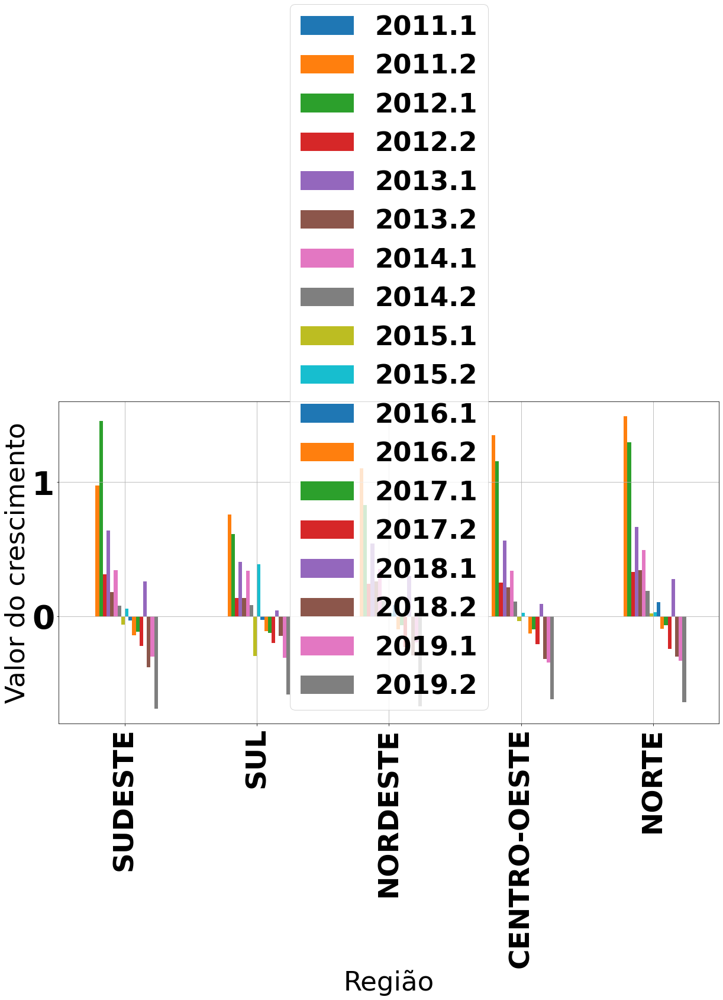

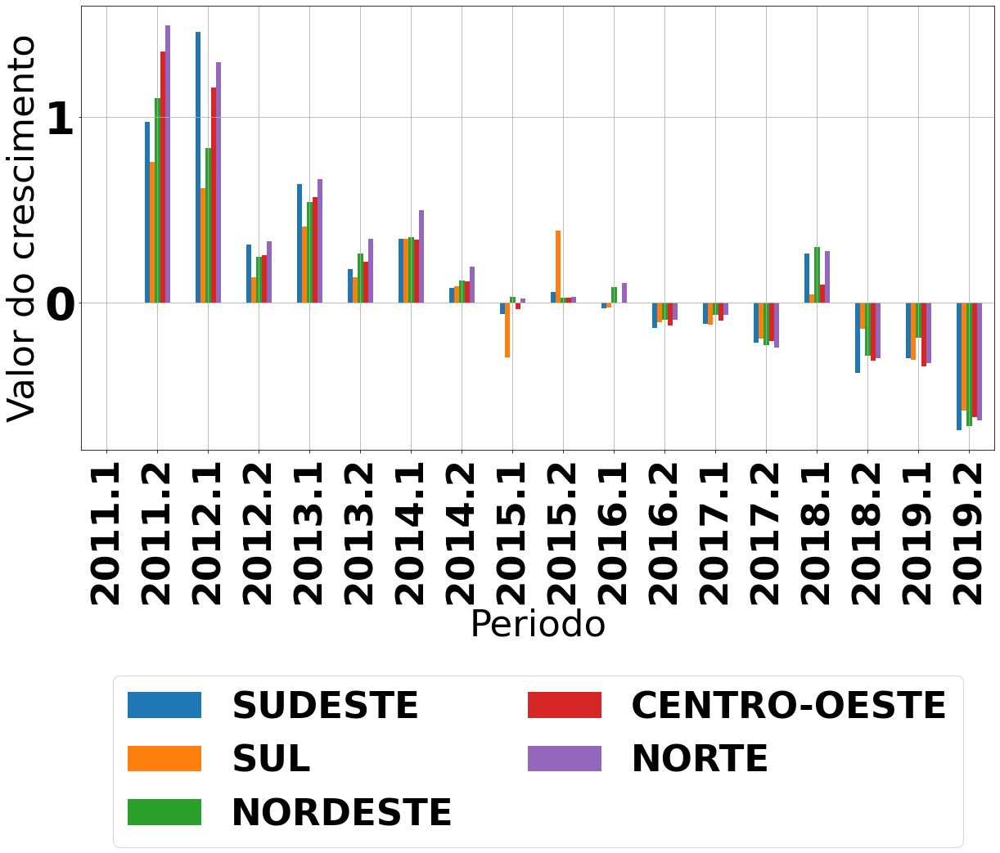

In [ ]:
graficoPorRegiaoVsPeriodoCrescimento = dfPorRegiaoPorcentagemCrescimento.plot.bar( grid=True, figsize= (20,10),
xlabel ="Região" ,ylabel= "Valor do crescimento")

graficoPorPeriodoVsRegiaoCrescimento = dfPorRegiaoPorcentagemCrescimentoTransposta.plot.bar(
grid=True, figsize= (20,10), xlabel ="Periodo" ,ylabel= "Valor do crescimento" ).legend(loc='center',ncol=2,bbox_to_anchor=(0.5, -0.7));



array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f40527738e0>,
      dtype=object)

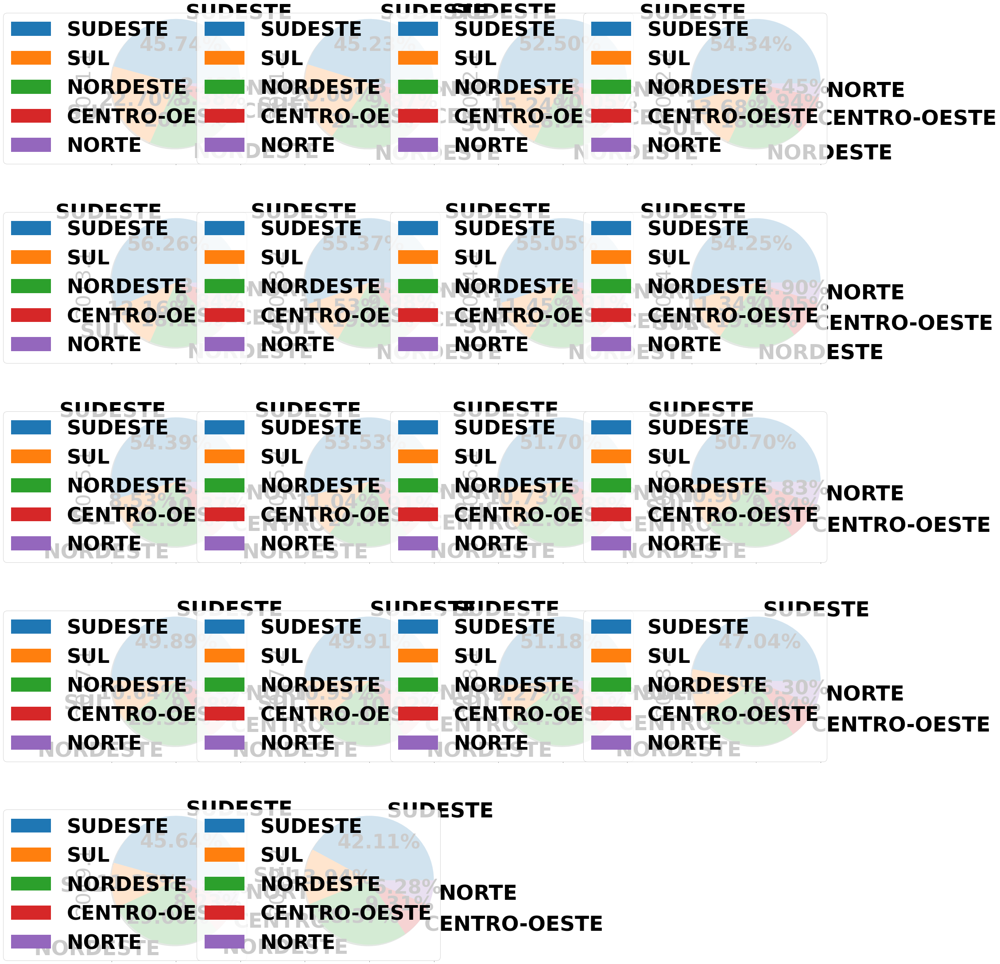

In [ ]:
dfPorRegiaoPorSemestre.plot.pie(subplots=True, layout=(5,4), figsize=(30,40), shadow=True, autopct='%1.2f%%')


In [ ]:
dfPorRegiaoPorSemestreTransposta.sum()

REGIAO
SUDESTE         7988593
SUL             1718633
NORDESTE        3314653
CENTRO-OESTE    1497069
NORTE            789241
dtype: int64

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f4051ea26d0>,
      dtype=object)

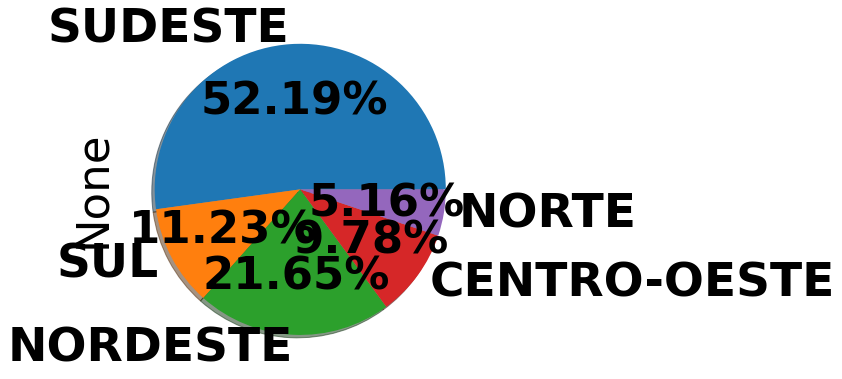

In [ ]:
dfPorRegiaoPorSemestreTransposta.sum().plot.pie(subplots=True, layout=(5,4), figsize=(30,40), shadow=True, autopct='%1.2f%%')

##Por estado

In [ ]:
dataPorEstadoPorSemestre = {'ESTADO': ['AC', 'AL', 'AP', 'AM', 'BA', 'CE', 'DF', 'ES', 'GO', 'MA', 'MG', 'MS', 'MT', 'PA', 'PB',
                    'PE', 'PI', 'PR','RJ', 'RN', 'RO', 'RR', 'RS', 'SC', 'SE', 'SP', 'TO'],
         '2011.1': [411, 565, 68, 255, 5647, 5104, 1427, 1768, 2431, 299, 16669, 800, 3126, 804, 1628, 2250, 1557,
                    7829, 5029, 1246, 449, 58 , 10259, 3009, 1002, 19045, 207],

         '2011.2': [1245, 1388, 580, 696, 11800, 10278, 3620, 3019, 4921, 907, 29792, 1292, 8467, 1628, 3306, 4566,
                    3519, 12631, 10495, 2729, 776, 233, 18574, 5873, 2085, 40560, 455],

         '2012.1': [2976, 2784,  1835, 1537, 21695, 13210, 7559, 6068, 9365, 3255, 52581, 3380, 19167, 3084, 7806, 
                    9351, 5719, 25024, 22761, 6792, 1665, 649, 24375, 10452, 3673, 124697, 1146],

         '2012.2': [3711, 2680, 2648, 1836, 29265, 17039, 11596, 7040, 12619, 5005, 65744, 3532, 21671, 4028, 9312, 
                    12065, 6572, 28145, 31829, 6119, 2116, 1286, 27255, 12614, 4322, 165534, 1528],

         '2013.1': [6032, 4467, 4563, 3910, 43973, 24074, 19488, 9223, 18310, 8010, 98104, 5562, 34035, 5917, 14619, 
                    20054, 9047, 40908, 51942, 11402, 3967, 2194, 36104, 18690, 6794, 283376, 1991],

         '2013.2': [6865, 5372, 5837, 7417, 55458, 30323, 26021, 10143, 22800, 10903, 116923, 5515, 39847, 7436, 
                    19328, 24726, 11575, 42414, 65029, 14003, 5665, 3066, 44412, 21970, 8028, 330285, 2079],

         '2014.1': [8724, 7004, 7955, 14404, 74801, 37732, 36521, 14439, 30831, 16211, 155136, 8388, 50432, 10144, 
                    27094, 34281, 14312, 58126, 90383, 19588, 9657, 4280, 58457, 29195, 12028, 441102, 2188],

         '2014.2': [9419, 7720, 9119, 18380, 81979, 44266, 42312, 17268, 35109, 19174, 168136, 9356, 53354, 13763, 
                    29780, 37585, 16112, 59767, 103622, 19729, 10805, 4359, 65439, 32946, 14856, 467318, 2453],
         
         '2015.1': [9289, 7164, 10495, 19482, 89582, 40548, 40490, 15291, 29706, 19127, 157484, 8489, 56495, 13649, 
                    33614, 42241, 16487, 46763, 101476, 21346, 9159, 5173, 41679, 22803, 8566, 434982, 2413],
         
         '2015.2': [9070, 8875, 9476, 19679, 81826, 41702, 43163, 17897, 35793, 21013, 162405, 9067, 50368, 15653, 
                    35263, 41413, 17082, 57064, 108095, 20698, 10352, 4997, 64383, 32764, 17180, 459430, 2383],

         '2016.1': [9675, 9040, 9997, 20224, 91116, 47996, 42659, 18325, 35922, 20347, 169543, 9973, 49661, 19851, 
                    37049, 45520, 18166, 56086, 107085, 21362, 11971, 4739, 62856, 31170, 17947, 428533, 2561],

         '2016.2': [8873, 8310, 8620, 17639, 81483, 43995, 37442, 16642, 32477, 18446, 147850, 9078, 41699, 19141, 
                    33735, 41100, 16860, 50218, 92003, 18366, 10706, 3995, 56052, 27393, 16525, 365426, 2531],

         '2017.1': [7674, 7432, 8333, 16426, 76079, 40682, 32639, 14907, 28311, 16752, 138706, 7843, 40104, 18749, 
                    31060, 39515, 15866, 43006, 87097, 17163, 9514, 3675, 50105, 24200, 15060, 309299, 2281],

         '2017.2': [6221, 5615, 5910, 12357, 59988, 31735, 24977, 11943, 24150, 13572, 106363, 6409, 30601, 13557, 
                    24546, 28110, 12302, 36090, 57954, 12199, 8043, 2562, 39278, 18714, 11897, 252690, 1712],

         '2018.1': [6120, 7245, 6240, 16284, 77514, 39709, 26015, 12327, 26299, 13741, 141632, 6949, 34963, 20746, 
                    31416, 41464, 16272, 34319, 88898, 18559, 8423, 3984, 43741, 19961, 13700, 298202, 2439],

         '2018.2': [4864, 5087, 2487, 10513, 54964, 33310, 21241, 10170, 19249, 9272, 98272, 5525, 18292, 15940, 
                    22174, 26389, 11206, 32690, 53160, 10763, 7114, 2173, 34684, 16393, 10873, 173151, 1735],

         '2019.1': [3587, 2898, 1912, 7204, 42761, 27296, 14795, 7562, 14117, 7139, 74709, 4030, 9162, 9083, 20532, 
                    22541, 8849, 21253, 38781, 7641, 5229, 1560, 24221, 12226, 8766, 112560, 1465],

         '2019.2': [1538, 1352, 615, 1486, 17460, 7008, 3171, 3070, 5694, 2570, 27631, 1762, 5435, 3363, 6609, 4697,
                    3280,  9399, 6935, 1307, 2580, 517, 10564, 4090, 4678, 35047, 734],

         }

In [ ]:
dfPorEstadoPorSemestre = pd.DataFrame(dataPorEstadoPorSemestre)
dfPorEstadoPorSemestre.set_index('ESTADO', inplace=True)
dfPorEstadoPorSemestre

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
ESTADO,,,,,,,,,,,,,,,,,,
AC,411,1245,2976,3711,6032,6865,8724,9419,9289,9070,9675,8873,7674,6221,6120,4864,3587,1538
AL,565,1388,2784,2680,4467,5372,7004,7720,7164,8875,9040,8310,7432,5615,7245,5087,2898,1352
AP,68,580,1835,2648,4563,5837,7955,9119,10495,9476,9997,8620,8333,5910,6240,2487,1912,615
AM,255,696,1537,1836,3910,7417,14404,18380,19482,19679,20224,17639,16426,12357,16284,10513,7204,1486
BA,5647,11800,21695,29265,43973,55458,74801,81979,89582,81826,91116,81483,76079,59988,77514,54964,42761,17460
CE,5104,10278,13210,17039,24074,30323,37732,44266,40548,41702,47996,43995,40682,31735,39709,33310,27296,7008
DF,1427,3620,7559,11596,19488,26021,36521,42312,40490,43163,42659,37442,32639,24977,26015,21241,14795,3171
ES,1768,3019,6068,7040,9223,10143,14439,17268,15291,17897,18325,16642,14907,11943,12327,10170,7562,3070
GO,2431,4921,9365,12619,18310,22800,30831,35109,29706,35793,35922,32477,28311,24150,26299,19249,14117,5694


In [ ]:
dfPorEstadoPorSemestreTransposta = dfPorEstadoPorSemestre.T
dfPorEstadoPorSemestreTransposta

ESTADO,AC,AL,AP,AM,BA,CE,DF,ES,GO,MA,...,PR,RJ,RN,RO,RR,RS,SC,SE,SP,TO
2011.1,411,565,68,255,5647,5104,1427,1768,2431,299,...,7829,5029,1246,449,58,10259,3009,1002,19045,207
2011.2,1245,1388,580,696,11800,10278,3620,3019,4921,907,...,12631,10495,2729,776,233,18574,5873,2085,40560,455
2012.1,2976,2784,1835,1537,21695,13210,7559,6068,9365,3255,...,25024,22761,6792,1665,649,24375,10452,3673,124697,1146
2012.2,3711,2680,2648,1836,29265,17039,11596,7040,12619,5005,...,28145,31829,6119,2116,1286,27255,12614,4322,165534,1528
2013.1,6032,4467,4563,3910,43973,24074,19488,9223,18310,8010,...,40908,51942,11402,3967,2194,36104,18690,6794,283376,1991
2013.2,6865,5372,5837,7417,55458,30323,26021,10143,22800,10903,...,42414,65029,14003,5665,3066,44412,21970,8028,330285,2079
2014.1,8724,7004,7955,14404,74801,37732,36521,14439,30831,16211,...,58126,90383,19588,9657,4280,58457,29195,12028,441102,2188
2014.2,9419,7720,9119,18380,81979,44266,42312,17268,35109,19174,...,59767,103622,19729,10805,4359,65439,32946,14856,467318,2453
2015.1,9289,7164,10495,19482,89582,40548,40490,15291,29706,19127,...,46763,101476,21346,9159,5173,41679,22803,8566,434982,2413
2015.2,9070,8875,9476,19679,81826,41702,43163,17897,35793,21013,...,57064,108095,20698,10352,4997,64383,32764,17180,459430,2383


In [ ]:
totaisPorEstadoPorSemestre = dfPorEstadoPorSemestre.sum(0, numeric_only=True)
totaisPorEstadoPorSemestre

2011.1      92942
2011.2     185435
2012.1     392606
2012.2     497111
2013.1     786756
2013.2     943440
2014.1    1273413
2014.2    1394126
2015.1    1303993
2015.2    1397091
2016.1    1399374
2016.2    1226605
2017.1    1102478
2017.2     859495
2018.1    1057162
2018.2     711691
2019.1     511879
2019.2     172592
dtype: int64

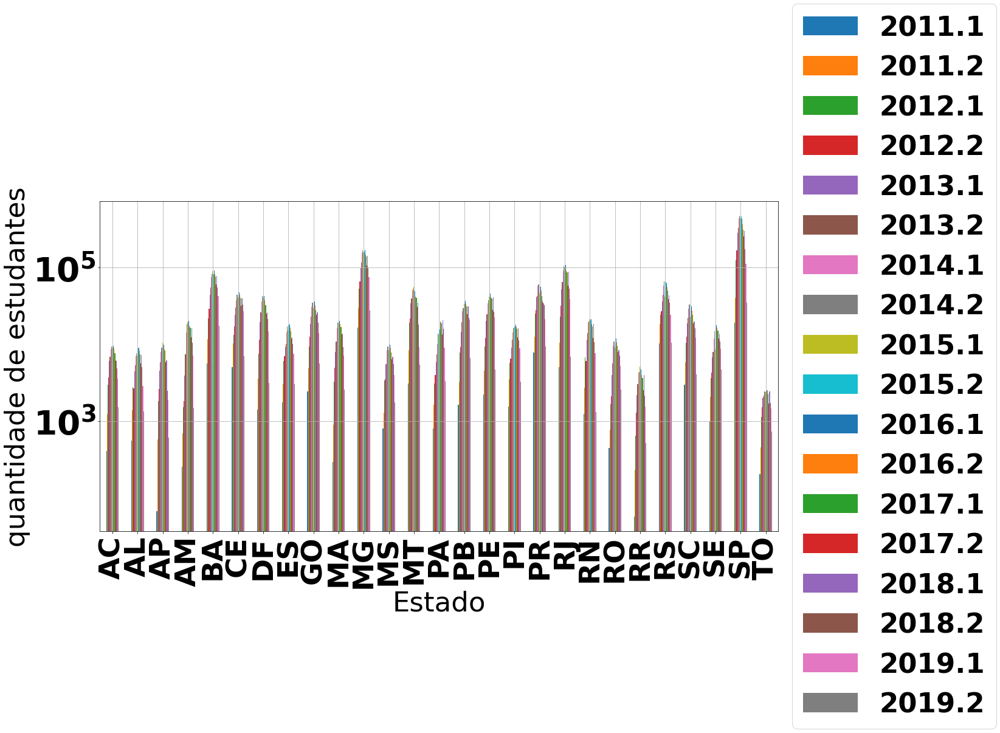

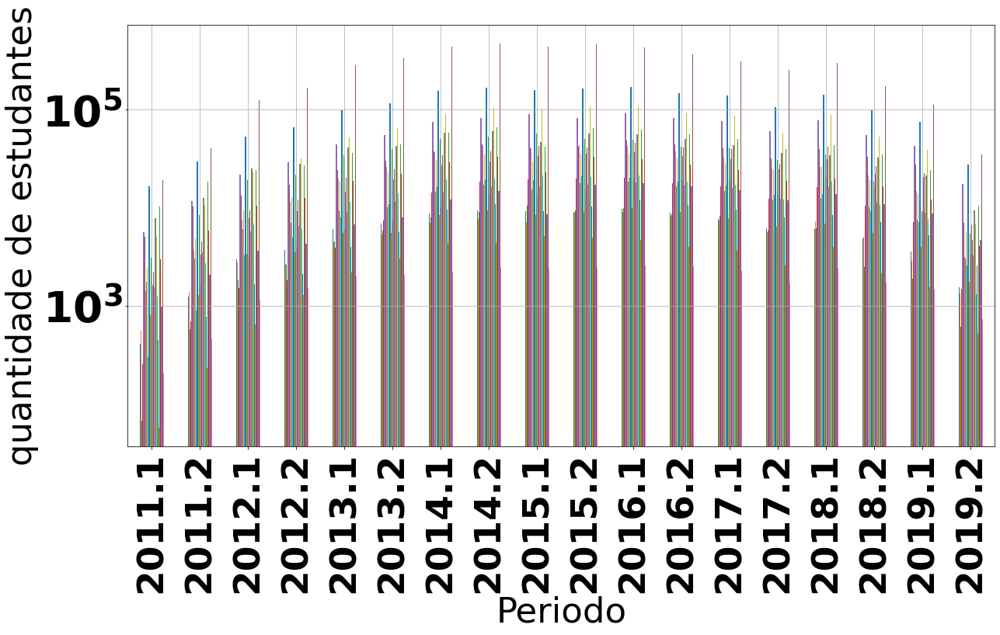

In [ ]:
graficoPorEstadoPorSemestre = dfPorEstadoPorSemestre.plot.bar( grid=True, figsize= (20,10),
xlabel ="Estado" ,ylabel= "quantidade de estudantes", logy=True).legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

graficoPorPeriodoVsPorEstado = dfPorEstadoPorSemestreTransposta.plot.bar( grid=True, figsize= (20,10),
xlabel ="Periodo" ,ylabel= "quantidade de estudantes", logy=True,legend=False);

In [ ]:
dfPorEstadoPorSemestrePorcentagemCrescimento = dfPorEstadoPorSemestre[['2011.1','2011.2',
'2012.1','2012.2','2013.1','2013.2','2014.1','2014.2','2015.1','2015.2','2016.1','2016.2','2017.1','2017.2',
'2018.1','2018.2','2019.1','2019.2']].pct_change(periods = 1, axis = 1)
dfPorEstadoPorSemestrePorcentagemCrescimento

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
ESTADO,,,,,,,,,,,,,,,,,,
AC,NaN,2.0291970803,1.3903614458,0.2469758065,0.6254378874,0.1380968170,0.2707938820,0.0796652912,-0.0138018898,-0.0235762730,0.0667034179,-0.0828940568,-0.1351290432,-0.1893406307,-0.0162353319,-0.2052287582,-0.2625411184,-0.5712294396
AL,NaN,1.4566371681,1.0057636888,-0.0373563218,0.6667910448,0.2025968211,0.3037974684,0.1022272987,-0.0720207254,0.2388330542,0.0185915493,-0.0807522124,-0.1056558363,-0.2444833154,0.2902938557,-0.2978605935,-0.4303125614,-0.5334713596
AP,NaN,7.5294117647,2.1637931034,0.4430517711,0.7231873112,0.2792022792,0.3628576323,0.1463230673,0.1508937383,-0.0970938542,0.0549810046,-0.1377413224,-0.0332946636,-0.2907716309,0.0558375635,-0.6014423077,-0.2312022517,-0.6783472803
AM,NaN,1.7294117647,1.2083333333,0.1945348081,1.1296296296,0.8969309463,0.9420250775,0.2760344349,0.0599564744,0.0101118982,0.0276944967,-0.1278184335,-0.0687680708,-0.2477170340,0.3177955815,-0.3543969541,-0.3147531628,-0.7937257079
BA,NaN,1.0896051001,0.8385593220,0.3489283245,0.5025798736,0.2611829987,0.3487864690,0.0959612839,0.0927432635,-0.0865798933,0.1135335957,-0.1057223759,-0.0663205822,-0.2115038315,0.2921584317,-0.2909151895,-0.2220180482,-0.5916840111
CE,NaN,1.0137147335,0.2852695077,0.2898561696,0.4128763425,0.2595746448,0.2443359826,0.1731686632,-0.0839922288,0.0284600967,0.1509280130,-0.0833611134,-0.0753040118,-0.2199252741,0.2512683157,-0.1611473469,-0.1805463825,-0.7432590856
DF,NaN,1.5367904695,1.0881215470,0.5340653526,0.6805795102,0.3352319376,0.4035202337,0.1585663043,-0.0430610701,0.0660163003,-0.0116766675,-0.1222954125,-0.1282784039,-0.2347498391,0.0415582336,-0.1835095137,-0.3034697048,-0.7856708347
ES,NaN,0.7075791855,1.0099370653,0.1601845748,0.3100852273,0.0997506234,0.4235433304,0.1959276958,-0.1144892286,0.1704270486,0.0239146226,-0.0918417462,-0.1042542964,-0.1988327631,0.0321527254,-0.1749817474,-0.2564405113,-0.5940227453
GO,NaN,1.0242698478,0.9030684820,0.3474639616,0.4509866075,0.2452211906,0.3522368421,0.1387564464,-0.1538921644,0.2049080994,0.0036040567,-0.0959022326,-0.1282753949,-0.1469746742,0.0889855072,-0.2680710293,-0.2666112525,-0.5966565134


In [ ]:
dfPorEstadoPorSemestrePorcentagemCrescimentoTransposta = dfPorEstadoPorSemestrePorcentagemCrescimento.T
dfPorEstadoPorSemestrePorcentagemCrescimentoTransposta

ESTADO,AC,AL,AP,AM,BA,CE,DF,ES,GO,MA,...,PR,RJ,RN,RO,RR,RS,SC,SE,SP,TO
2011.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2011.2,2.0291970803,1.4566371681,7.5294117647,1.7294117647,1.0896051001,1.0137147335,1.5367904695,0.7075791855,1.0242698478,2.0334448161,...,0.6133605824,1.0868960032,1.1902086677,0.7282850780,3.0172413793,0.8105078468,0.9518112330,1.0808383234,1.1296928328,1.1980676329
2012.1,1.3903614458,1.0057636888,2.1637931034,1.2083333333,0.8385593220,0.2852695077,1.0881215470,1.0099370653,0.9030684820,2.5887541345,...,0.9811574697,1.1687470224,1.4888237450,1.1456185567,1.7854077253,0.3123182944,0.7796696748,0.7616306954,2.0743836292,1.5186813187
2012.2,0.2469758065,-0.0373563218,0.4430517711,0.1945348081,0.3489283245,0.2898561696,0.5340653526,0.1601845748,0.3474639616,0.5376344086,...,0.1247202685,0.3984007733,-0.0990871614,0.2708708709,0.9815100154,0.1181538462,0.2068503636,0.1766947999,0.3274898354,0.3333333333
2013.1,0.6254378874,0.6667910448,0.7231873112,1.1296296296,0.5025798736,0.4128763425,0.6805795102,0.3100852273,0.4509866075,0.6003996004,...,0.4534730858,0.6319080084,0.8633763687,0.8747637051,0.7060653188,0.3246743717,0.4816870144,0.5719574271,0.7118900045,0.3030104712
2013.2,0.1380968170,0.2025968211,0.2792022792,0.8969309463,0.2611829987,0.2595746448,0.3352319376,0.0997506234,0.2452211906,0.3611735331,...,0.0368143150,0.2519541027,0.2281178741,0.4280312579,0.3974475843,0.2301130069,0.1754949171,0.1816308508,0.1655362487,0.0441988950
2014.1,0.2707938820,0.3037974684,0.3628576323,0.9420250775,0.3487864690,0.2443359826,0.4035202337,0.4235433304,0.3522368421,0.4868384848,...,0.3704437214,0.3898875886,0.3988431050,0.7046778464,0.3959556425,0.3162433577,0.3288575330,0.4982561036,0.3355193242,0.0524290524
2014.2,0.0796652912,0.1022272987,0.1463230673,0.2760344349,0.0959612839,0.1731686632,0.1585663043,0.1959276958,0.1387564464,0.1827771266,...,0.0282317724,0.1464766604,0.0071982847,0.1188774982,0.0184579439,0.1194382195,0.1284809043,0.2351180579,0.0594329656,0.1211151737
2015.1,-0.0138018898,-0.0720207254,0.1508937383,0.0599564744,0.0927432635,-0.0839922288,-0.0430610701,-0.1144892286,-0.1538921644,-0.0024512360,...,-0.2175782623,-0.0207098879,0.0819605657,-0.1523368811,0.1867400780,-0.3630862330,-0.3078674194,-0.4233979537,-0.0691948523,-0.0163065634
2015.2,-0.0235762730,0.2388330542,-0.0970938542,0.0101118982,-0.0865798933,0.0284600967,0.0660163003,0.1704270486,0.2049080994,0.0986040675,...,0.2202809914,0.0652272459,-0.0303569755,0.1302543946,-0.0340228107,0.5447347585,0.4368284875,1.0056035489,0.0562046246,-0.0124326564


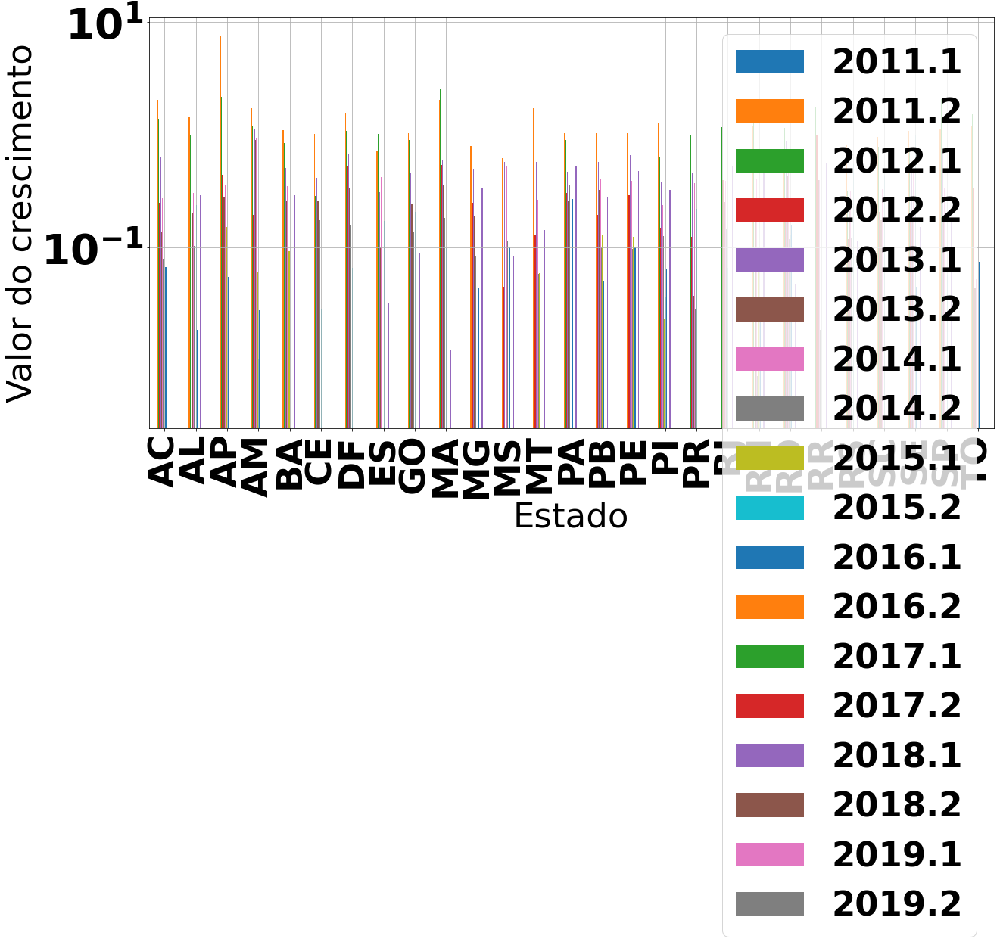

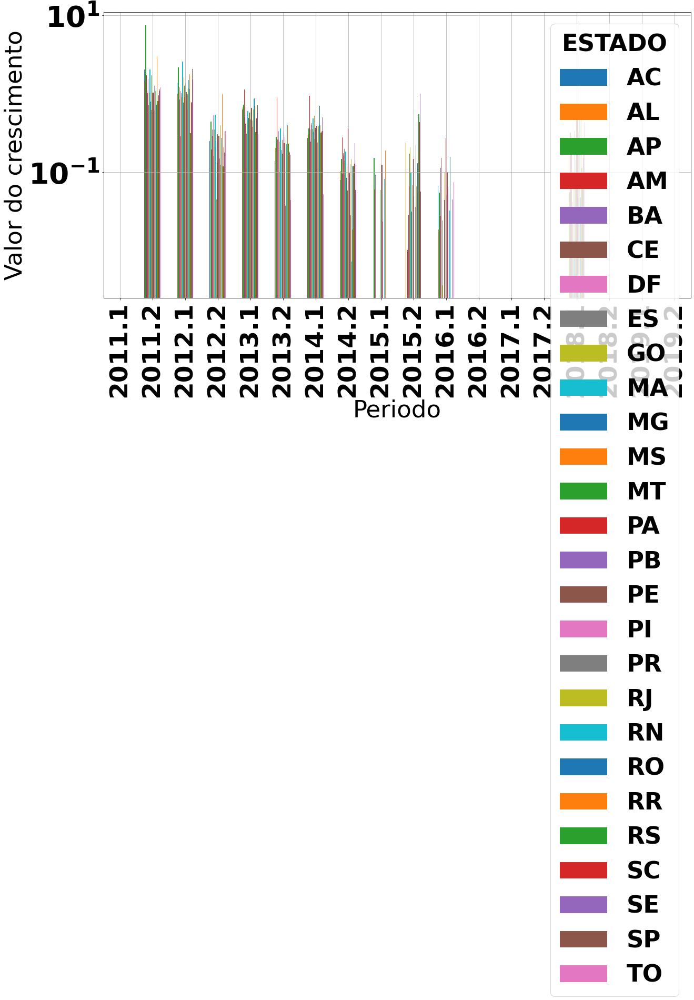

In [ ]:
graficoPorEstadoVsPeriodoCrescimento = dfPorEstadoPorSemestrePorcentagemCrescimento.plot.bar( 
 grid=True, figsize= (20,10),
xlabel ="Estado" ,ylabel= "Valor do crescimento", logy=True)

graficoPorPeriodoVsEstadoCrescimento = dfPorEstadoPorSemestrePorcentagemCrescimentoTransposta.plot.bar( 
grid=True, figsize= (20,10), xlabel ="Periodo" ,ylabel= "Valor do crescimento", logy=True )


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f406fda5ac0>,
      dtype=object)

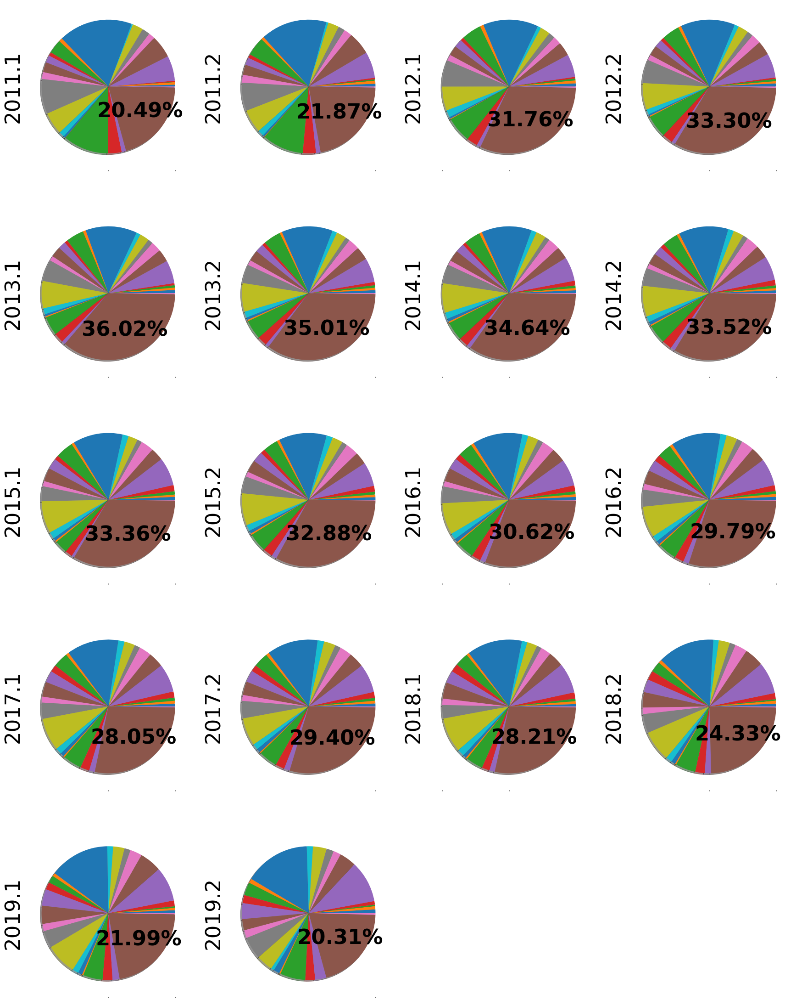

In [ ]:
autopct = lambda v: f'{v:.2f}%' if v > 20 else None
dfPorEstadoPorSemestre.plot.pie(subplots=True, layout=(5,4), figsize=(30,40), shadow=True,
logy=True, legend=None, autopct=autopct, counterclock= True, labeldistance=1.2, labels=None)

##Por principais Cursos

Analise dos 5 cursos com mais estudantes por período

2011.1:

DIREITO                                                          16483

ENFERMAGEM                                                        7595

MEDICINA                                                          6071

ADMINISTRAÇÃO                                                     5677

ENGENHARIA CIVIL                                                  4993

		
2011.2:
	
DIREITO                                                          32397

ENFERMAGEM                                                       15810

ADMINISTRAÇÃO                                                    12393

MEDICINA                                                         10721

ENGENHARIA CIVIL                                                 10342
	
  —-------------------------------------------------------------------------------------------------------------------

2012.1:

DIREITO                                                          63820

ENFERMAGEM                                                       31883

ADMINISTRAÇÃO                                                    30566

ENGENHARIA CIVIL                                                 24647

PSICOLOGIA                                                       16930

2012.2:

DIREITO                                                       79088

ADMINISTRAÇÃO                                                 41956

ENFERMAGEM                                                    39694

ENGENHARIA CIVIL                                              31896

PEDAGOGIA                                                     22487

—-------------------------------------------------------------------------------------------------------------------


2013.1:

DIREITO                                     122199

ADMINISTRAÇÃO                                67466

ENFERMAGEM                                   58256

ENGENHARIA CIVIL                             53055

PEDAGOGIA                                    38966

2013.2:

DIREITO                         151516

ADMINISTRAÇÃO                    78315

ENFERMAGEM                       68076

ENGENHARIA CIVIL                 66093

PEDAGOGIA                        44472

—-------------------------------------------------------------------------------------------------------------------

2014.1:

DIREITO                                     202548

ADMINISTRAÇÃO                                99850

ENGENHARIA CIVIL                             95690

ENFERMAGEM                                   89645

PSICOLOGIA                                   61248

2014.2:

DIREITO                              225317

ENGENHARIA CIVIL                     107465

ADMINISTRAÇÃO                        106308

ENFERMAGEM                            97788

PSICOLOGIA                            69043

—-------------------------------------------------------------------------------------------------------------------

2015.1:

DIREITO                                210925

ENGENHARIA CIVIL                       102642

ADMINISTRAÇÃO                           99695

ENFERMAGEM                              95526

PSICOLOGIA                              66091

2015.2:

DIREITO                             234523

ENGENHARIA CIVIL                    114182

ADMINISTRAÇÃO                       101226

ENFERMAGEM                          100546

PSICOLOGIA                           73430

—-------------------------------------------------------------------------------------------------------------------

2016.1:

DIREITO                     237088

ENGENHARIA CIVIL            119067

ENFERMAGEM                  105905

ADMINISTRAÇÃO                92504

PSICOLOGIA                   79460

2016.2:

DIREITO                                              215760

ENGENHARIA CIVIL                                     107464

ENFERMAGEM                                            97005

ADMINISTRAÇÃO                                         76424

PSICOLOGIA                                            73839

—-------------------------------------------------------------------------------------------------------------------

2017.1:

DIREITO                                              196967

ENGENHARIA CIVIL                                      97732

ENFERMAGEM                                            89101

PSICOLOGIA                                            68999

ADMINISTRAÇÃO                                         64937

2017.2:

DIREITO                              160013

ENGENHARIA CIVIL                      78942

ENFERMAGEM                            71413

PSICOLOGIA                            55826

ADMINISTRAÇÃO                         48183

—-------------------------------------------------------------------------------------------------------------------

2018.1:

DIREITO                         190256

ENGENHARIA CIVIL                 92256

ENFERMAGEM                       88661

PSICOLOGIA                       67868

ADMINISTRAÇÃO                    61397


2018.2:

DIREITO                                                         140275

ENGENHARIA CIVIL                                                 65749

ENFERMAGEM                                                       62749

PSICOLOGIA                                                       52080

FISIOTERAPIA                                                     36768

—-------------------------------------------------------------------------------------------------------------------

2019.1:

DIREITO                                                       102184

ENGENHARIA CIVIL                                               47675

ENFERMAGEM                                                     46776

PSICOLOGIA                                                     38542

FISIOTERAPIA                                                   27641

      
2019.2:		

DIREITO                                                          33513

ENFERMAGEM                                                       16598

ENGENHARIA CIVIL                                                 14592

PSICOLOGIA                                                       12320

MEDICINA                                                         11131


Podemos observar a repetição de várais cursos ao decorrer do tempo, como DIREITO, ENFERMAGEM, MEDICINA E ADMINISTRAÇÃO. Destaque para direito que sempre ocupa a 1º posição, e com uma grande vantagem para o 2º colocado.

##Por municipio 

Analise dos 5 municipio com mais estudantes por período

2011.1:

Belo Horizonte              10067

São Paulo                    7159

Valinhos                     4481

Fortaleza                    3997

Rio de Janeiro               3831

2011.2:

Belo Horizonte              19197

Valinhos                    13423

São Paulo                   13317

Rio de Janeiro               8362

Fortaleza                    7460


—-------------------------------------------------------------------------------------------------------------------

2012.1:

São Paulo          47872

Valinhos           38660

Belo Horizonte     33358

Rio de Janeiro     18841

Salvador           11759


2012.2:

São Paulo           64826

Valinhos            51415

Belo Horizonte      43477

Rio de Janeiro      25262

Salvador            16725



—-------------------------------------------------------------------------------------------------------------------

2013.1:

São Paulo          112796

Valinhos            86001

Belo Horizonte      67025

Rio de Janeiro      40718

Salvador            27190


2013.2:

São Paulo         133820

Valinhos          108342

Belo Horizonte     79891

Rio de Janeiro     50237

Salvador           35574


—-------------------------------------------------------------------------------------------------------------------

2014.1:

São Paulo                   183944

Valinhos                    137556

Belo Horizonte              103456

Rio de Janeiro               69304

Salvador                     46723

2014.2:

São Paulo               209604

Valinhos                141847

Belo Horizonte          111408

Rio de Janeiro           77404

Salvador                 50455


—-------------------------------------------------------------------------------------------------------------------	

2015.1:

São Paulo             219058

Valinhos              117106

Belo Horizonte        108167

Rio de Janeiro         80848

Salvador               55686


2015.2:

São Paulo         225222

Valinhos          121482

Belo Horizonte    107567

Rio de Janeiro     83537

Salvador           49156

—-------------------------------------------------------------------------------------------------------------------	

2016.1:

São Paulo                     207477

Valinhos                      113680

Belo Horizonte                111430

Rio de Janeiro                 79526

Salvador                       56758


2016.2:

São Paulo         176513

Belo Horizonte     94025

Valinhos           93860

Rio de Janeiro     67340

Salvador           49370

—-------------------------------------------------------------------------------------------------------------------	

2017.1:

São Paulo         154308

Belo Horizonte     90930

Valinhos           76844

Rio de Janeiro     63408

Salvador           45425


2017.2:

UNIVERSIDADE PAULISTA                          55373

UNIVERSIDADE ESTÁCIO DE SÁ                     23421

UNIVERSIDADE NOVE DE JULHO                     13511

Centro Universitário Estácio do Ceará           8668

UNIVERSIDADE ANHANGUERA DE SÃO PAULO            6890


—-------------------------------------------------------------------------------------------------------------------

2018.1:

São Paulo         180075

Belo Horizonte     98979

Rio de Janeiro     70870

Valinhos           47360

Salvador           43866

2018.2:

São Paulo               87694

Belo Horizonte          61286

Rio de Janeiro          38597

Valinhos                36753

Salvador                28704

—-------------------------------------------------------------------------------------------------------------------

2019.1:

São Paulo         55288

Belo Horizonte    47154

Rio de Janeiro    28251

Valinhos          23937

Salvador          22079


2019.2:

Belo Horizonte    16384

Valinhos          11143

São Paulo          9234

Salvador           7540

Aracaju            4620



Similar a situação com os principais cursos, podemos observar a repetição de várais cidades ao decorrer do tempo, como São Paulo, Rio de Janeiro, Valinhos, Belo Horizonte e Salvador. Cidades que possuem uma grande quantidade populacional.

##Por categoria de curso

In [ ]:
dataPorCategoriaDeCursoPorSemestre = {'CATEGORIA DO CURSO': ['Ciências Sociais Aplicadas', 'Ciências da Saúde', 'Engenharias', 
'Ciências Humanas', 'Ciências Exatas e da Terra', 'Ciências Agrárias', 'Ciências Biológicas', 'Linguística, Letras e Artes'],
         '2011.1': [33102, 28757, 14574, 6705, 4256, 2847, 1399, 1302],
         '2011.2': [67422, 56151, 29637, 14258, 7658, 5052, 2616, 2641],
         '2012.1': [147480, 105826, 66198, 34958, 16448,  9969, 5143, 6584],
         '2012.2': [190534, 128880, 84686, 46269, 20354, 11748, 6004, 8636],
         '2013.1': [304981, 194973, 136688, 77484, 30597, 18465, 9355, 14213],
         '2013.2': [369299, 233119, 165716, 92573, 34443, 21872, 11094, 15324],
         '2014.1': [489572, 316424, 316424, 123743, 45133, 31858, 14397, 19187],
         '2014.2': [539266, 348687, 254674, 135515, 45706, 35220, 15433, 19625],
         '2015.1': [501634, 331955, 238193, 128249, 40497, 32502, 13989, 16974],
         '2015.2': [531785, 362250, 257544, 136244, 40710, 36513, 14124, 17921],
         '2016.1': [513433, 379518, 264505, 136936, 37226, 38358, 13282, 16116],
         '2016.2': [442054, 344246, 234882, 119164, 28498, 34896, 10576, 12289],
         '2017.1': [393556, 314777, 213921, 104401, 24868, 31985, 8809, 10161],
         '2017.2': [305153, 250730, 168139, 80309, 16419, 26255, 5871, 6619],
         '2018.1': [375994, 311416, 198793, 101719, 22437, 30455, 7197, 9151],
         '2018.2': [240994, 221961, 140330, 64134, 11965, 24857, 3394, 4056],
         '2019.1': [167718, 165765, 101490, 45446, 7894, 18890, 2200, 2476],
         '2019.2': [53369, 62561, 30959, 14487, 2200, 7694, 664, 658],
         }

In [ ]:
dfPorCategoriaDeCursoPorSemestre = pd.DataFrame(dataPorCategoriaDeCursoPorSemestre)
dfPorCategoriaDeCursoPorSemestre.set_index('CATEGORIA DO CURSO', inplace=True)
dfPorCategoriaDeCursoPorSemestre

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
CATEGORIA DO CURSO,,,,,,,,,,,,,,,,,,
Ciências Sociais Aplicadas,33102,67422,147480,190534,304981,369299,489572,539266,501634,531785,513433,442054,393556,305153,375994,240994,167718,53369
Ciências da Saúde,28757,56151,105826,128880,194973,233119,316424,348687,331955,362250,379518,344246,314777,250730,311416,221961,165765,62561
Engenharias,14574,29637,66198,84686,136688,165716,316424,254674,238193,257544,264505,234882,213921,168139,198793,140330,101490,30959
Ciências Humanas,6705,14258,34958,46269,77484,92573,123743,135515,128249,136244,136936,119164,104401,80309,101719,64134,45446,14487
Ciências Exatas e da Terra,4256,7658,16448,20354,30597,34443,45133,45706,40497,40710,37226,28498,24868,16419,22437,11965,7894,2200
Ciências Agrárias,2847,5052,9969,11748,18465,21872,31858,35220,32502,36513,38358,34896,31985,26255,30455,24857,18890,7694
Ciências Biológicas,1399,2616,5143,6004,9355,11094,14397,15433,13989,14124,13282,10576,8809,5871,7197,3394,2200,664
"Linguística, Letras e Artes",1302,2641,6584,8636,14213,15324,19187,19625,16974,17921,16116,12289,10161,6619,9151,4056,2476,658


In [ ]:
dfPorCategoriaDeCursoPorSemestreTransposta = dfPorCategoriaDeCursoPorSemestre.T
dfPorCategoriaDeCursoPorSemestreTransposta

CATEGORIA DO CURSO,Ciências Sociais Aplicadas,Ciências da Saúde,Engenharias,Ciências Humanas,Ciências Exatas e da Terra,Ciências Agrárias,Ciências Biológicas,"Linguística, Letras e Artes"
2011.1,33102,28757,14574,6705,4256,2847,1399,1302
2011.2,67422,56151,29637,14258,7658,5052,2616,2641
2012.1,147480,105826,66198,34958,16448,9969,5143,6584
2012.2,190534,128880,84686,46269,20354,11748,6004,8636
2013.1,304981,194973,136688,77484,30597,18465,9355,14213
2013.2,369299,233119,165716,92573,34443,21872,11094,15324
2014.1,489572,316424,316424,123743,45133,31858,14397,19187
2014.2,539266,348687,254674,135515,45706,35220,15433,19625
2015.1,501634,331955,238193,128249,40497,32502,13989,16974
2015.2,531785,362250,257544,136244,40710,36513,14124,17921


In [ ]:
totaisPorCategoriaDeCursoPorSemestre = dfPorCategoriaDeCursoPorSemestre.sum(0, numeric_only=True)
totaisPorCategoriaDeCursoPorSemestre

2011.1      92942
2011.2     185435
2012.1     392606
2012.2     497111
2013.1     786756
2013.2     943440
2014.1    1356738
2014.2    1394126
2015.1    1303993
2015.2    1397091
2016.1    1399374
2016.2    1226605
2017.1    1102478
2017.2     859495
2018.1    1057162
2018.2     711691
2019.1     511879
2019.2     172592
dtype: int64

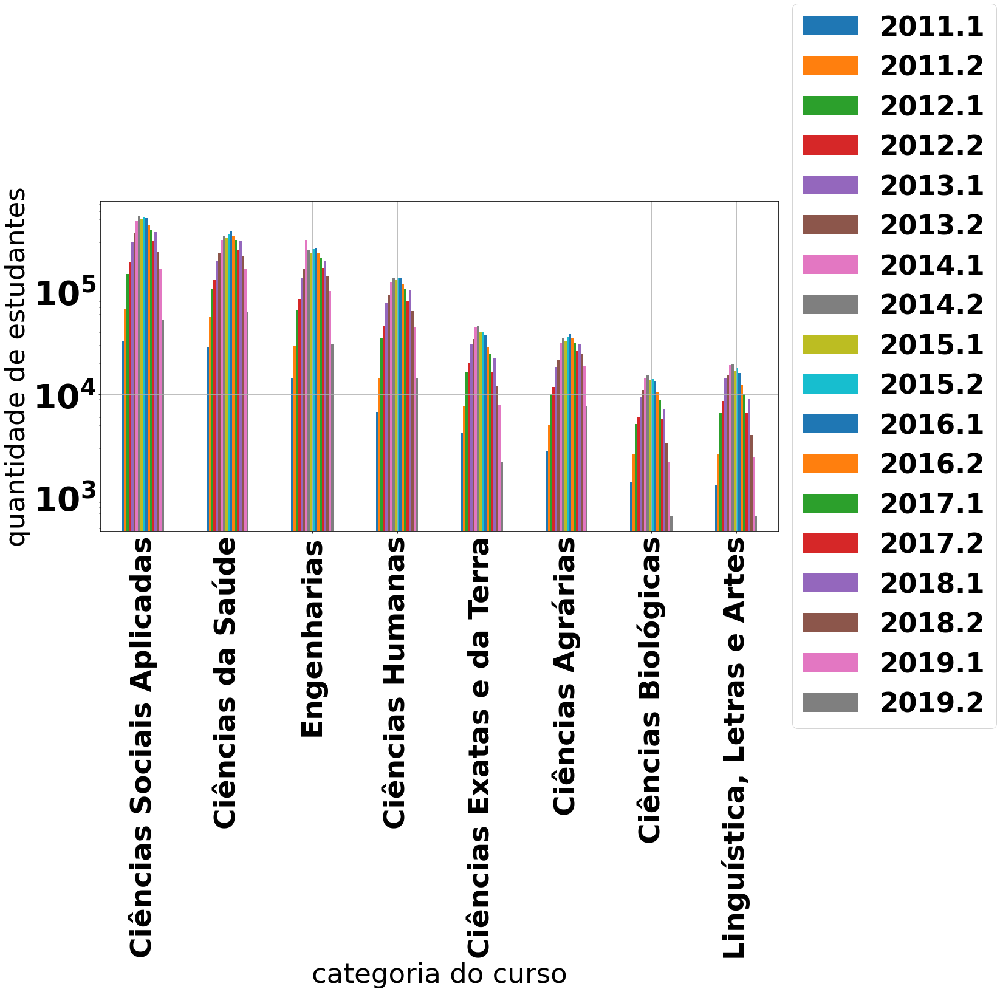

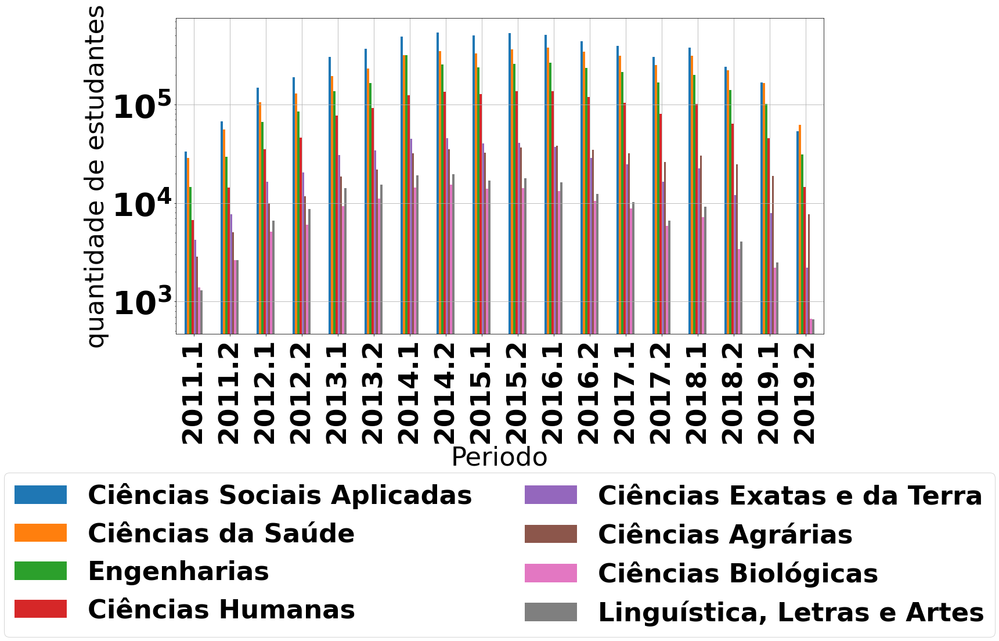

In [ ]:
graficoPorCategoriaDeCursoPorSemestre = dfPorCategoriaDeCursoPorSemestre.plot.bar( grid=True, figsize= (20,10),
xlabel ="categoria do curso" ,ylabel= "quantidade de estudantes", logy= True).legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

graficoPorPeriodoVsPorCategoriaDeCurso = dfPorCategoriaDeCursoPorSemestreTransposta.plot.bar( grid=True, figsize= (20,10),
xlabel ="Periodo" ,ylabel= "quantidade de estudantes", logy= True).legend(loc='center',ncol=2,bbox_to_anchor=(0.5, -0.7));

In [ ]:
dfPorCategoriaDeCursoPorSemestrePorcentagemCrescimento = dfPorCategoriaDeCursoPorSemestre[['2011.1','2011.2',
'2012.1','2012.2','2013.1','2013.2','2014.1','2014.2','2015.1','2015.2','2016.1','2016.2','2017.1','2017.2',
'2018.1','2018.2','2019.1','2019.2']].pct_change(periods = 1, axis = 1)
dfPorCategoriaDeCursoPorSemestrePorcentagemCrescimento

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
CATEGORIA DO CURSO,,,,,,,,,,,,,,,,,,
Ciências Sociais Aplicadas,NaN,1.0367953598,1.1874165703,0.2919311093,0.6006644483,0.2108918260,0.3256791922,0.1015049880,-0.0697837431,0.0601055750,-0.0345101874,-0.1390230079,-0.1097105783,-0.2246262285,0.2321491186,-0.3590482827,-0.3040573624,-0.6817932482
Ciências da Saúde,NaN,0.9526028445,0.8846681270,0.2178481659,0.5128258845,0.1956476025,0.3573496798,0.1019612924,-0.0479857293,0.0912623699,0.0476687371,-0.0929389383,-0.0856044805,-0.2034678518,0.2420372512,-0.2872524212,-0.2531796126,-0.6225922239
Engenharias,NaN,1.0335529024,1.2336268853,0.2792833620,0.6140566327,0.2123668501,0.9094354196,-0.1951495462,-0.0647141051,0.0812408425,0.0270283913,-0.1119941022,-0.0892405548,-0.2140135845,0.1823134430,-0.2940898321,-0.2767761705,-0.6949551680
Ciências Humanas,NaN,1.1264727815,1.4518165241,0.3235597002,0.6746417688,0.1947369780,0.3367072473,0.0951326540,-0.0536176807,0.0623396674,0.0050791228,-0.1297832564,-0.1238880870,-0.2307640731,0.2665952757,-0.3694983238,-0.2913899024,-0.6812260705
Ciências Exatas e da Terra,NaN,0.7993421053,1.1478192740,0.2374756809,0.5032426059,0.1256985979,0.3103678541,0.0126958102,-0.1139675316,0.0052596489,-0.0855809383,-0.2344597862,-0.1273773598,-0.3397539006,0.3665265851,-0.4667290636,-0.3402423736,-0.7213073220
Ciências Agrárias,NaN,0.7744994731,0.9732779097,0.1784532049,0.5717568948,0.1845112375,0.4565654718,0.1055307929,-0.0771720613,0.1234077903,0.0505299482,-0.0902549664,-0.0834193031,-0.1791464749,0.1599695296,-0.1838121819,-0.2400531038,-0.5926945474
Ciências Biológicas,NaN,0.8699070765,0.9659785933,0.1674120163,0.5581279147,0.1858898985,0.2977285019,0.0719594360,-0.0935657358,0.0096504396,-0.0596148400,-0.2037343774,-0.1670763994,-0.3335225338,0.2258559019,-0.5284146172,-0.3517972893,-0.6981818182
"Linguística, Letras e Artes",NaN,1.0284178187,1.4929950776,0.3116646416,0.6457850857,0.0781678745,0.2520882276,0.0228279564,-0.1350828025,0.0557912101,-0.1007198259,-0.2374658724,-0.1731629913,-0.3485877374,0.3825351262,-0.5567697519,-0.3895463511,-0.7342487884


In [ ]:
dfPorCategoriaDeCursoPorSemestrePorcentagemCrescimentoTransposta = dfPorCategoriaDeCursoPorSemestrePorcentagemCrescimento.T
dfPorCategoriaDeCursoPorSemestrePorcentagemCrescimentoTransposta

CATEGORIA DO CURSO,Ciências Sociais Aplicadas,Ciências da Saúde,Engenharias,Ciências Humanas,Ciências Exatas e da Terra,Ciências Agrárias,Ciências Biológicas,"Linguística, Letras e Artes"
2011.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2011.2,1.0367953598,0.9526028445,1.0335529024,1.1264727815,0.7993421053,0.7744994731,0.8699070765,1.0284178187
2012.1,1.1874165703,0.8846681270,1.2336268853,1.4518165241,1.1478192740,0.9732779097,0.9659785933,1.4929950776
2012.2,0.2919311093,0.2178481659,0.2792833620,0.3235597002,0.2374756809,0.1784532049,0.1674120163,0.3116646416
2013.1,0.6006644483,0.5128258845,0.6140566327,0.6746417688,0.5032426059,0.5717568948,0.5581279147,0.6457850857
2013.2,0.2108918260,0.1956476025,0.2123668501,0.1947369780,0.1256985979,0.1845112375,0.1858898985,0.0781678745
2014.1,0.3256791922,0.3573496798,0.9094354196,0.3367072473,0.3103678541,0.4565654718,0.2977285019,0.2520882276
2014.2,0.1015049880,0.1019612924,-0.1951495462,0.0951326540,0.0126958102,0.1055307929,0.0719594360,0.0228279564
2015.1,-0.0697837431,-0.0479857293,-0.0647141051,-0.0536176807,-0.1139675316,-0.0771720613,-0.0935657358,-0.1350828025
2015.2,0.0601055750,0.0912623699,0.0812408425,0.0623396674,0.0052596489,0.1234077903,0.0096504396,0.0557912101


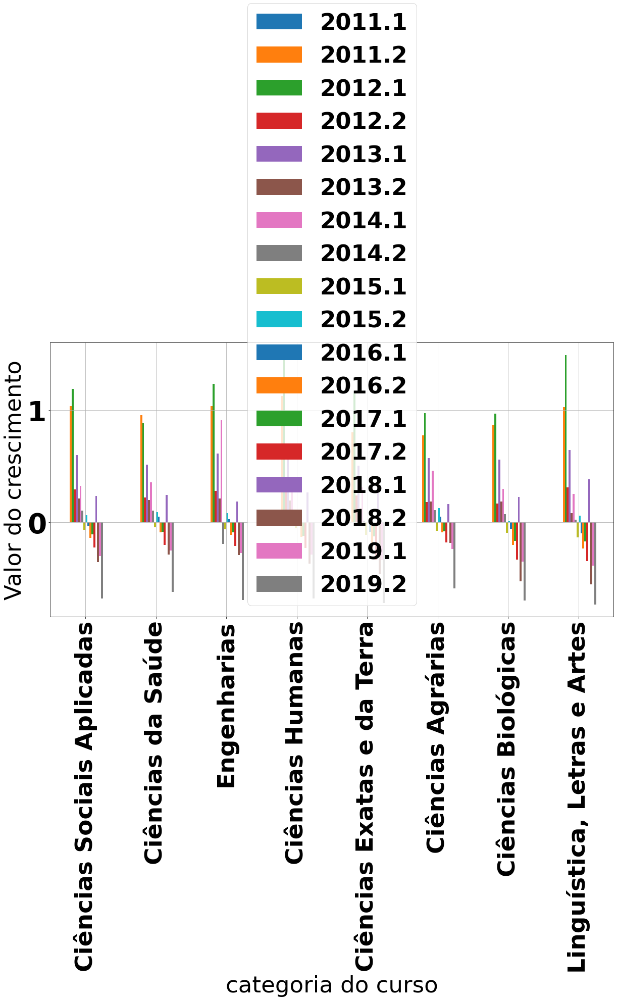

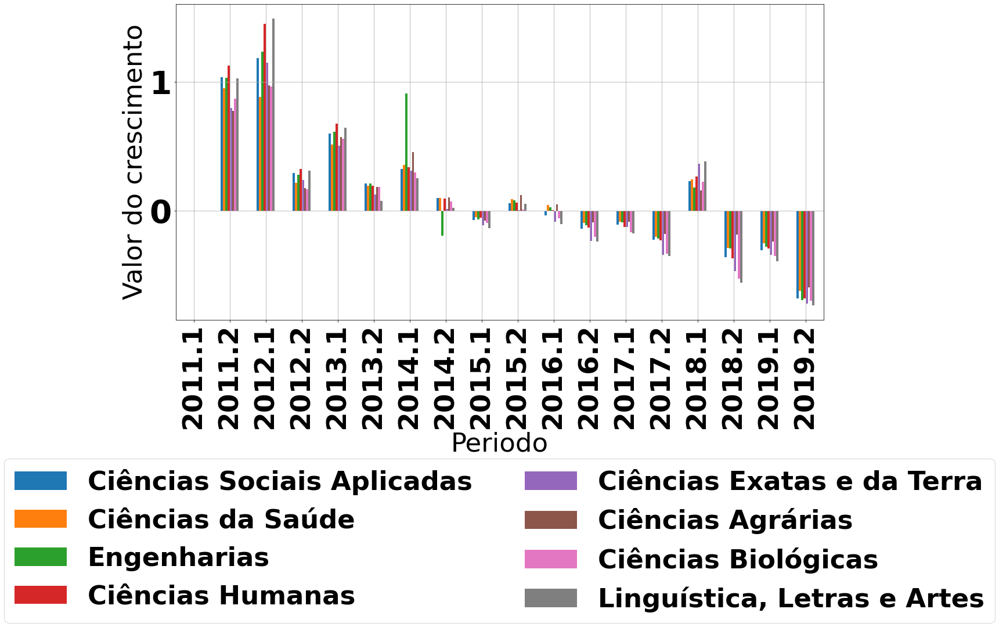

In [ ]:
graficoPorCategoriaDeCursoVsPeriodoCrescimento = dfPorCategoriaDeCursoPorSemestrePorcentagemCrescimento.plot.bar( grid=True, figsize= (20,10),
xlabel ="categoria do curso" ,ylabel= "Valor do crescimento")

graficoPorPeriodoVsPorCategoriaDeCursoCrescimento = dfPorCategoriaDeCursoPorSemestrePorcentagemCrescimentoTransposta.plot.bar( 
grid=True, figsize= (20,10), xlabel ="Periodo" ,ylabel= "Valor do crescimento" ).legend(loc='center',ncol=2,bbox_to_anchor=(0.5, -0.7));


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f40509211c0>,
      dtype=object)

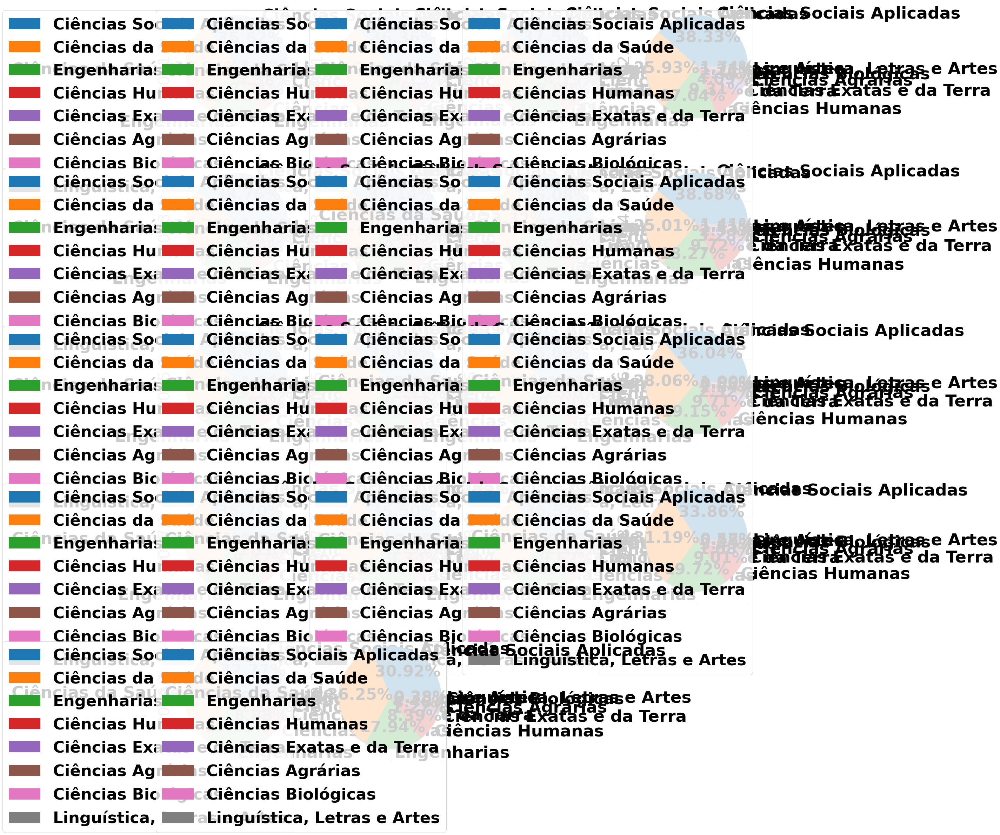

In [ ]:
dfPorCategoriaDeCursoPorSemestre.plot.pie(subplots=True, layout=(5,4), figsize=(30,40), shadow=True, autopct='%1.2f%%')

In [ ]:
dfPorCategoriaDeCursoPorSemestreTransposta.sum()

CATEGORIA DO CURSO
Ciências Sociais Aplicadas     5667346
Ciências da Saúde              4157996
Engenharias                    2917353
Ciências Humanas               1462594
Ciências Exatas e da Terra      437309
Ciências Agrárias               419436
Ciências Biológicas             145547
Linguística, Letras e Artes     183933
dtype: int64

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f404fe7e550>,
      dtype=object)

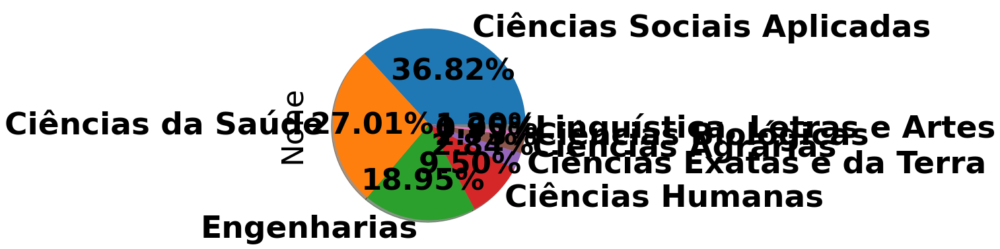

In [ ]:
dfPorCategoriaDeCursoPorSemestreTransposta.sum().plot.pie(subplots=True, layout=(5,4), figsize=(30,40), shadow=True, autopct='%1.2f%%')

##Por instituição

Analise das 5 instituições com mais estudantes por período

2011.1:

PONTIFÍCIA UNIVERSIDADE CATÓLICA DE MINAS GERAIS                 2929

UNIVERSIDADE PAULISTA                                            2222

UNIVERSIDADE ESTÁCIO DE SÁ                                       2062

UNIVERSIDADE DE CUIABÁ                                           1900

UNIVERSIDADE REGIONAL INTEGRADA DO ALTO URUGUAI E DAS MISSÕES    1757


2011.2:

UNIVERSIDADE DE CUIABÁ                                           4878

PONTIFÍCIA UNIVERSIDADE CATÓLICA DE MINAS GERAIS                 4733

UNIVERSIDADE ESTÁCIO DE SÁ                                       4099

UNIVERSIDADE PAULISTA                                            3960

UNIVERSIDADE DE FORTALEZA                                        3201

—-------------------------------------------------------------------------------------------------------------------

2012.1:

UNIVERSIDADE PAULISTA                                        11862

UNIVERSIDADE ESTÁCIO DE SÁ                                    8787

UNIVERSIDADE DE CUIABÁ                                        8252

PONTIFÍCIA UNIVERSIDADE CATÓLICA DE MINAS GERAIS              5558

Centro Universitário Estácio do Ceará                         4880

2012.2:

UNIVERSIDADE PAULISTA                                14153

UNIVERSIDADE ESTÁCIO DE SÁ                           12916

UNIVERSIDADE DE CUIABÁ                                9081

Centro Universitário Estácio do Ceará                 7187

PONTIFÍCIA UNIVERSIDADE CATÓLICA DE MINAS GERAIS      6368

—-------------------------------------------------------------------------------------------------------------------
		
2013.1:

UNIVERSIDADE PAULISTA                             28768

UNIVERSIDADE ESTÁCIO DE SÁ                        20199

UNIVERSIDADE DE CUIABÁ                            12114

Centro Universitário Estácio do Ceará             11093

FACULDADES INTEGRADAS PAULISTA                    10711

2013.2:

UNIVERSIDADE PAULISTA                      38868

UNIVERSIDADE ESTÁCIO DE SÁ                 27096

Centro Universitário Estácio do Ceará      13836

UNIVERSIDADE DE CUIABÁ                     13640

CENTRO UNIVERSITÁRIO UNA                    9826

—-------------------------------------------------------------------------------------------------------------------

2014.1:

UNIVERSIDADE PAULISTA                                 56190

UNIVERSIDADE ESTÁCIO DE SÁ                            39818

Centro Universitário Estácio do Ceará                 18476

UNIVERSIDADE DE CUIABÁ                                15677

UNIVERSIDADE NOVE DE JULHO                            15234

2014.2:

UNIVERSIDADE PAULISTA                       62891

UNIVERSIDADE ESTÁCIO DE SÁ                  44762

Centro Universitário Estácio do Ceará       19536

UNIVERSIDADE NOVE DE JULHO                  17009

UNIVERSIDADE DE CUIABÁ                      16084

—-------------------------------------------------------------------------------------------------------------------

2015.1:

UNIVERSIDADE PAULISTA                          73046

UNIVERSIDADE ESTÁCIO DE SÁ                     52410

Centro Universitário Estácio do Ceará          22273

UNIVERSIDADE NOVE DE JULHO                     18661

UNIVERSIDADE DE CUIABÁ                         17488

2015.2:

UNIVERSIDADE PAULISTA                                         69976

UNIVERSIDADE ESTÁCIO DE SÁ                                    52404

Centro Universitário Estácio do Ceará                         22139

UNIVERSIDADE NOVE DE JULHO                                    20573

UNIVERSIDADE DE CUIABÁ                                        15052

—-------------------------------------------------------------------------------------------------------------------


2016.1:

UNIVERSIDADE PAULISTA                                            68419

UNIVERSIDADE ESTÁCIO DE SÁ                                       45962

Centro Universitário Estácio do Ceará                            18202

UNIVERSIDADE NOVE DE JULHO                                       17250

UNIVERSIDADE DE CUIABÁ                                           14137

2016.2:

UNIVERSIDADE PAULISTA                                            59815

UNIVERSIDADE ESTÁCIO DE SÁ                                       38431

UNIVERSIDADE NOVE DE JULHO                                       15135

Centro Universitário Estácio do Ceará                            14900

UNIVERSIDADE DE CUIABÁ                                           10830

—-------------------------------------------------------------------------------------------------------------------

2017.1:

UNIVERSIDADE PAULISTA                                     49065

UNIVERSIDADE ESTÁCIO DE SÁ                                37084

Centro Universitário Estácio do Ceará                     14147

UNIVERSIDADE NOVE DE JULHO                                12479

UNIVERSIDADE DE CUIABÁ                                    11037

2017.2:

UNIVERSIDADE PAULISTA                                         69976

UNIVERSIDADE ESTÁCIO DE SÁ                                    52404

Centro Universitário Estácio do Ceará                         22139

UNIVERSIDADE NOVE DE JULHO                                    20573

UNIVERSIDADE DE CUIABÁ                                        15052

—-------------------------------------------------------------------------------------------------------------------

2018.1:

UNIVERSIDADE PAULISTA                        58055

UNIVERSIDADE ESTÁCIO DE SÁ                   44164

UNIVERSIDADE NOVE DE JULHO                   17624

Centro Universitário Estácio do Ceará        16926

UNIVERSIDADE DE CUIABÁ                       11680

2018.2:

UNIVERSIDADE PAULISTA                            28789

UNIVERSIDADE ESTÁCIO DE SÁ                       22546

Centro Universitário Estácio do Ceará             7464

UNIVERSIDADE NOVE DE JULHO                        6735

UNIVERSIDADE POTIGUAR                             5718

—-------------------------------------------------------------------------------------------------------------------


2019.1:

UNIVERSIDADE ESTÁCIO DE SÁ                          16488

UNIVERSIDADE PAULISTA                               16165

Centro Universitário Estácio do Ceará                5219

PONTIFÍCIA UNIVERSIDADE CATÓLICA DE MINAS GERAIS     4129

UNIVERSIDADE POTIGUAR                                4050

2019.2:

UNIVERSIDADE PAULISTA                                            2896

UNIVERSIDADE TIRADENTES                                          2691

UNIVERSIDADE DE CUIABÁ                                           1713

UNIVERSIDADE REGIONAL INTEGRADA DO ALTO URUGUAI E DAS MISSÕES    1679

FACULDADE PITÁGORAS DE SÃO LUIZ                                  1538



Podemos observar a repetição de várais Instituições ao decorrer do tempo, similarmente a situação de curso e municipio, tais como UNIVERSIDADE PAULISTA, PONTIFÍCIA UNIVERSIDADE CATÓLICA DE MINAS GERAIS, UNIVERSIDADE ESTÁCIO DE SÁ e Centro Universitário Estácio do Ceará. Como na situação por municipio, as instituições fazem sentido prático, já que são instituições em locais com população elevada. Outro ponto interssante é que de 2012 a 2018, a UNIVERSIDADE PAULISTA foi a instituição com mais alunos no FIES, mas perdeu o posto em 2019. De qualquer forma, aparenta ter ua divisão bem espalhada de alunos, com as posições de intituição com mais alunos e a quantidade de instituições passando por pequenas mudanças.

##Por tipo do curso

In [ ]:
dataPorTipoDeCursoPorSemestre = {'Tipo do curso superior': ['BACHARELADO', 'LICENCIATURA', 'TECNOLOGO', 'SEQUENCIAL', 
                                                            'B/LP'],
         '2011.1': [82542, 6546, 3806, 48, 0],
         '2011.2': [162412, 13958, 9051, 13, 1],
         '2012.1': [334563, 34936, 23104, 3, 0],
         '2012.2': [420858, 45574, 30678, 1, 0],
         '2013.1': [659041, 76316, 51398, 1, 0],
         '2013.2': [795101, 86534, 61805, 0, 0],
         '2014.1': [1081413, 110288, 81698, 14, 0],
         '2014.2': [1190506, 115995, 87616, 9, 0],
         '2015.1': [1120220, 104016, 79757, 0, 0],
         '2015.2': [1217973, 107146, 71971, 1, 0],
         '2016.1': [1243205, 98811, 57357, 1, 0],
         '2016.2': [1111925, 78114, 36566, 0, 0],
         '2017.1': [1011032, 61383, 30063, 0, 0],
         '2017.2': [802025, 41658, 15812, 0, 0],
         '2018.1': [971206, 55677, 30279, 0, 0],
         '2018.2': [679458, 21809, 10424, 0, 0],
         '2019.1': [493033, 12772, 6074, 0, 0],
         '2019.2': [167281, 3874, 1437, 0, 0],
         }

In [ ]:
dfTipoDeCursoPorSemestre = pd.DataFrame(dataPorTipoDeCursoPorSemestre)
dfTipoDeCursoPorSemestre.set_index('Tipo do curso superior', inplace=True)
dfTipoDeCursoPorSemestre

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
Tipo do curso superior,,,,,,,,,,,,,,,,,,
BACHARELADO,82542,162412,334563,420858,659041,795101,1081413,1190506,1120220,1217973,1243205,1111925,1011032,802025,971206,679458,493033,167281
LICENCIATURA,6546,13958,34936,45574,76316,86534,110288,115995,104016,107146,98811,78114,61383,41658,55677,21809,12772,3874
TECNOLOGO,3806,9051,23104,30678,51398,61805,81698,87616,79757,71971,57357,36566,30063,15812,30279,10424,6074,1437
SEQUENCIAL,48,13,3,1,1,0,14,9,0,1,1,0,0,0,0,0,0,0
B/LP,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
dfTipoDeCursoPorSemestreTransposta = dfTipoDeCursoPorSemestre.T
dfTipoDeCursoPorSemestreTransposta

Tipo do curso superior,BACHARELADO,LICENCIATURA,TECNOLOGO,SEQUENCIAL,B/LP
2011.1,82542,6546,3806,48,0
2011.2,162412,13958,9051,13,1
2012.1,334563,34936,23104,3,0
2012.2,420858,45574,30678,1,0
2013.1,659041,76316,51398,1,0
2013.2,795101,86534,61805,0,0
2014.1,1081413,110288,81698,14,0
2014.2,1190506,115995,87616,9,0
2015.1,1120220,104016,79757,0,0
2015.2,1217973,107146,71971,1,0


In [ ]:
totaisTipoDeCursoPorSemestre = dfTipoDeCursoPorSemestre.sum(0, numeric_only=True)
totaisTipoDeCursoPorSemestre

2011.1      92942
2011.2     185435
2012.1     392606
2012.2     497111
2013.1     786756
2013.2     943440
2014.1    1273413
2014.2    1394126
2015.1    1303993
2015.2    1397091
2016.1    1399374
2016.2    1226605
2017.1    1102478
2017.2     859495
2018.1    1057162
2018.2     711691
2019.1     511879
2019.2     172592
dtype: int64

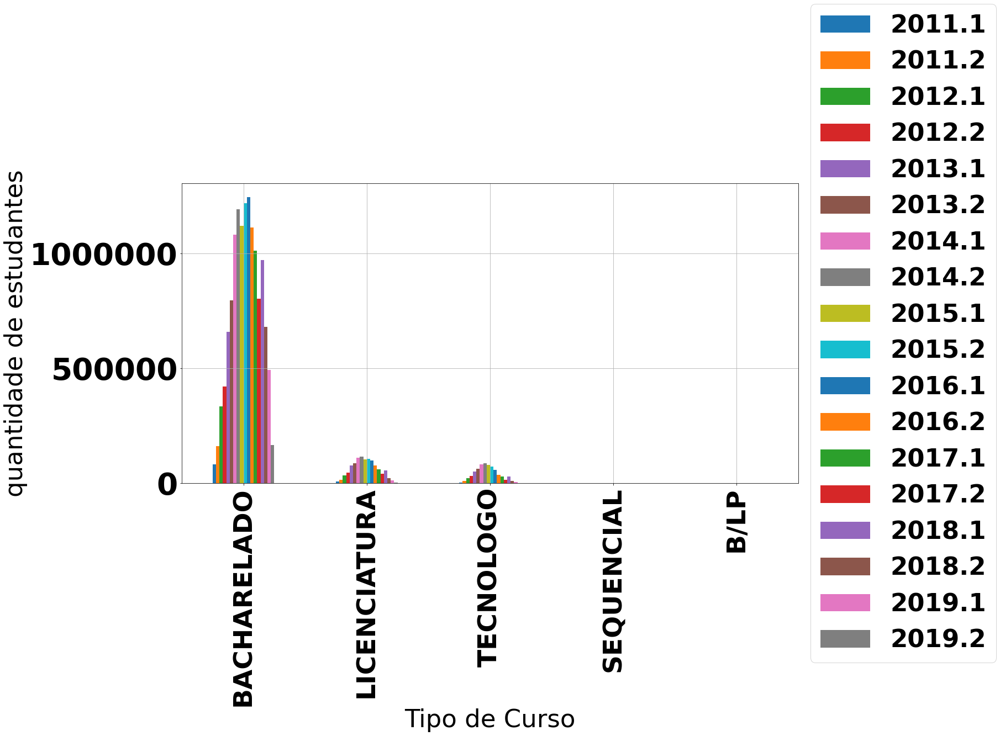

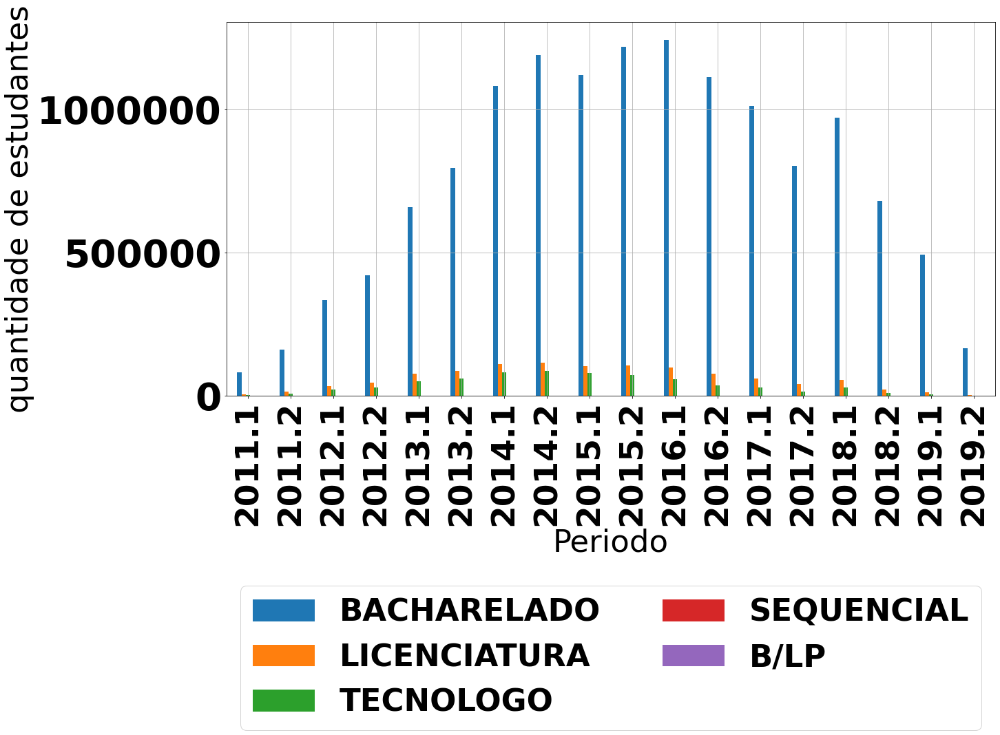

In [ ]:
graficoTipoDeCursoVsPeriodo = dfTipoDeCursoPorSemestre.plot.bar( grid=True, figsize= (20,10),
xlabel ="Tipo de Curso" ,ylabel= "quantidade de estudantes").legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

graficoPorPeriodoVsPRaca = dfTipoDeCursoPorSemestreTransposta.plot.bar( grid=True, figsize= (20,10),
xlabel ="Periodo" ,ylabel= "quantidade de estudantes").legend(loc='center',ncol=2,bbox_to_anchor=(0.5, -0.7));

In [ ]:
dfTipoDeCursoPorcentagemCrescimento = dfTipoDeCursoPorSemestre[['2011.1','2011.2',
'2012.1','2012.2','2013.1','2013.2','2014.1','2014.2','2015.1','2015.2','2016.1','2016.2','2017.1','2017.2',
'2018.1','2018.2','2019.1','2019.2']].pct_change(periods = 1, axis = 1)
dfTipoDeCursoPorcentagemCrescimento

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
Tipo do curso superior,,,,,,,,,,,,,,,,,,
BACHARELADO,NaN,0.9676286012,1.0599647809,0.2579334834,0.5659462336,0.2064514954,0.3600951326,0.1008800523,-0.0590387617,0.0872623235,0.0207163870,-0.1055980309,-0.0907372350,-0.2067263944,0.2109423023,-0.3003976499,-0.2743731033,-0.6607103378
LICENCIATURA,NaN,1.1322945310,1.5029373836,0.3044996565,0.6745512792,0.1338906651,0.2745048189,0.0517463369,-0.1032716927,0.0300915244,-0.0777910515,-0.2094604852,-0.2141869575,-0.3213430429,0.3365259974,-0.6082942687,-0.4143702141,-0.6966802380
TECNOLOGO,NaN,1.3780872307,1.5526461165,0.3278220222,0.6754025686,0.2024786957,0.3218671629,0.0724375138,-0.0896982286,-0.0976215254,-0.2030540079,-0.3624840909,-0.1778428048,-0.4740378538,0.9149380218,-0.6557349979,-0.4173062164,-0.7634178466
SEQUENCIAL,NaN,-0.7291666667,-0.7692307692,-0.6666666667,0.0000000000,-1.0000000000,inf,-0.3571428571,-1.0000000000,inf,0.0000000000,-1.0000000000,NaN,NaN,NaN,NaN,NaN,NaN
B/LP,NaN,inf,-1.0000000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
dfTipoDeCursoPorcentagemCrescimentoTransposta = dfTipoDeCursoPorcentagemCrescimento.T
dfTipoDeCursoPorcentagemCrescimentoTransposta

Tipo do curso superior,BACHARELADO,LICENCIATURA,TECNOLOGO,SEQUENCIAL,B/LP
2011.1,NaN,NaN,NaN,NaN,NaN
2011.2,0.9676286012,1.1322945310,1.3780872307,-0.7291666667,inf
2012.1,1.0599647809,1.5029373836,1.5526461165,-0.7692307692,-1.0000000000
2012.2,0.2579334834,0.3044996565,0.3278220222,-0.6666666667,NaN
2013.1,0.5659462336,0.6745512792,0.6754025686,0.0000000000,NaN
2013.2,0.2064514954,0.1338906651,0.2024786957,-1.0000000000,NaN
2014.1,0.3600951326,0.2745048189,0.3218671629,inf,NaN
2014.2,0.1008800523,0.0517463369,0.0724375138,-0.3571428571,NaN
2015.1,-0.0590387617,-0.1032716927,-0.0896982286,-1.0000000000,NaN
2015.2,0.0872623235,0.0300915244,-0.0976215254,inf,NaN


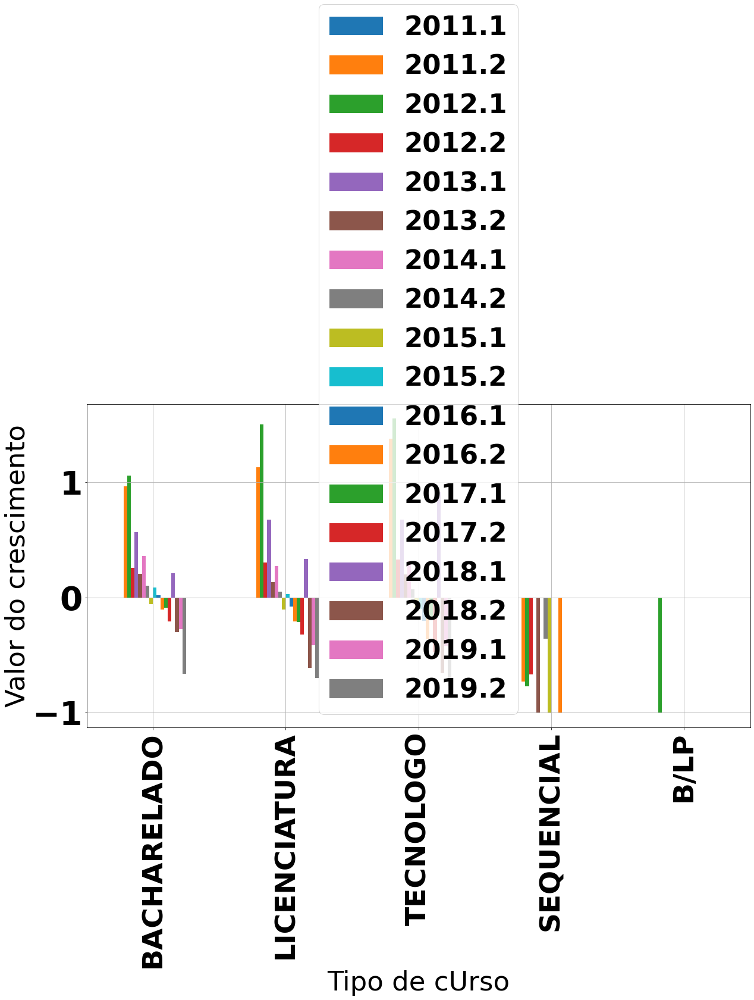

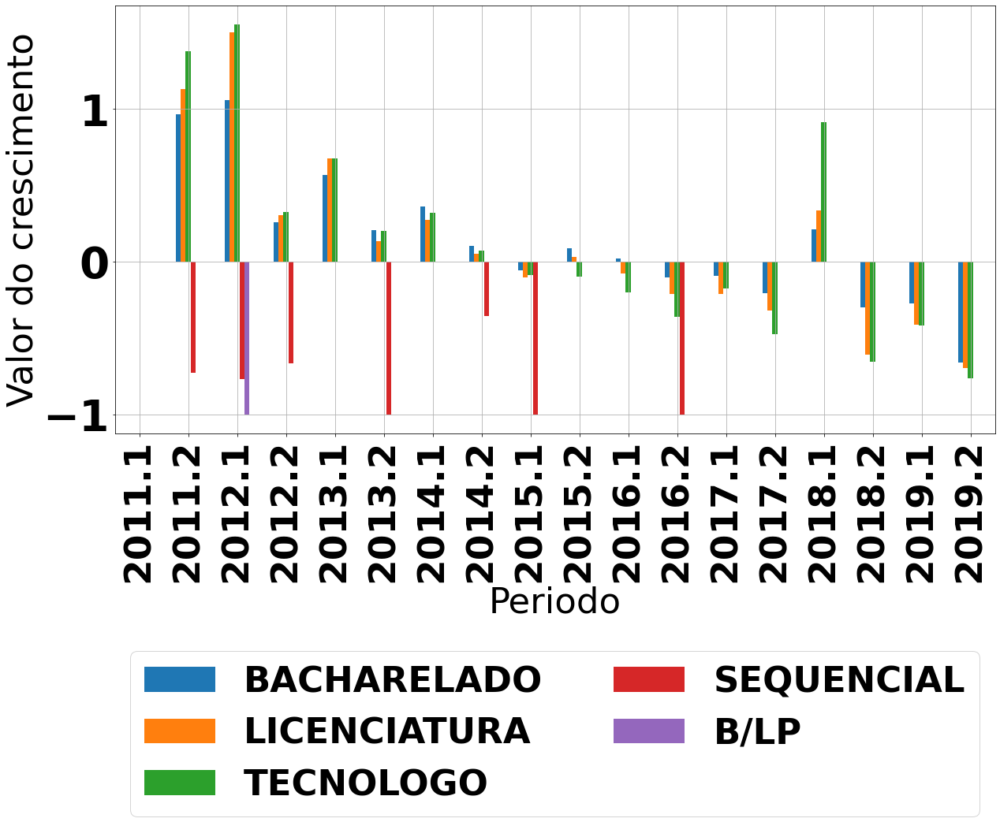

In [ ]:
graficoPorTipoDeCursoVsPeriodoCrescimento = dfTipoDeCursoPorcentagemCrescimento.plot.bar( grid=True, figsize= (20,10),
xlabel ="Tipo de cUrso" ,ylabel= "Valor do crescimento")

graficoPorPeriodoVsTipoDeCursoCrescimento = dfTipoDeCursoPorcentagemCrescimentoTransposta.plot.bar(
grid=True, figsize= (20,10), xlabel ="Periodo" ,ylabel= "Valor do crescimento" ).legend(loc='center',ncol=2,bbox_to_anchor=(0.5, -0.7));

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f404f5dc130>,
      dtype=object)

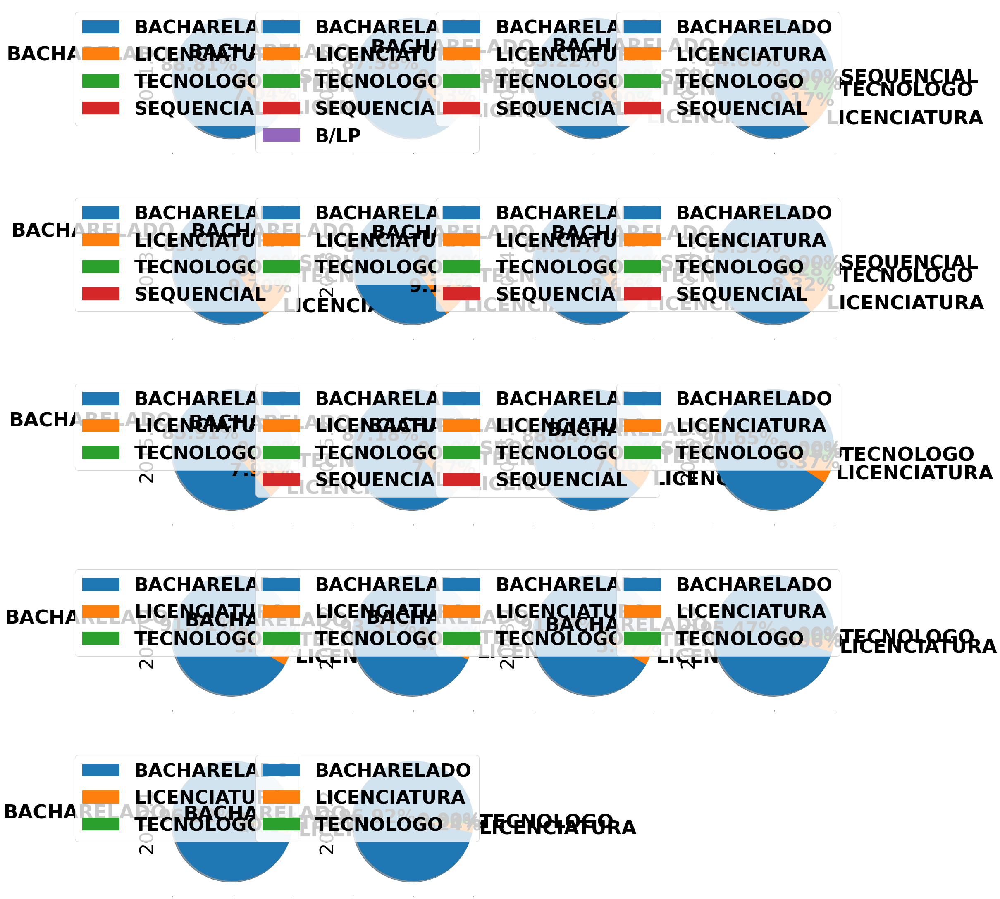

In [ ]:
dfTipoDeCursoPorSemestre.plot.pie(subplots=True, layout=(5,4), figsize=(30,40), shadow=True, autopct='%1.2f%%')

#Grupo 3:

##Por periodicidade dos pagamentos (utilizando a métrica com valores repetidos)

pagamentos 2011.1: 

por ano:

2011    514062 /
2010     62052

por semestre:

1    514104 /
2     62010


pagamentos 2011.2:

por ano:

2011    1539913 /
2010      66522

por semestre:

2    1178821 /
1     427614


pagamentos 2012.1:

por ano:

2012    2284254 /
2011     237308 /
2010       8148

por semestre:

1    2330700 /
2     199010


pagamentos 2012.2:

por ano:

2011    1539913 /
2010      66522

por semestre:

2    1178821 /
1     427614


pagamentos 2013.1:

por ano:

2013    4631173 /
2012     238950 /
2011      19362 /
2010        978 /
2009         78 /
2008         60 /
2007         12

por semestre:

1    4665451 /
2     225162


pagamentos 2013.2:

por ano:

2013    5791012 /
2012      79482 / 
2011      17256 /
2010       1038

por semestre:

2    5608422 /
1     280366


pagamentos 2014.1:

por ano:

2014    7447934 /
2013     327283 /
2012      49963 /
2011      16650 /
2010        972

por semestre:

1    7537444 /
2     305358


pagamentos 2014.2:

por ano:

2014    8194704 /
2013      68548 /
2012       7249 /
2011       1176 /
2010        144

por semestre:

2    7732015 /
1     539806


pagamentos 2015.1:

por ano:

2015    5113747 /
2014     805642 /
2013       8868 /
2012       3712 /
2011       2268 /
2010        192

por semestre:

1    5138991 /
2     795438


pagamentos 2015.2:

por ano:

2015    8473981 /
2014      37184 /
2013       6945 /
2012       3114 /
2011       1014 /
2010        768

por semestre:

2    5024222 /
1    3498784


pagamentos 2016.1:

por ano:

2016    8235847 /
2015    1183109 /
2014      12608 /
2013       5035 /
2012       3011 /
2011       1242 /
2010        222

por semestre:

1    8616287 /
2     824787


pagamentos 2016.2:

por ano:

2016    2205569 /
2015       7200 /
2014        834 /
2013        192 /
2012        126 /
2011         30 /
2010          6

por semestre:

2    2206679 /
1       7278


pagamentos 2017.1:

por ano:

2017    7084213 /
2015     694647 /
2016     286377 /
2014       4011 /
2013       1265 /
2012        732 /
2011        498 /
2010        168

por semestre:

1    7163968 /
2     907943


pagamentos 2017.2:

por ano:

2017    5272069 /
2015     384442 /
2016      30197 /
2014      22720 /
2013       1451 /
2012        618 /
2011        420 /
2010        108

por semestre:

2    5538906 /
1     173119


pagamentos 2018.1:

por ano:

2018    5094012 /
2015    1767110 /
2017      79283 /
2016       7856 / 
2014       7585 /
2013       1483 /
2012        804 /
2011        312 /
2010         24

por semestre:

1    5171538 /
2    1786931


pagamentos 2018.2:

por ano:

2018    3617671 /
2017       9998 /
2015       4811 /
2016       2925 /
2014        606 /
2013        285 /
2012        120 /
2011         42 /
2010          6

por semestre:

2    3519338 /
1     117126


pagamentos 2019.1:

por ano:

2019    3007762 /
2018      55579 /
2015      20333 /
2017       6408 /
2016       3009 /
2014       2046 /
2013        461 /
2012        201 /
2011         90 /
2010         18

por semestre:

1    3034076 /
2      61831


pagamentos 2019.2:

por ano:

2019    528270 /
2018      9233 /
2011      4830 /
2012      4164 /
2010      2496 /
2017      1713 /
2013      1001 /
2015       690 /
2016       666 /
2014       629 /

por semestre:

2    503786 /
1     49906


##Percentual pedido vs percentual recebido

2011.1
percentual pedido e recebido batem

2011.2
percentual pedido e recebido batem

2012.1
percentual pedido e recebido batem

2012.2
percentual pedido e recebido batem

2013.1
percentual pedido e recebido batem

2013.2
percentual pedido e recebido batem

2014.1
percentual pedido e recebido batem

2014.2
percentual pedido e recebido batem

2015.1
percentual pedido e recebido batem

2015.2
percentual pedido e recebido batem

2016.1
percentual pedido e recebido batem

2016.2
percentual pedido e recebido batem

2017.1
percentual pedido e recebido batem

2017.2
percentual pedido e recebido batem

2018.1
percentual pedido e recebido batem

2018.2
percentual pedido e recebido batem

2019.1
percentual pedido e recebido batem

2019.2
percentual pedido e recebido batem


##Por agente financeiro

In [ ]:
dataPorAgenteFinanceiro = {'agente financeiro': ['Caixa Economica Federal', 'Banco do Brasil'],
         '2011.1': [77214, 15728],
         '2011.2': [142086, 43349],
         '2012.1': [243024, 149582],
         '2012.2': [294804, 202307],
         '2013.1': [436676, 350080],
         '2013.2': [523862, 419578],
         '2014.1': [699920, 573493],
         '2014.2': [778600, 615526],
         '2015.1': [724733, 579260],
         '2015.2': [775186, 621905],
         '2016.1': [782775, 616599],
         '2016.2': [688588, 538017],
         '2017.1': [626232, 476246],
         '2017.2': [483654, 375841],
         '2018.1': [635011, 422151],
         '2018.2': [429714, 281977],
         '2019.1': [316847, 195032],
         '2019.2': [103543, 69049],
         }

In [ ]:
dfPorAgenteFinanceiroPorSemestre = pd.DataFrame(dataPorAgenteFinanceiro)
dfPorAgenteFinanceiroPorSemestre.set_index('agente financeiro', inplace=True)
dfPorAgenteFinanceiroPorSemestre

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
agente financeiro,,,,,,,,,,,,,,,,,,
Caixa Economica Federal,77214,142086,243024,294804,436676,523862,699920,778600,724733,775186,782775,688588,626232,483654,635011,429714,316847,103543
Banco do Brasil,15728,43349,149582,202307,350080,419578,573493,615526,579260,621905,616599,538017,476246,375841,422151,281977,195032,69049


In [ ]:
dfPorAgenteFinanceiroPorSemestreTransposta = dfPorAgenteFinanceiroPorSemestre.T
dfPorAgenteFinanceiroPorSemestreTransposta

agente financeiro,Caixa Economica Federal,Banco do Brasil
2011.1,77214,15728
2011.2,142086,43349
2012.1,243024,149582
2012.2,294804,202307
2013.1,436676,350080
2013.2,523862,419578
2014.1,699920,573493
2014.2,778600,615526
2015.1,724733,579260
2015.2,775186,621905


In [ ]:
totaisPorAgenteFinanceiroPorSemestre = dfPorAgenteFinanceiroPorSemestre.sum(0, numeric_only=True)
totaisPorAgenteFinanceiroPorSemestre

2011.1      92942
2011.2     185435
2012.1     392606
2012.2     497111
2013.1     786756
2013.2     943440
2014.1    1273413
2014.2    1394126
2015.1    1303993
2015.2    1397091
2016.1    1399374
2016.2    1226605
2017.1    1102478
2017.2     859495
2018.1    1057162
2018.2     711691
2019.1     511879
2019.2     172592
dtype: int64

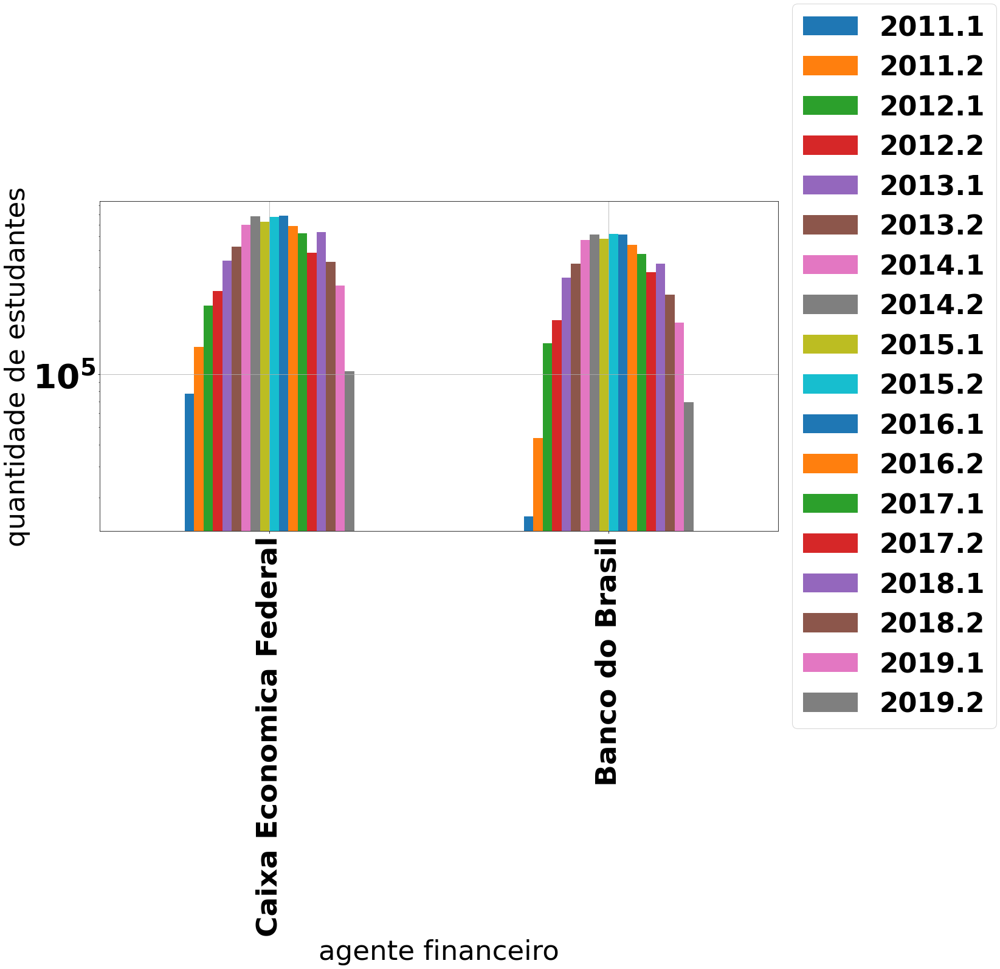

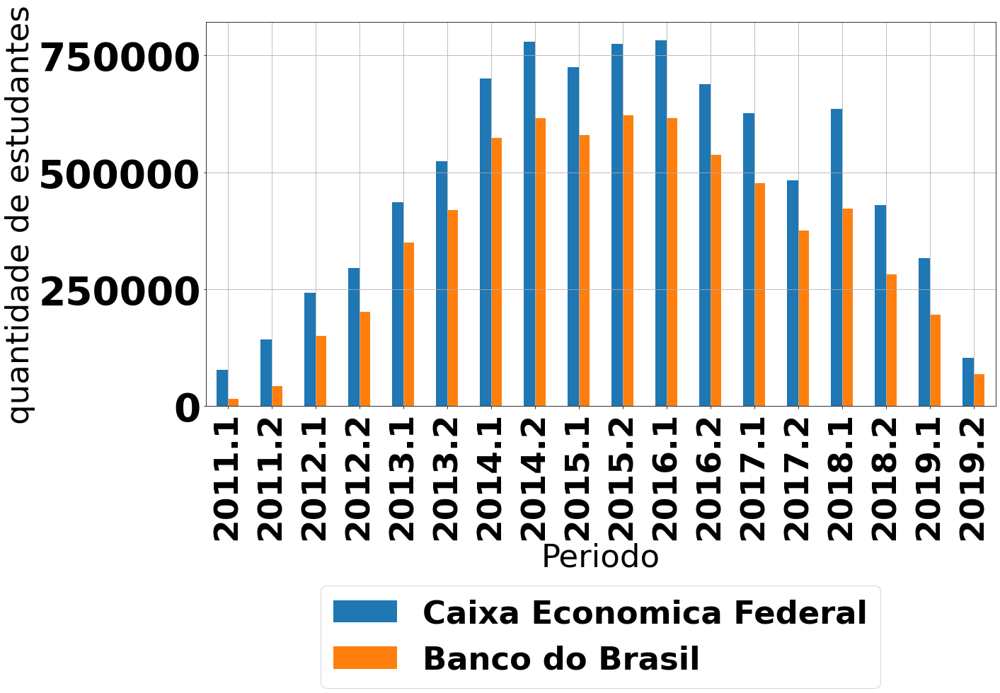

In [ ]:
graficoPorAgenteFinanceiroVsPeriodo = dfPorAgenteFinanceiroPorSemestre.plot.bar( grid=True, figsize= (20,10),
xlabel ="agente financeiro" ,ylabel= "quantidade de estudantes", logy=True).legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

graficoPorPeriodoVsPorAgenteFinanceiro = dfPorAgenteFinanceiroPorSemestreTransposta.plot.bar(grid=True, figsize= (20,10),
xlabel ="Periodo" ,ylabel= "quantidade de estudantes").legend(loc='center',bbox_to_anchor=(0.5, -0.6));

In [ ]:
dfPorAgenteFinanceiroPorcentagemCrescimento = dfPorAgenteFinanceiroPorSemestre[['2011.1','2011.2',
'2012.1','2012.2','2013.1','2013.2','2014.1','2014.2','2015.1','2015.2','2016.1','2016.2','2017.1','2017.2',
'2018.1','2018.2','2019.1','2019.2']].pct_change(periods = 1, axis = 1)
dfPorAgenteFinanceiroPorcentagemCrescimento

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
agente financeiro,,,,,,,,,,,,,,,,,,
Caixa Economica Federal,NaN,0.8401585205,0.7104007432,0.2130653763,0.4812417742,0.1996583279,0.3360770585,0.1124128472,-0.0691844336,0.0696159827,0.0097899085,-0.1203244866,-0.0905563269,-0.2276760051,0.3129447911,-0.3232967618,-0.2626560922,-0.6732082046
Banco do Brasil,NaN,1.7561673449,2.4506447669,0.3524822505,0.7304393817,0.1985203382,0.3668328654,0.0732929609,-0.0589187134,0.0736197908,-0.0085318497,-0.1274442547,-0.1148123572,-0.2108259177,0.1232169987,-0.3320470637,-0.3083407512,-0.6459606629


In [ ]:
dfPorAgenteFinanceiroPorcentagemCrescimentoTransposta = dfPorAgenteFinanceiroPorcentagemCrescimento.T
dfPorAgenteFinanceiroPorcentagemCrescimentoTransposta

agente financeiro,Caixa Economica Federal,Banco do Brasil
2011.1,NaN,NaN
2011.2,0.8401585205,1.7561673449
2012.1,0.7104007432,2.4506447669
2012.2,0.2130653763,0.3524822505
2013.1,0.4812417742,0.7304393817
2013.2,0.1996583279,0.1985203382
2014.1,0.3360770585,0.3668328654
2014.2,0.1124128472,0.0732929609
2015.1,-0.0691844336,-0.0589187134
2015.2,0.0696159827,0.0736197908


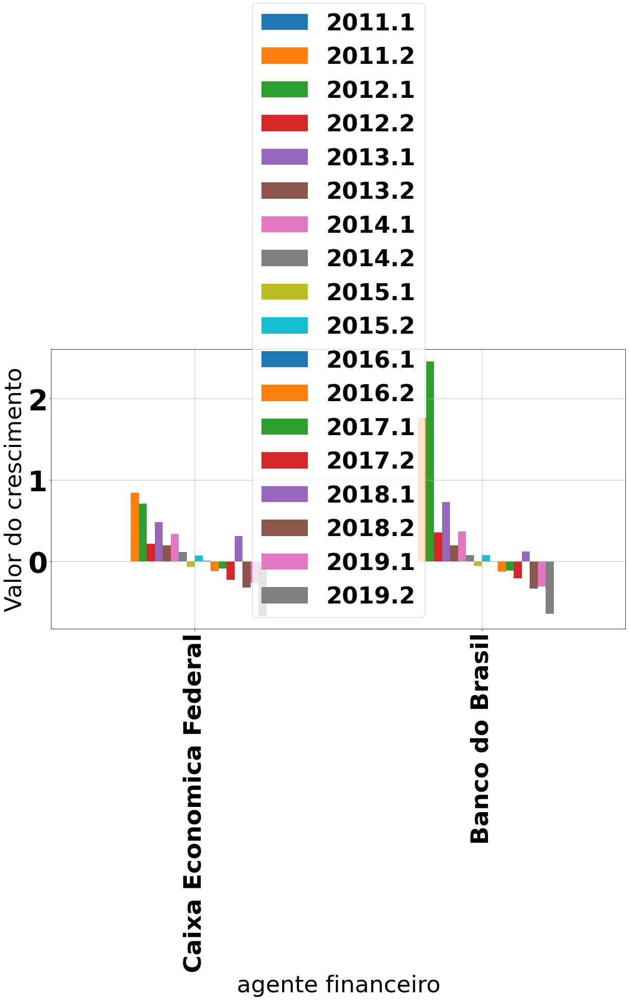

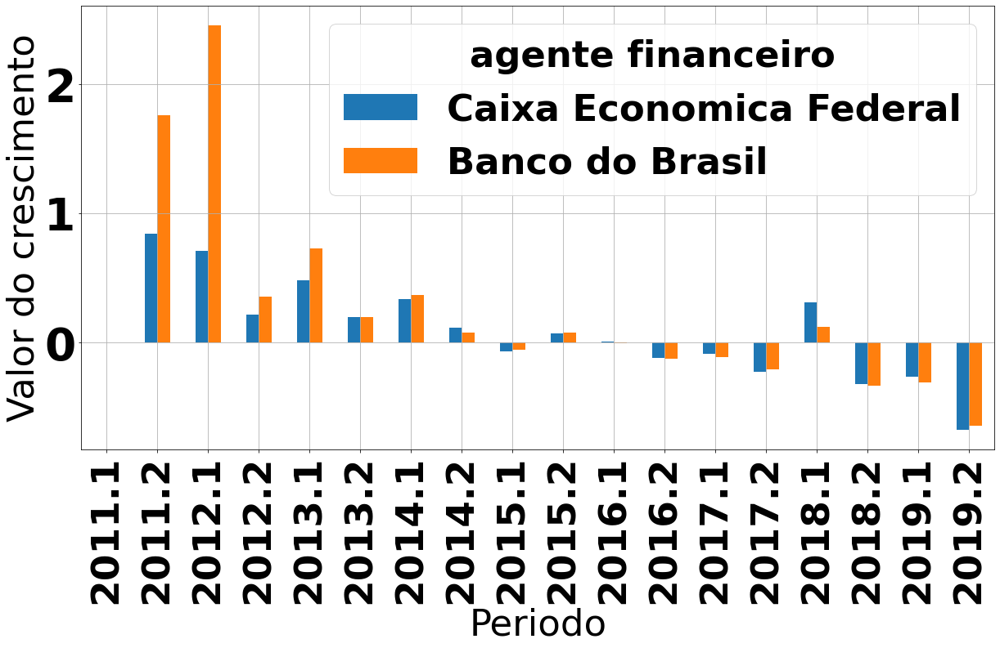

In [ ]:
graficoPorAgenteFinanceiroVsPeriodoCrescimento = dfPorAgenteFinanceiroPorcentagemCrescimento.plot.bar( grid=True, figsize= (20,10),
xlabel ="agente financeiro" ,ylabel= "Valor do crescimento")

graficoPorPeriodoVsPorAgenteFinanceiroCrescimento = dfPorAgenteFinanceiroPorcentagemCrescimentoTransposta.plot.bar( 
grid=True, figsize= (20,10), xlabel ="Periodo" ,ylabel= "Valor do crescimento" )

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f404ebd53a0>,
      dtype=object)

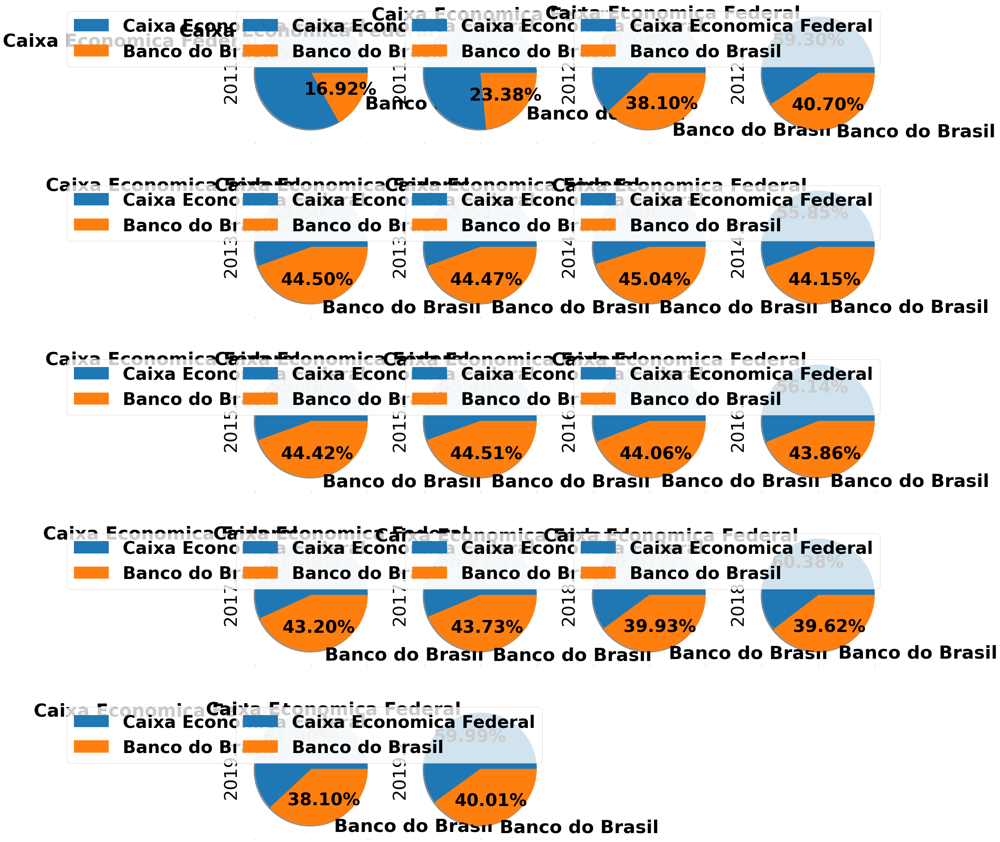

In [ ]:
dfPorAgenteFinanceiroPorSemestre.plot.pie(subplots=True, layout=(5,4), figsize=(30,40), shadow=True, autopct='%1.2f%%')

##Por tipo de financiamento

In [ ]:
dataPorTipoDeFinanciamento = {'Tipo de Financia contratada': ['NORMAL/CONVENCIONAL', 'FGEDUC', 'SOLIDARIA'],
         '2011.1': [74177, 16260, 2505],
         '2011.2': [135210, 44038, 6187],
         '2012.1': [231021, 152195, 9390],
         '2012.2': [263786, 223936, 9389],
         '2013.1': [354900, 419969, 11887],
         '2013.2': [405301, 525965, 12174],
         '2014.1': [480749, 778905, 13759],
         '2014.2': [491887, 888220, 14019],
         '2015.1': [380223, 910395, 13375],
         '2015.2': [448298, 936813, 11980],
         '2016.1': [417602, 970820, 10952],
         '2016.2': [341155, 876929, 8521],
         '2017.1': [299003, 795184, 8291],
         '2017.2': [227972, 626548, 4975],
         '2018.1': [230328, 819756, 7078],
         '2018.2': [155464, 552945, 3282],
         '2019.1': [97804, 411951, 2124],
         '2019.2': [33336, 138421, 835],
         }

In [ ]:
dfPorTipoDeFinanciamentoPorSemestre = pd.DataFrame(dataPorTipoDeFinanciamento)
dfPorTipoDeFinanciamentoPorSemestre.set_index('Tipo de Financia contratada', inplace=True)
dfPorTipoDeFinanciamentoPorSemestre

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
Tipo de Financia contratada,,,,,,,,,,,,,,,,,,
NORMAL/CONVENCIONAL,74177,135210,231021,263786,354900,405301,480749,491887,380223,448298,417602,341155,299003,227972,230328,155464,97804,33336
FGEDUC,16260,44038,152195,223936,419969,525965,778905,888220,910395,936813,970820,876929,795184,626548,819756,552945,411951,138421
SOLIDARIA,2505,6187,9390,9389,11887,12174,13759,14019,13375,11980,10952,8521,8291,4975,7078,3282,2124,835


In [ ]:
dfPorTipoDeFinanciamentoPorSemestreTransposta = dfPorTipoDeFinanciamentoPorSemestre.T
dfPorTipoDeFinanciamentoPorSemestreTransposta

Tipo de Financia contratada,NORMAL/CONVENCIONAL,FGEDUC,SOLIDARIA
2011.1,74177,16260,2505
2011.2,135210,44038,6187
2012.1,231021,152195,9390
2012.2,263786,223936,9389
2013.1,354900,419969,11887
2013.2,405301,525965,12174
2014.1,480749,778905,13759
2014.2,491887,888220,14019
2015.1,380223,910395,13375
2015.2,448298,936813,11980


In [ ]:
totaisPorTipoDeFinanciamentoPorSemestre = dfPorTipoDeFinanciamentoPorSemestre.sum(0, numeric_only=True)
totaisPorTipoDeFinanciamentoPorSemestre

2011.1      92942
2011.2     185435
2012.1     392606
2012.2     497111
2013.1     786756
2013.2     943440
2014.1    1273413
2014.2    1394126
2015.1    1303993
2015.2    1397091
2016.1    1399374
2016.2    1226605
2017.1    1102478
2017.2     859495
2018.1    1057162
2018.2     711691
2019.1     511879
2019.2     172592
dtype: int64

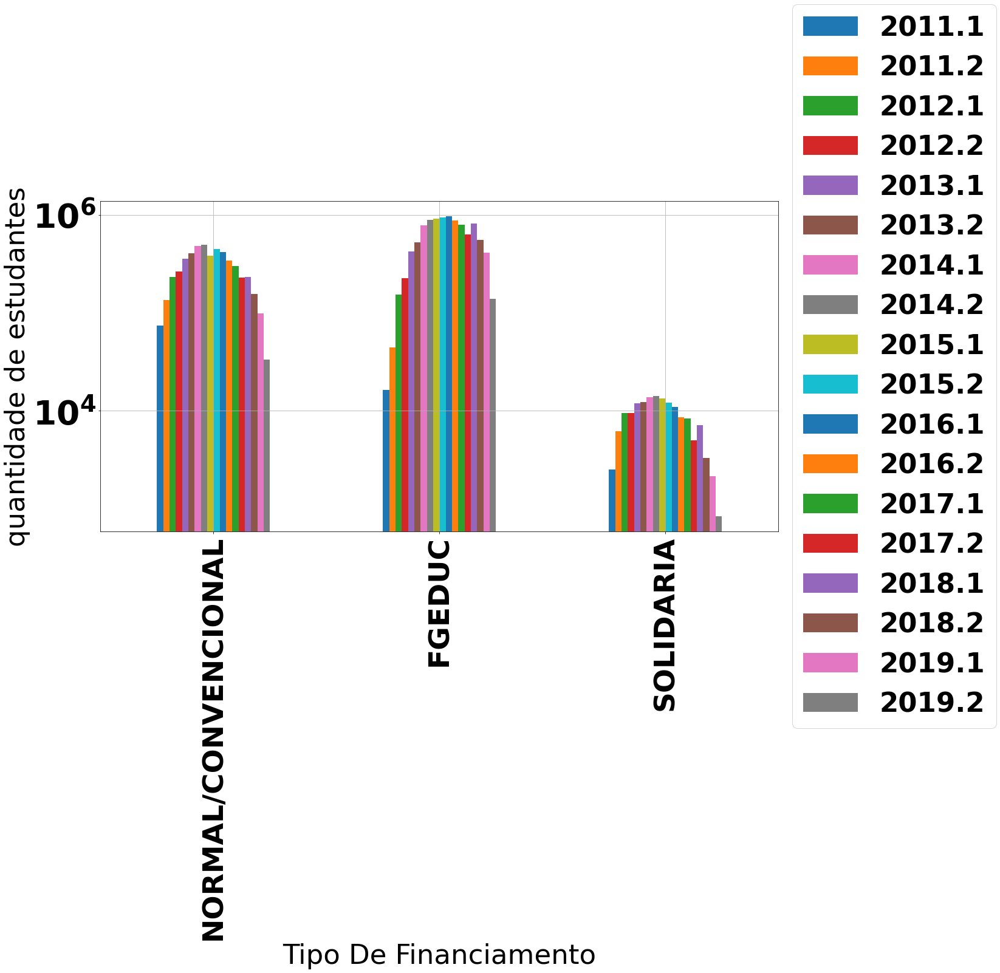

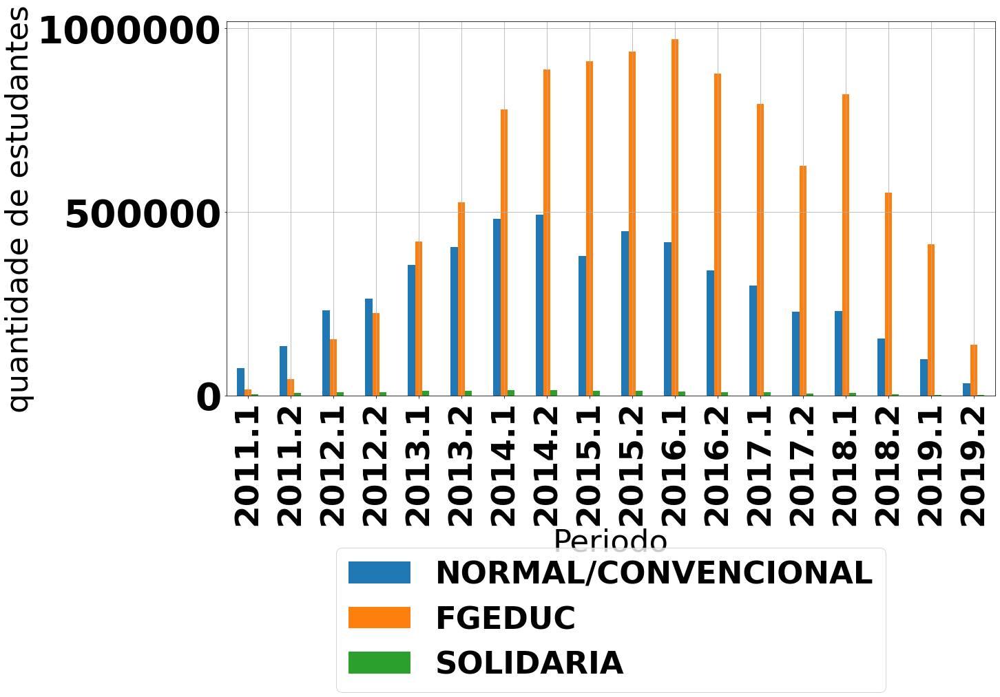

In [ ]:
graficoPorTipoDeFinanciamentoVsPeriodo = dfPorTipoDeFinanciamentoPorSemestre.plot.bar( grid=True, figsize= (20,10),
xlabel ="Tipo De Financiamento" ,ylabel= "quantidade de estudantes",  logy=True).legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

graficoPorPeriodoVsPorTipoDeFinanciamento = dfPorTipoDeFinanciamentoPorSemestreTransposta.plot.bar( grid=True, figsize= (20,10),
xlabel ="Periodo" ,ylabel= "quantidade de estudantes").legend(loc='center',bbox_to_anchor=(0.5, -0.6));

In [ ]:
dfPorTipoDeFinanciamentoPorcentagemCrescimento = dfPorTipoDeFinanciamentoPorSemestre[['2011.1','2011.2',
'2012.1','2012.2','2013.1','2013.2','2014.1','2014.2','2015.1','2015.2','2016.1','2016.2','2017.1','2017.2',
'2018.1','2018.2','2019.1','2019.2']].pct_change(periods = 1, axis = 1)
dfPorTipoDeFinanciamentoPorcentagemCrescimento

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
Tipo de Financia contratada,,,,,,,,,,,,,,,,,,
NORMAL/CONVENCIONAL,NaN,0.8228022163,0.7086088307,0.1418269335,0.3454087783,0.1420146520,0.1861530073,0.0231680149,-0.2270114884,0.1790396688,-0.0684723108,-0.1830618627,-0.1235567411,-0.2375594894,0.0103346025,-0.3250321281,-0.3708897237,-0.6591550448
FGEDUC,NaN,1.7083640836,2.4559925519,0.4713755380,0.8753974350,0.2523900574,0.4809065242,0.1403444579,0.0249656617,0.0290181734,0.0363007345,-0.0967130879,-0.0932173528,-0.2120716715,0.3083690316,-0.3254761173,-0.2549873857,-0.6639867363
SOLIDARIA,NaN,1.4698602794,0.5176983999,-0.0001064963,0.2660560230,0.0241440229,0.1301954986,0.0188967221,-0.0459376560,-0.1042990654,-0.0858096828,-0.2219685902,-0.0269921371,-0.3999517549,0.4227135678,-0.5363096920,-0.3528336380,-0.6068738230


In [ ]:
dfPorTipoDeFinanciamentoPorcentagemCrescimentoTransposta = dfPorTipoDeFinanciamentoPorcentagemCrescimento.T
dfPorTipoDeFinanciamentoPorcentagemCrescimentoTransposta

Tipo de Financia contratada,NORMAL/CONVENCIONAL,FGEDUC,SOLIDARIA
2011.1,NaN,NaN,NaN
2011.2,0.8228022163,1.7083640836,1.4698602794
2012.1,0.7086088307,2.4559925519,0.5176983999
2012.2,0.1418269335,0.4713755380,-0.0001064963
2013.1,0.3454087783,0.8753974350,0.2660560230
2013.2,0.1420146520,0.2523900574,0.0241440229
2014.1,0.1861530073,0.4809065242,0.1301954986
2014.2,0.0231680149,0.1403444579,0.0188967221
2015.1,-0.2270114884,0.0249656617,-0.0459376560
2015.2,0.1790396688,0.0290181734,-0.1042990654


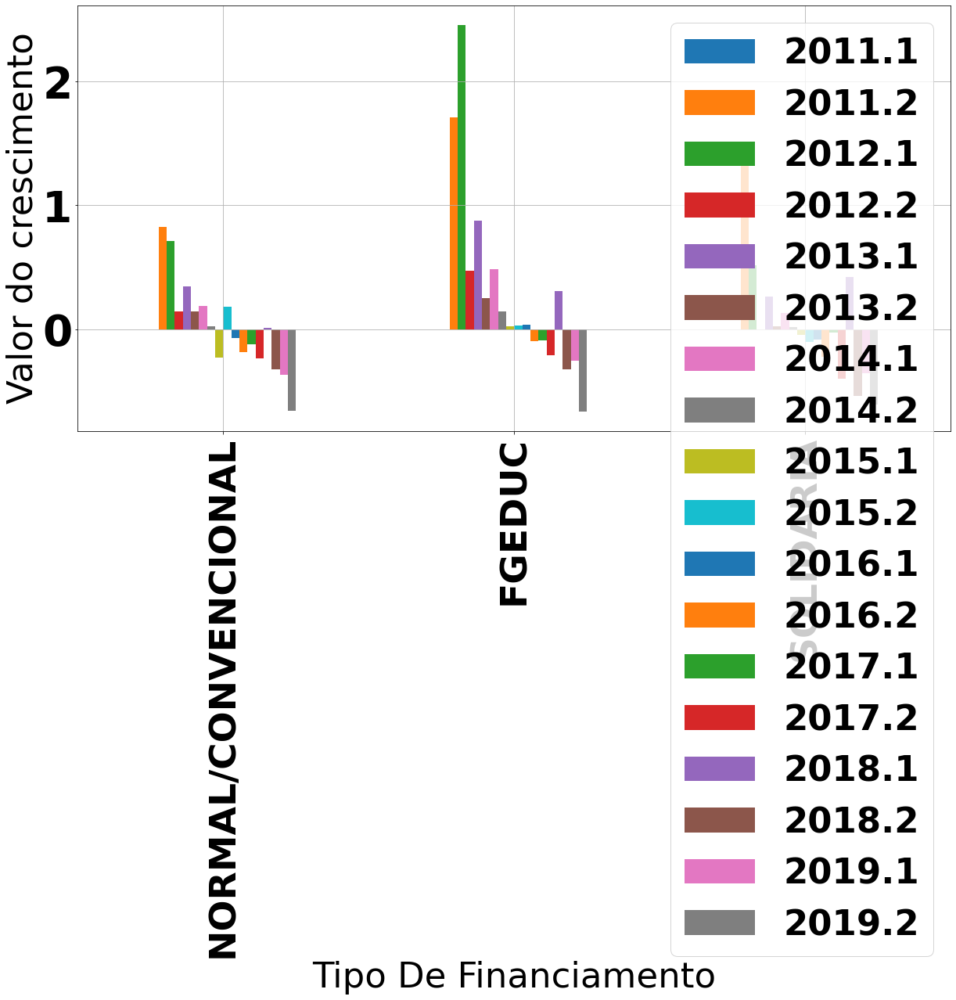

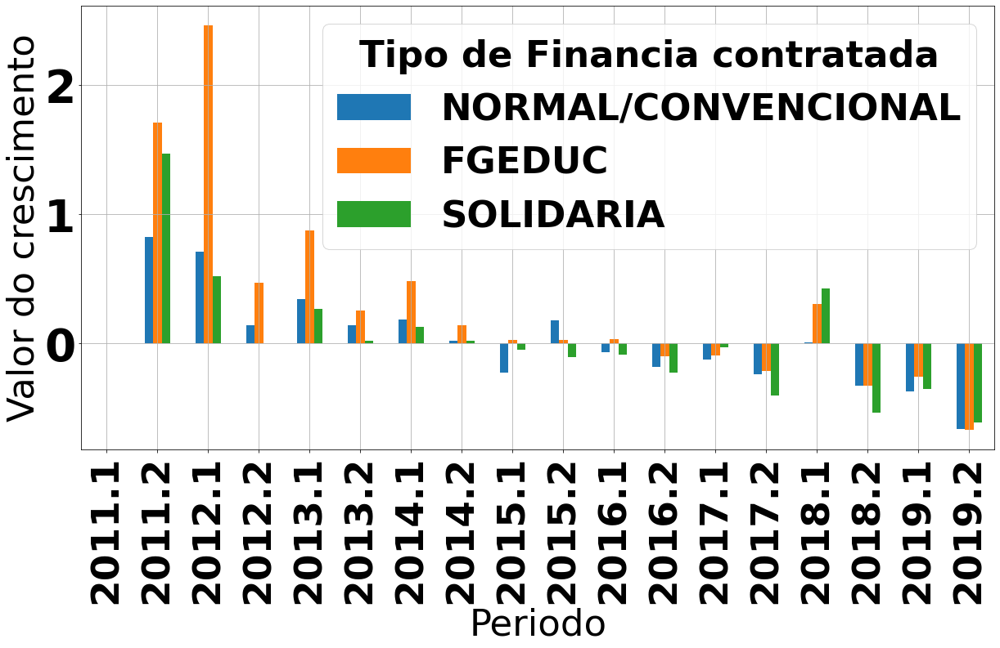

In [ ]:
graficoPorTipoDeFinanciamentoVsPeriodoCrescimento = dfPorTipoDeFinanciamentoPorcentagemCrescimento.plot.bar( grid=True, figsize= (20,10),
xlabel ="Tipo De Financiamento" ,ylabel= "Valor do crescimento")

graficoPorPeriodoVsPorTipoDeFinanciamentoCrescimento = dfPorTipoDeFinanciamentoPorcentagemCrescimentoTransposta.plot.bar(
grid=True, figsize= (20,10), xlabel ="Periodo" ,ylabel= "Valor do crescimento" )

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f404df776a0>,
      dtype=object)

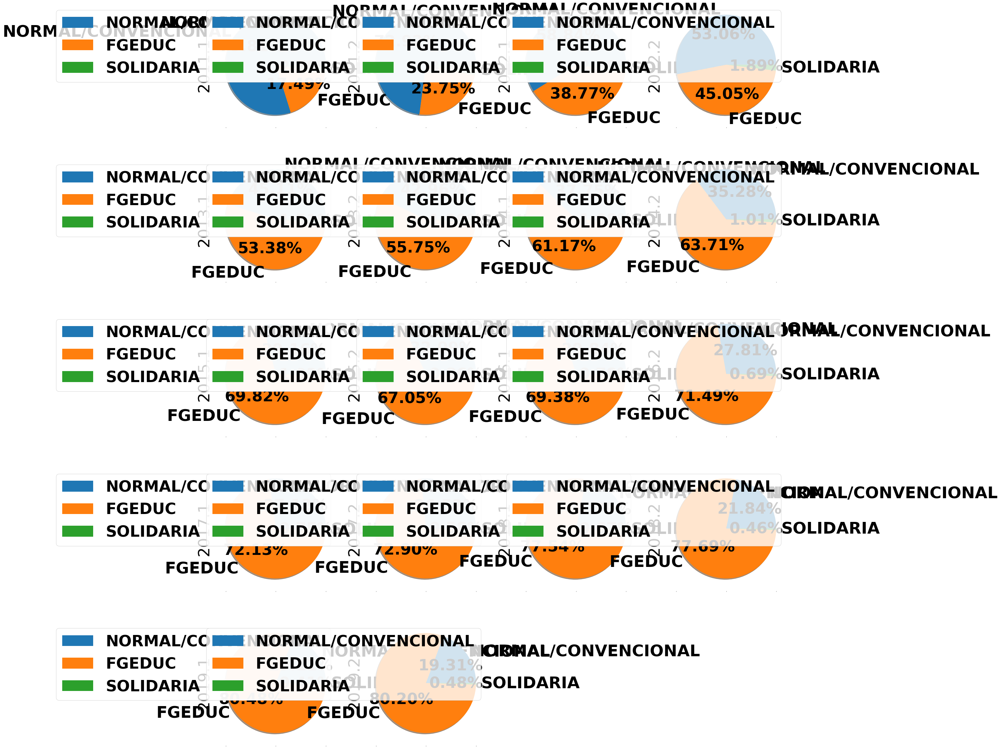

In [ ]:
dfPorTipoDeFinanciamentoPorSemestre.plot.pie(subplots=True, layout=(5,4), figsize=(30,40), shadow=True, autopct='%1.2f%%')

##TOTAIS

In [ ]:
dataTotalDinheiro = {'total': ['VL_REPASSE', 'VALOR_SEMESTRE_PAGO', 'VALOR_ARQUIVO_PAGO'],
         '2011.1': [3631187803, 401931317, 415949159],
         '2011.2': [6991892803, 775730123, 1051880390],
         '2012.1': [13599370814, 1637059660, 1746356350],
         '2012.2': [17539907523, 2206163159, 2340847815],
         '2013.1': [26874609631, 3682070582, 3822478853],
         '2013.2': [32306103744, 4493317119, 4664729160],
         '2014.1': [40984411171, 6327357729, 6496600699],
         '2014.2': [44978732899, 6700543541, 6995953177],
         '2015.1': [39459288166, 5077751533, 5149397180],
         '2015.2': [44451268471, 6987112501, 7986082474],
         '2016.1': [42763045203, 8621549857, 9687821274],
         '2016.2': [58178718668, 2457907042, 2462335227],
         '2017.1': [46227252148, 7590733534, 8339893005],
         '2017.2': [36400530264, 5116427374, 5347389093],
         '2018.1': [52143174614, 7474734520, 8242832074],
         '2018.2': [37234712063, 4621705765, 4691031843],
         '2019.1': [28667545020, 4173844413, 4222011400],
         '2019.2': [9976180024, 804706801, 811369597],
         }

In [ ]:
dfTotalDinheiro = pd.DataFrame(dataTotalDinheiro)
dfTotalDinheiro.set_index('total', inplace=True)
dfTotalDinheiro

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
total,,,,,,,,,,,,,,,,,,
VL_REPASSE,3631187803,6991892803,13599370814,17539907523,26874609631,32306103744,40984411171,44978732899,39459288166,44451268471,42763045203,58178718668,46227252148,36400530264,52143174614,37234712063,28667545020,9976180024
VALOR_SEMESTRE_PAGO,401931317,775730123,1637059660,2206163159,3682070582,4493317119,6327357729,6700543541,5077751533,6987112501,8621549857,2457907042,7590733534,5116427374,7474734520,4621705765,4173844413,804706801
VALOR_ARQUIVO_PAGO,415949159,1051880390,1746356350,2340847815,3822478853,4664729160,6496600699,6995953177,5149397180,7986082474,9687821274,2462335227,8339893005,5347389093,8242832074,4691031843,4222011400,811369597


In [ ]:
dfTotalDinheiroTransposta = dfTotalDinheiro.T
dfTotalDinheiroTransposta

total,VL_REPASSE,VALOR_SEMESTRE_PAGO,VALOR_ARQUIVO_PAGO
2011.1,3631187803,401931317,415949159
2011.2,6991892803,775730123,1051880390
2012.1,13599370814,1637059660,1746356350
2012.2,17539907523,2206163159,2340847815
2013.1,26874609631,3682070582,3822478853
2013.2,32306103744,4493317119,4664729160
2014.1,40984411171,6327357729,6496600699
2014.2,44978732899,6700543541,6995953177
2015.1,39459288166,5077751533,5149397180
2015.2,44451268471,6987112501,7986082474


In [ ]:
totalDinheiroTranspostaPorTipoDeAnalise = dfTotalDinheiroTransposta.sum(0, numeric_only=True)
totalDinheiroTranspostaPorTipoDeAnalise

total
VL_REPASSE             582407931029
VALOR_SEMESTRE_PAGO     79150646570
VALOR_ARQUIVO_PAGO      84474958770
dtype: int64

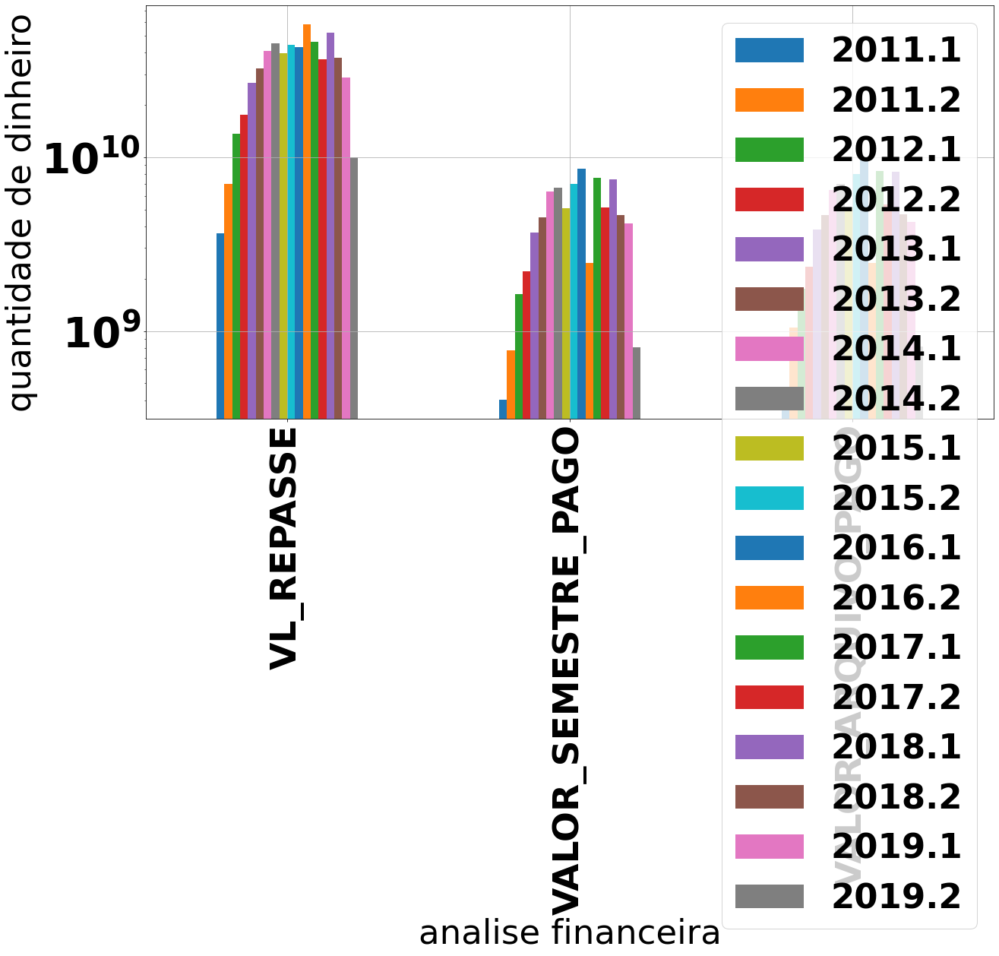

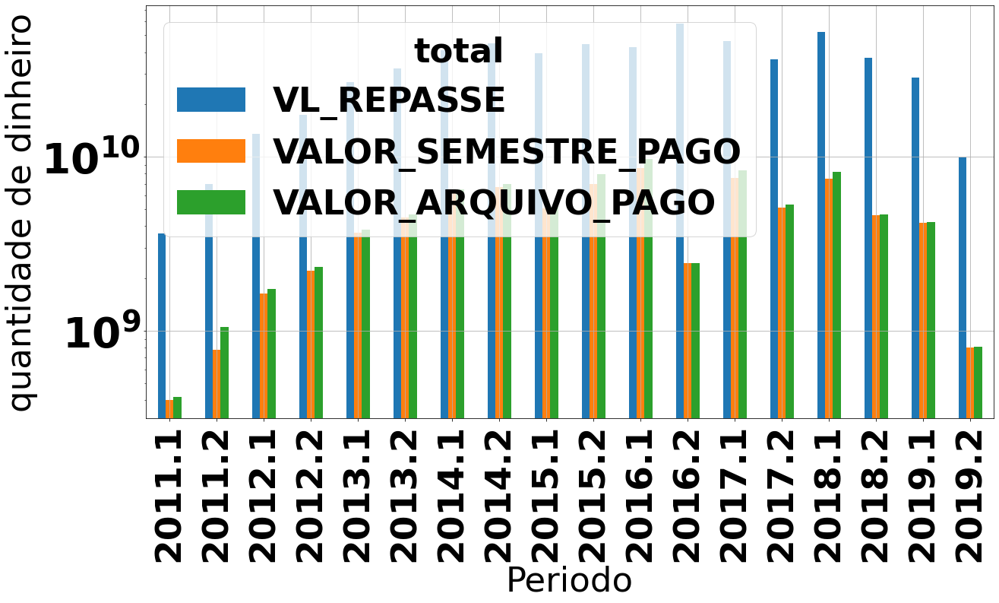

In [ ]:
graficoTotalDinheiro = dfTotalDinheiro.plot.bar( grid=True, figsize= (20,10),
xlabel ="analise financeira" ,ylabel= "quantidade de dinheiro",  logy=True)

graficoTotalDinheiroTransposta = dfTotalDinheiroTransposta.plot.bar( grid=True, figsize= (20,10),
xlabel ="Periodo" ,ylabel= "quantidade de dinheiro",  logy=True)

In [ ]:
dfTotalDinheiroPorcentagemCrescimento = dfTotalDinheiro[['2011.1','2011.2',
'2012.1','2012.2','2013.1','2013.2','2014.1','2014.2','2015.1','2015.2','2016.1','2016.2','2017.1','2017.2',
'2018.1','2018.2','2019.1','2019.2']].pct_change(periods = 1, axis = 1)
dfTotalDinheiroPorcentagemCrescimento

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
total,,,,,,,,,,,,,,,,,,
VL_REPASSE,NaN,0.9255112052,0.9450199248,0.2897587516,0.5321979090,0.2021050422,0.2686274859,0.0974595368,-0.1227123215,0.1265096391,-0.0379791922,0.3604905449,-0.2054267745,-0.2125742160,0.4324839291,-0.2859139794,-0.2300854920,-0.6520043828
VALOR_SEMESTRE_PAGO,NaN,0.9300066708,1.1103468996,0.3476376047,0.6689928698,0.2203234617,0.4081707481,0.0589797239,-0.2421881148,0.3760248913,0.2339217174,-0.7149112303,2.0882915441,-0.3259640388,0.4609284905,-0.3816896436,-0.0969039084,-0.8072024921
VALOR_ARQUIVO_PAGO,NaN,1.5288676927,0.6602233168,0.3404181884,0.6329463319,0.2203413909,0.3927069453,0.0768636555,-0.2639463059,0.5508771600,0.2130880573,-0.7458318896,2.3869852137,-0.3588180220,0.5414685430,-0.4308956193,-0.0999823618,-0.8078239208


In [ ]:
dfTotalDinheiroPorcentagemCrescimentoTransposta = dfTotalDinheiroPorcentagemCrescimento.T
dfTotalDinheiroPorcentagemCrescimentoTransposta

total,VL_REPASSE,VALOR_SEMESTRE_PAGO,VALOR_ARQUIVO_PAGO
2011.1,NaN,NaN,NaN
2011.2,0.9255112052,0.9300066708,1.5288676927
2012.1,0.9450199248,1.1103468996,0.6602233168
2012.2,0.2897587516,0.3476376047,0.3404181884
2013.1,0.5321979090,0.6689928698,0.6329463319
2013.2,0.2021050422,0.2203234617,0.2203413909
2014.1,0.2686274859,0.4081707481,0.3927069453
2014.2,0.0974595368,0.0589797239,0.0768636555
2015.1,-0.1227123215,-0.2421881148,-0.2639463059
2015.2,0.1265096391,0.3760248913,0.5508771600


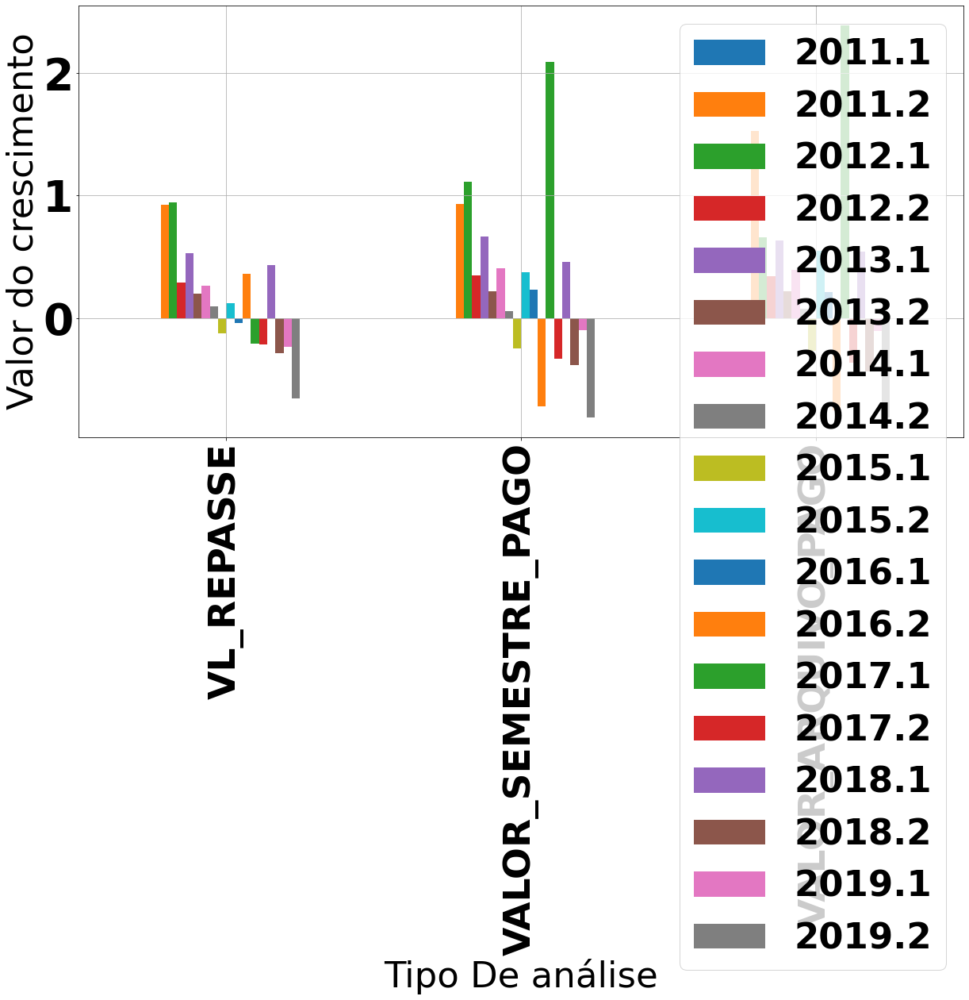

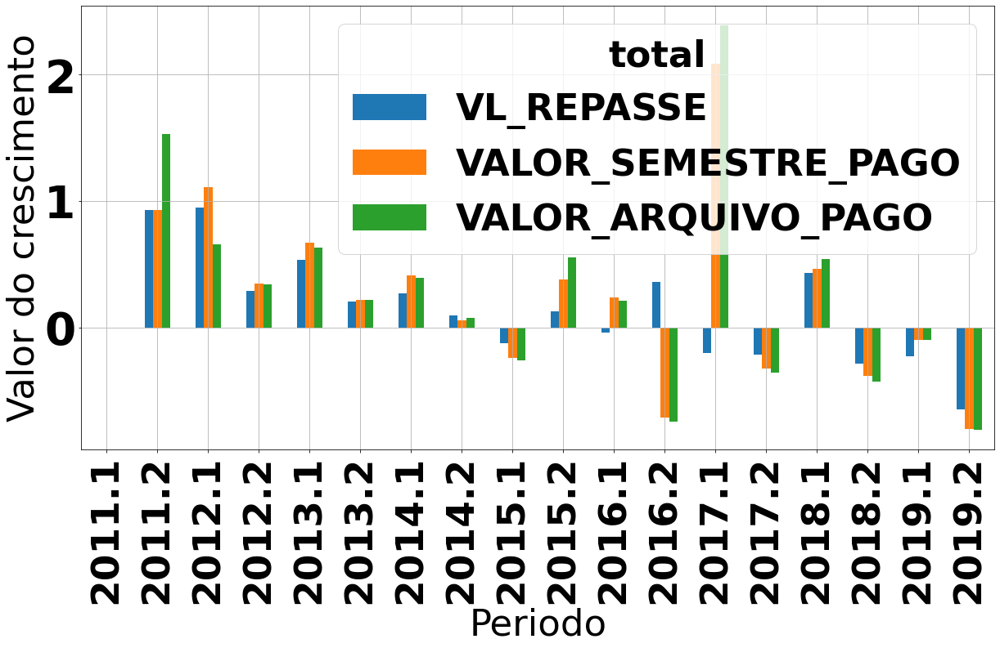

In [ ]:
graficoPorTipoDeanaliseVsPeriodoCrescimento = dfTotalDinheiroPorcentagemCrescimento.plot.bar( grid=True, figsize= (20,10),
xlabel ="Tipo De análise" ,ylabel= "Valor do crescimento")

graficoPorPeriodoVsPorTipoDeAnaliseCrescimento = dfTotalDinheiroPorcentagemCrescimentoTransposta.plot.bar(
grid=True, figsize= (20,10), xlabel ="Periodo" ,ylabel= "Valor do crescimento" )

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f406c5d42b0>,
      dtype=object)

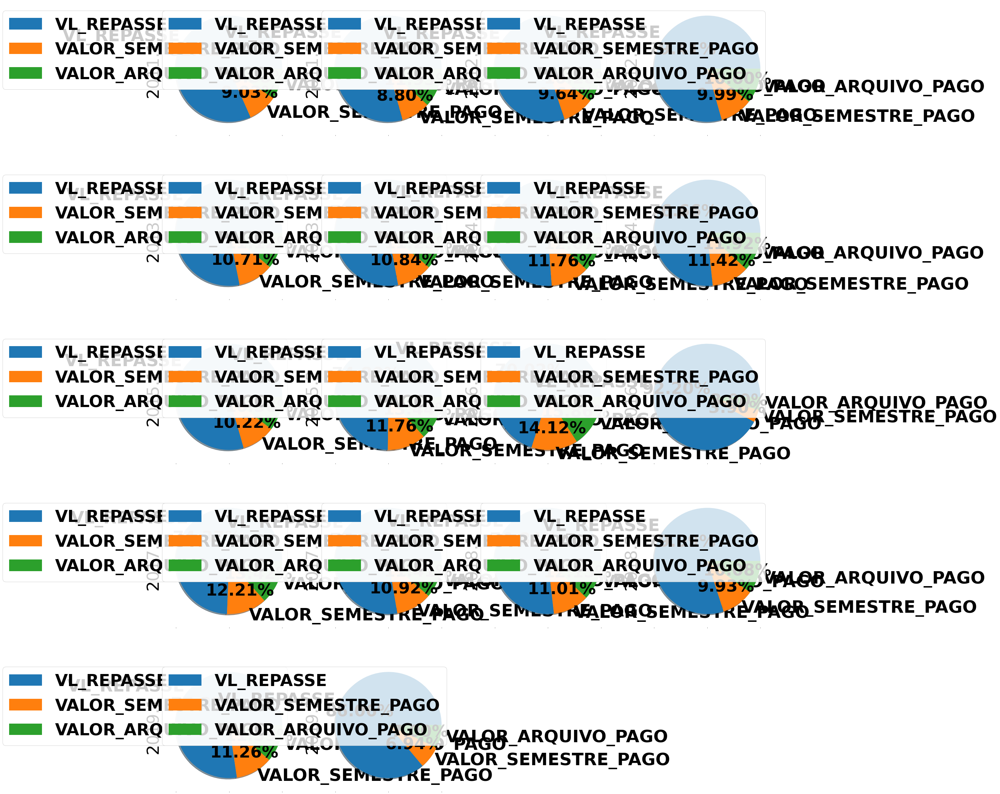

In [ ]:
dfTotalDinheiro.plot.pie(subplots=True, layout=(5,4), figsize=(30,40), shadow=True, autopct='%1.2f%%')

Analisando as diferenças por semestre

In [ ]:
dfTotalDinheiroTranspostaComDiferencas = dfTotalDinheiroTransposta
dfTotalDinheiroTranspostaComDiferencas['diferençaRepassevsSemestre'] = dfTotalDinheiroTransposta['VL_REPASSE'] / dfTotalDinheiroTransposta[
    'VALOR_SEMESTRE_PAGO']

dfTotalDinheiroTranspostaComDiferencas['diferençaRepassevsArquivo'] = dfTotalDinheiroTransposta['VL_REPASSE'] / dfTotalDinheiroTransposta[
    'VALOR_ARQUIVO_PAGO']


dfTotalDinheiroTranspostaComDiferencas

total,VL_REPASSE,VALOR_SEMESTRE_PAGO,VALOR_ARQUIVO_PAGO,diferençaRepassevsSemestre,diferençaRepassevsArquivo
2011.1,3631187803,401931317,415949159,9.0343490278,8.7298837476
2011.2,6991892803,775730123,1051880390,9.0133057821,6.6470416879
2012.1,13599370814,1637059660,1746356350,8.3071931624,7.7872828269
2012.2,17539907523,2206163159,2340847815,7.9504126662,7.4929721662
2013.1,26874609631,3682070582,3822478853,7.2987763359,7.0306758165
2013.2,32306103744,4493317119,4664729160,7.1898116444,6.9256118921
2014.1,40984411171,6327357729,6496600699,6.4773342881,6.3085932274
2014.2,44978732899,6700543541,6995953177,6.7126991450,6.4292501338
2015.1,39459288166,5077751533,5149397180,7.7710159525,7.6628946626
2015.2,44451268471,6987112501,7986082474,6.3618939103,5.5660918374


Os valores que mais se aproximam dos valores do prestação de contas ordinárias anual relatório de gestão, um relatório das contas do FIES disponibilizado pelo governo, são os valores de VALOR_SEMESTRE_PAGO, mas mesmo eles são mais elevados que o do relatório. Outro ponto que podemos notar é que quanto maior a diferença obtida em diferençaRepassevsSemestre, maior a quantidade de repetições que o período tem, o que diminui a qualidade da sua análise. Por essa razão, será realizado a analise 




##VL_REPASSE

##VALOR_SEMESTRE_PAGO

In [ ]:
dataSemestreRegiao = {'região': ['SUDESTE ', 'SUL', 'NORDESTE', 'CENTRO-OESTE', 'NORTE '],
         '2011.1': [192595535, 84903769, 77329632, 34472916, 12629462],
         '2011.2': [359527578, 152053742, 155250134, 80759912, 28138755],
         '2012.1': [861667107, 269770341, 277435387, 167701432, 60485392],
         '2012.2': [1197409598, 325633478, 381342331, 219433019, 82344732],
         '2013.1': [2068468143, 493147019, 615843938, 367301619, 137309861],
         '2013.2': [2478056157, 576047098, 794293885, 460592043, 184327935],
         '2014.1': [3430206604, 819581405, 1137245691, 660599714, 279724313],
         '2014.2': [3534757041, 901611786, 1228212518, 715176074, 320786120],
         '2015.1': [2542919376, 616758660, 1045447753, 599228070, 273397672],
         '2015.2': [3621081060, 970900692, 1333814811, 732694828, 328621108],
         '2016.1': [4464981812, 1059930213, 1732485666, 909303646, 454848519],
         '2016.2': [1259397288, 375814073, 481283131, 225550184, 115862364],
         '2017.1': [3843349688, 926017052, 1610197288, 788686320, 422483185],
         '2017.2': [2578467619, 633070995, 1085538398, 540006971, 279343389],
         '2018.1': [3847791052, 810237563, 1680846210, 721552538, 414307156],
         '2018.2': [2255678468, 594284845, 1081054816, 428247309, 262440325],
         '2019.1': [1998232140, 512423415, 1103100952, 335525944, 224561959],
         '2019.2': [359806478, 115275450, 207900335, 74870088, 46854449],
         }

         

In [ ]:
dataSemestreCategoriaCurso = {'categoria': ['Ciências da Saúde', 'Ciências Sociais Aplicadas', 'Engenharias',
'Ciências Humanas', 'Ciências Agrárias', 'Ciências Exatas e da Terra', 'Linguística, Letras e Artes', 'Ciências Biológicas'],
         '2011.1': [188866178, 103848787, 54700500, 19953151, 13618548, 13084919, 4120001, 3739229],
         '2011.2': [354864166, 207785233, 108861382, 42556256, 23728108, 22933191, 8019601, 6982182],
         '2012.1': [629233208, 488930135, 266490037, 113039107, 51582998, 50467767, 22689910, 14626494],
         '2012.2': [816241340, 685376432, 360909621, 162640090, 66551109, 63767171, 32503634, 18173759],
         '2013.1': [1260660685, 1181056717, 637334453, 300352077, 108713013, 105637540, 57694493, 30621601],
         '2013.2': [1551186457, 1452077040, 781105726, 361187775, 130457791, 118591209, 62085059, 36626058],
         '2014.1': [2145796063, 2016719460, 1174817551, 494100018, 209926577, 159813996, 76487084, 49696977],
         '2014.2': [2327591925, 2125432098, 1237083656, 501235718, 229783642, 155763260, 71751195, 51902044],
         '2015.1': [1803974155, 1578167666, 927637861, 377808478, 191679163, 110554695, 49762322, 38167190],
         '2015.2': [2507753989, 2175622674, 1274340496, 517270278, 252614508, 142807090, 67488319, 49215144],
         '2016.1': [3116224083, 2609100387, 1630918267, 659121114, 321705137, 157273237, 73158289, 54049339],
         '2016.2': [961435765, 695523795, 463511695, 168089688, 97862745, 39086116, 19291273, 13105962],
         '2017.1': [2869748916, 2217947562, 1443373209, 563531885, 294732635, 113103828, 49588099, 38707397],
         '2017.2': [1978349589, 1477114799, 962831443, 378693696, 205796946, 64294240, 27530895, 21815764],
         '2018.1': [2891674533, 2167908420, 1358760811, 584394194, 294265449, 102058746, 45246664, 30425700],
         '2018.2': [1929215354, 1238205280, 842318157, 327445638, 208553684, 47280549, 16590398, 12096701],
         '2019.1': [1851051413, 1046540009, 737424882, 285660914, 194703386, 37156856, 12106276, 9200674],
         '2019.2': [415841801, 173171119, 119430251, 47360996, 40096059, 5570049, 1758794, 1477729],
         }

In [ ]:
dfSemestreRegiao = pd.DataFrame(dataSemestreRegiao)
dfSemestreRegiao.set_index('região', inplace=True)
dfSemestreRegiao

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
região,,,,,,,,,,,,,,,,,,
SUDESTE,192595535,359527578,861667107,1197409598,2068468143,2478056157,3430206604,3534757041,2542919376,3621081060,4464981812,1259397288,3843349688,2578467619,3847791052,2255678468,1998232140,359806478
SUL,84903769,152053742,269770341,325633478,493147019,576047098,819581405,901611786,616758660,970900692,1059930213,375814073,926017052,633070995,810237563,594284845,512423415,115275450
NORDESTE,77329632,155250134,277435387,381342331,615843938,794293885,1137245691,1228212518,1045447753,1333814811,1732485666,481283131,1610197288,1085538398,1680846210,1081054816,1103100952,207900335
CENTRO-OESTE,34472916,80759912,167701432,219433019,367301619,460592043,660599714,715176074,599228070,732694828,909303646,225550184,788686320,540006971,721552538,428247309,335525944,74870088
NORTE,12629462,28138755,60485392,82344732,137309861,184327935,279724313,320786120,273397672,328621108,454848519,115862364,422483185,279343389,414307156,262440325,224561959,46854449


In [ ]:
dfSemestreCategoriaCurso = pd.DataFrame(dataSemestreCategoriaCurso)
dfSemestreCategoriaCurso.set_index('categoria', inplace=True)
dfSemestreCategoriaCurso

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
categoria,,,,,,,,,,,,,,,,,,
Ciências da Saúde,188866178,354864166,629233208,816241340,1260660685,1551186457,2145796063,2327591925,1803974155,2507753989,3116224083,961435765,2869748916,1978349589,2891674533,1929215354,1851051413,415841801
Ciências Sociais Aplicadas,103848787,207785233,488930135,685376432,1181056717,1452077040,2016719460,2125432098,1578167666,2175622674,2609100387,695523795,2217947562,1477114799,2167908420,1238205280,1046540009,173171119
Engenharias,54700500,108861382,266490037,360909621,637334453,781105726,1174817551,1237083656,927637861,1274340496,1630918267,463511695,1443373209,962831443,1358760811,842318157,737424882,119430251
Ciências Humanas,19953151,42556256,113039107,162640090,300352077,361187775,494100018,501235718,377808478,517270278,659121114,168089688,563531885,378693696,584394194,327445638,285660914,47360996
Ciências Agrárias,13618548,23728108,51582998,66551109,108713013,130457791,209926577,229783642,191679163,252614508,321705137,97862745,294732635,205796946,294265449,208553684,194703386,40096059
Ciências Exatas e da Terra,13084919,22933191,50467767,63767171,105637540,118591209,159813996,155763260,110554695,142807090,157273237,39086116,113103828,64294240,102058746,47280549,37156856,5570049
"Linguística, Letras e Artes",4120001,8019601,22689910,32503634,57694493,62085059,76487084,71751195,49762322,67488319,73158289,19291273,49588099,27530895,45246664,16590398,12106276,1758794
Ciências Biológicas,3739229,6982182,14626494,18173759,30621601,36626058,49696977,51902044,38167190,49215144,54049339,13105962,38707397,21815764,30425700,12096701,9200674,1477729


In [ ]:
dfSemestreRegiaoTransposta = dfSemestreRegiao.T
dfSemestreRegiaoTransposta

região,SUDESTE,SUL,NORDESTE,CENTRO-OESTE,NORTE
2011.1,192595535,84903769,77329632,34472916,12629462
2011.2,359527578,152053742,155250134,80759912,28138755
2012.1,861667107,269770341,277435387,167701432,60485392
2012.2,1197409598,325633478,381342331,219433019,82344732
2013.1,2068468143,493147019,615843938,367301619,137309861
2013.2,2478056157,576047098,794293885,460592043,184327935
2014.1,3430206604,819581405,1137245691,660599714,279724313
2014.2,3534757041,901611786,1228212518,715176074,320786120
2015.1,2542919376,616758660,1045447753,599228070,273397672
2015.2,3621081060,970900692,1333814811,732694828,328621108


In [ ]:
dfSemestreCategoriaCursoTransposta = dfSemestreCategoriaCurso.T
dfSemestreCategoriaCursoTransposta

categoria,Ciências da Saúde,Ciências Sociais Aplicadas,Engenharias,Ciências Humanas,Ciências Agrárias,Ciências Exatas e da Terra,"Linguística, Letras e Artes",Ciências Biológicas
2011.1,188866178,103848787,54700500,19953151,13618548,13084919,4120001,3739229
2011.2,354864166,207785233,108861382,42556256,23728108,22933191,8019601,6982182
2012.1,629233208,488930135,266490037,113039107,51582998,50467767,22689910,14626494
2012.2,816241340,685376432,360909621,162640090,66551109,63767171,32503634,18173759
2013.1,1260660685,1181056717,637334453,300352077,108713013,105637540,57694493,30621601
2013.2,1551186457,1452077040,781105726,361187775,130457791,118591209,62085059,36626058
2014.1,2145796063,2016719460,1174817551,494100018,209926577,159813996,76487084,49696977
2014.2,2327591925,2125432098,1237083656,501235718,229783642,155763260,71751195,51902044
2015.1,1803974155,1578167666,927637861,377808478,191679163,110554695,49762322,38167190
2015.2,2507753989,2175622674,1274340496,517270278,252614508,142807090,67488319,49215144


In [ ]:
totaisSemestreRegiao = dfSemestreRegiao.sum(0, numeric_only=True)
totaisSemestreRegiao

2011.1     401931314
2011.2     775730121
2012.1    1637059659
2012.2    2206163158
2013.1    3682070580
2013.2    4493317118
2014.1    6327357727
2014.2    6700543539
2015.1    5077751531
2015.2    6987112499
2016.1    8621549856
2016.2    2457907040
2017.1    7590733533
2017.2    5116427372
2018.1    7474734519
2018.2    4621705763
2019.1    4173844410
2019.2     804706800
dtype: int64

In [ ]:
totaisSemestreCategoriaCurso = dfSemestreCategoriaCurso.sum(0, numeric_only=True)
totaisSemestreCategoriaCurso

2011.1     401931313
2011.2     775730119
2012.1    1637059656
2012.2    2206163156
2013.1    3682070579
2013.2    4493317115
2014.1    6327357726
2014.2    6700543538
2015.1    5077751530
2015.2    6987112498
2016.1    8621549853
2016.2    2457907039
2017.1    7590733531
2017.2    5116427372
2018.1    7474734517
2018.2    4621705761
2019.1    4173844410
2019.2     804706798
dtype: int64

Valores batem, tanto entre si, quanto com os valores calculados em TOTAIS

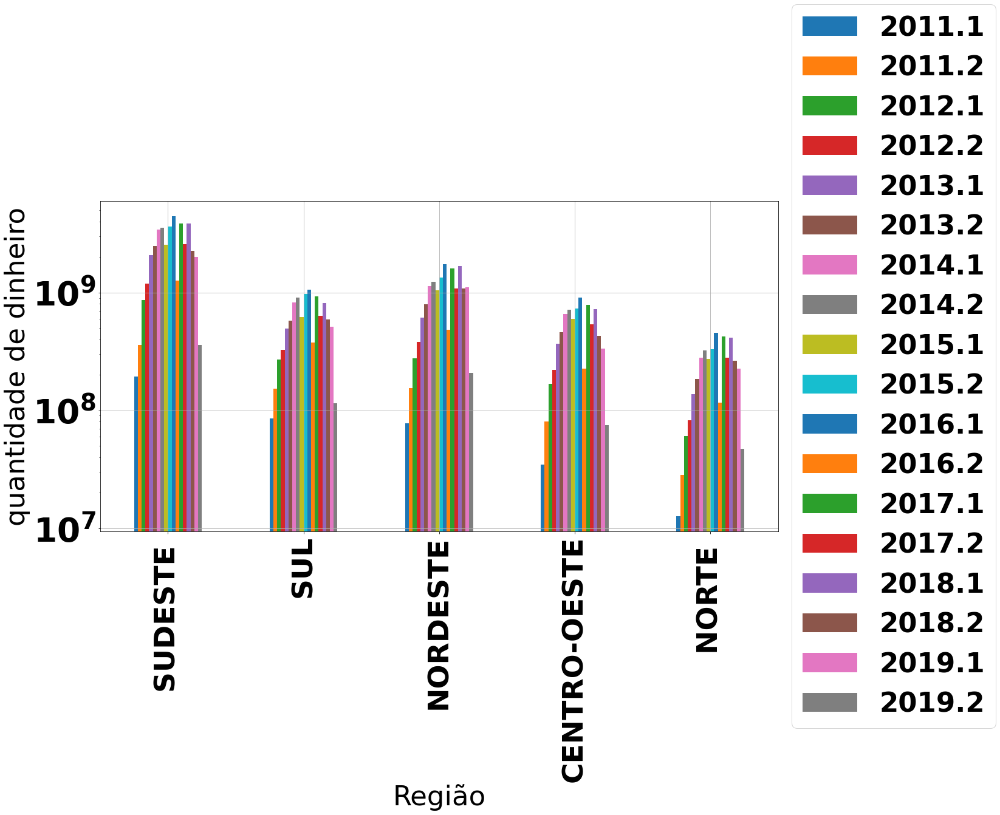

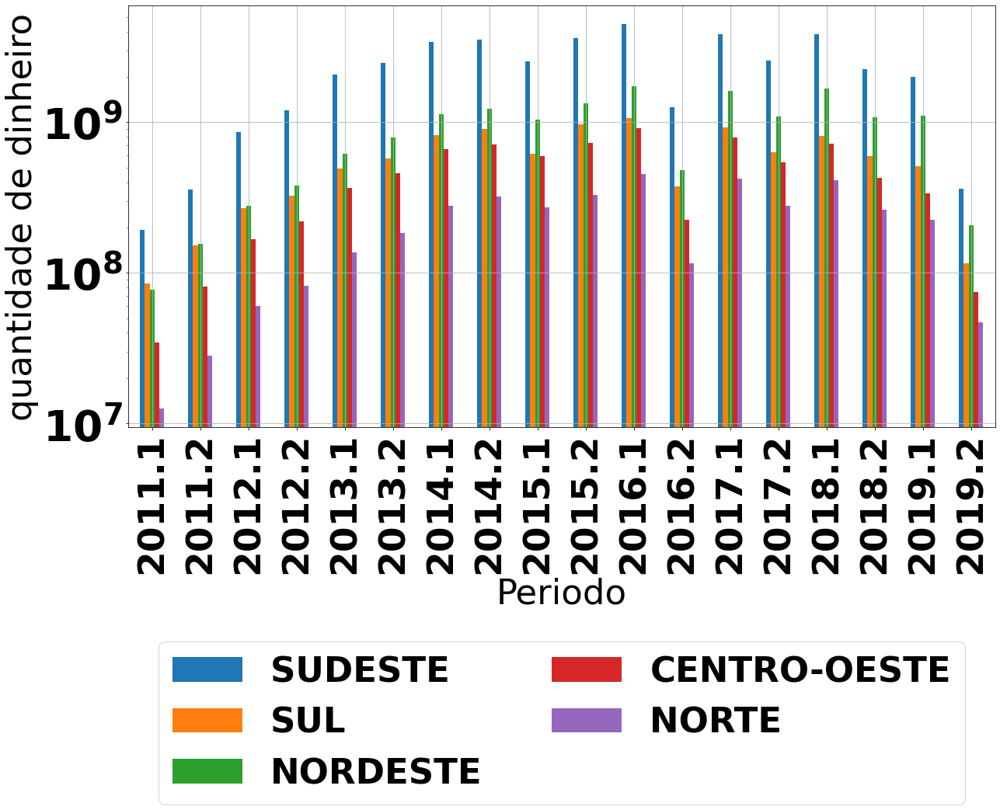

In [ ]:
graficoRegiaoVsPeriodo = dfSemestreRegiao.plot.bar( grid=True, figsize= (20,10),
xlabel ="Região" ,ylabel= "quantidade de dinheiro", logy=True).legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

graficoPorPeriodoVsRegiao = dfSemestreRegiaoTransposta.plot.bar( grid=True, figsize= (20,10),
xlabel ="Periodo" ,ylabel= "quantidade de dinheiro", logy=True).legend(loc='center',ncol=2,bbox_to_anchor=(0.5, -0.7));

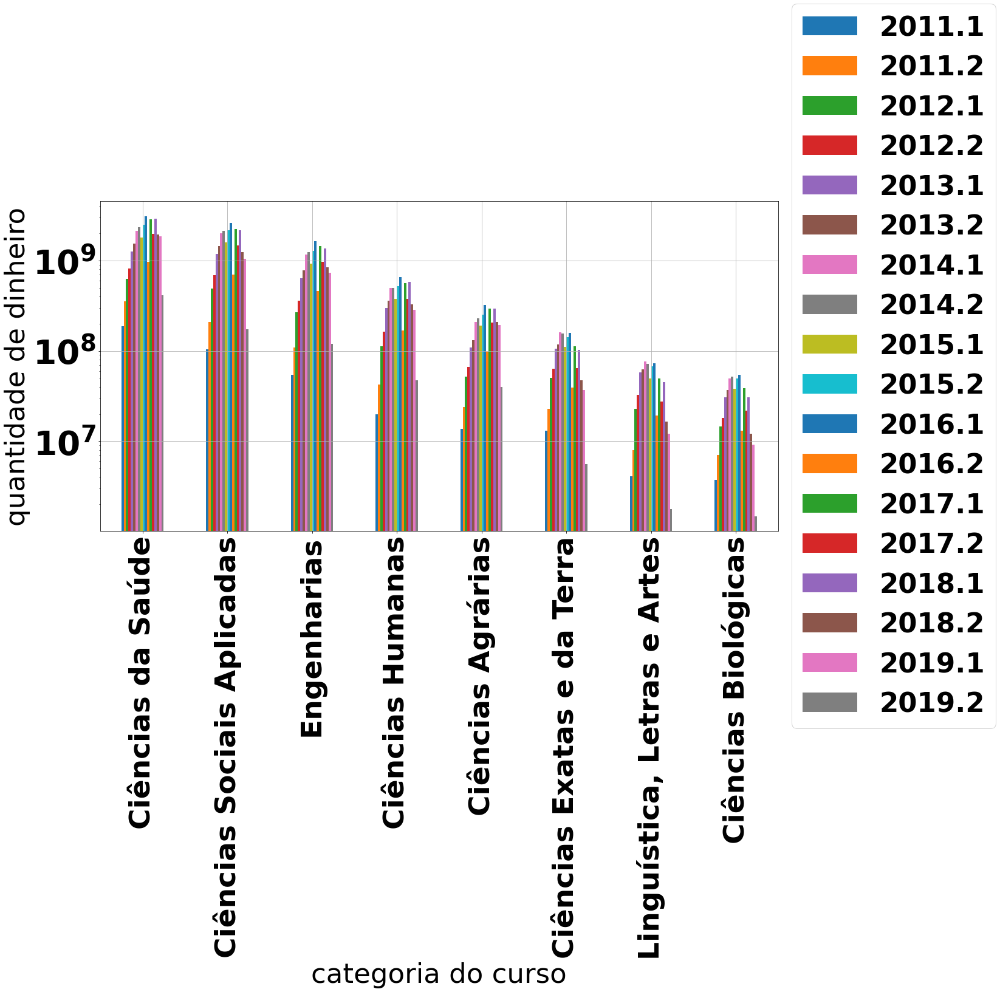

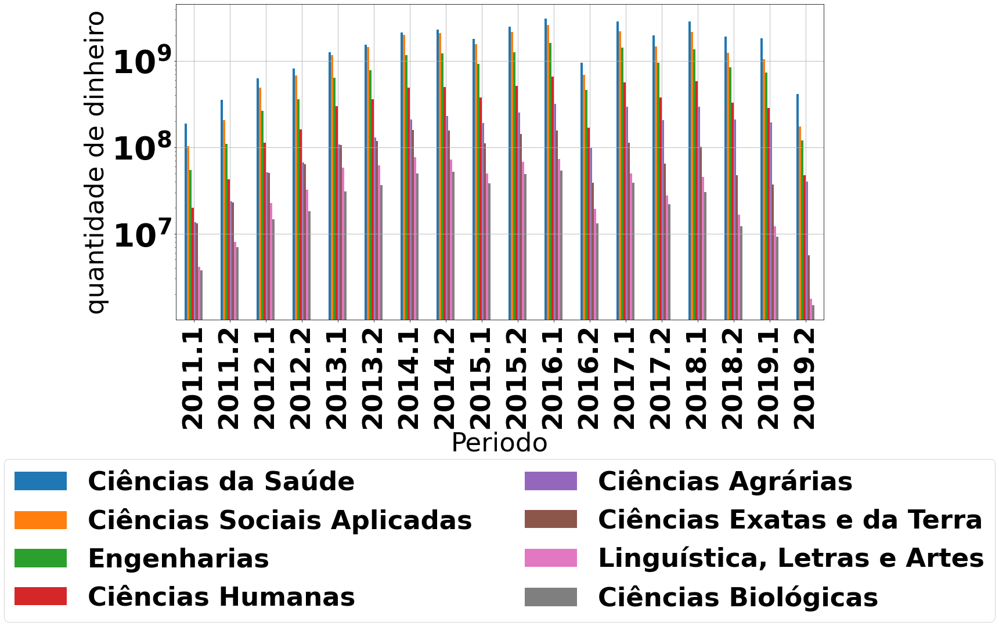

In [ ]:
graficoCategoriaCursoVsPeriodo = dfSemestreCategoriaCurso.plot.bar( grid=True, figsize= (20,10),
xlabel ="categoria do curso" ,ylabel= "quantidade de dinheiro", logy=True).legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

graficoPorPeriodoVsCategoriaCurso = dfSemestreCategoriaCursoTransposta.plot.bar( grid=True, figsize= (20,10),
xlabel ="Periodo" ,ylabel= "quantidade de dinheiro", logy=True).legend(loc='center',ncol=2,bbox_to_anchor=(0.5, -0.7));

In [ ]:
dfSemestreRegiaoPorcentagemCrescimento = dfSemestreRegiao[['2011.1','2011.2',
'2012.1','2012.2','2013.1','2013.2','2014.1','2014.2','2015.1','2015.2','2016.1','2016.2','2017.1','2017.2',
'2018.1','2018.2','2019.1','2019.2']].pct_change(periods = 1, axis = 1)
dfSemestreRegiaoPorcentagemCrescimento

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
região,,,,,,,,,,,,,,,,,,
SUDESTE,NaN,0.8667492889,1.3966648450,0.3896429239,0.7274524494,0.1980151425,0.3842327965,0.0304793411,-0.2805957110,0.4239857914,0.2330521571,-0.7179389881,2.0517373069,-0.3291092853,0.4922782135,-0.4137731396,-0.1141325467,-0.8199375984
SUL,NaN,0.7908950779,0.7741775865,0.2070766445,0.5144235845,0.1681041876,0.4227680477,0.1000881432,-0.3159376690,0.5741987182,0.0916978654,-0.6454350783,1.4640297384,-0.3163506075,0.2798526064,-0.2665301238,-0.1377478000,-0.7750386758
NORDESTE,NaN,1.0076409261,0.7870218843,0.3745266425,0.6149372570,0.2897648836,0.4317694149,0.0799887199,-0.1488054895,0.2758311519,0.2988952077,-0.7222008006,2.3456341689,-0.3258351594,0.5483986684,-0.3568389484,0.0203931713,-0.8115309985
CENTRO-OESTE,NaN,1.3427061407,1.0765430255,0.3084743307,0.6738666800,0.2539886000,0.4342403957,0.0826163845,-0.1621251161,0.2227311514,0.2410400773,-0.7519528433,2.4967221308,-0.3153083079,0.3361911545,-0.4064918541,-0.2165135964,-0.7768575297
NORTE,NaN,1.2280248359,1.1495404470,0.3613986663,0.6675002476,0.3424231418,0.5175361944,0.1467938434,-0.1477259926,0.2019894156,0.3841123042,-0.7452726366,2.6464229661,-0.3388059006,0.4831464510,-0.3665561379,-0.1443313485,-0.7913517979


In [ ]:
dfSemestreCategoriaCursoPorcentagemCrescimento = dfSemestreCategoriaCurso[['2011.1','2011.2',
'2012.1','2012.2','2013.1','2013.2','2014.1','2014.2','2015.1','2015.2','2016.1','2016.2','2017.1','2017.2',
'2018.1','2018.2','2019.1','2019.2']].pct_change(periods = 1, axis = 1)
dfSemestreCategoriaCursoPorcentagemCrescimento

,2011.1,2011.2,2012.1,2012.2,2013.1,2013.2,2014.1,2014.2,2015.1,2015.2,2016.1,2016.2,2017.1,2017.2,2018.1,2018.2,2019.1,2019.2
categoria,,,,,,,,,,,,,,,,,,
Ciências da Saúde,NaN,0.8789185536,0.7731663783,0.2972000359,0.5444705178,0.2304551696,0.3833256817,0.0847218732,-0.2249611559,0.3901274484,0.2426354805,-0.6914741240,1.9848576686,-0.3106192747,0.4616600368,-0.3328380037,-0.0405159231,-0.7753483247
Ciências Sociais Aplicadas,NaN,1.0008441023,1.3530552578,0.4017880735,0.7232234169,0.2294727417,0.3888515585,0.0539056821,-0.2574838465,0.3785751165,0.1992430573,-0.7334239041,2.1888881127,-0.3340172580,0.4676641392,-0.4288479769,-0.1547928071,-0.8345298627
Engenharias,NaN,0.9901350445,1.4479758763,0.3543081200,0.7659115078,0.2255821450,0.5040442182,0.0530006595,-0.2501413655,0.3737478272,0.2798135758,-0.7157971038,2.1139952337,-0.3329296699,0.4112135835,-0.3800835657,-0.1245292816,-0.8380441806
Ciências Humanas,NaN,1.1328087980,1.6562277236,0.4387948942,0.8467284235,0.2025479517,0.3679865494,0.0144418129,-0.2462458990,0.3691335905,0.2742296282,-0.7449790571,2.3525666667,-0.3279995222,0.5431843735,-0.4396836222,-0.1276081253,-0.8342055434
Ciências Agrárias,NaN,0.7423375825,1.1739195557,0.2901752822,0.6335266930,0.2000200105,0.6091532395,0.0945905244,-0.1658276397,0.3179028124,0.2735022210,-0.6957998684,2.0116939291,-0.3017503949,0.4298824872,-0.2912736283,-0.0664111884,-0.7940659388
Ciências Exatas e da Terra,NaN,0.7526429472,1.2006430331,0.2635227352,0.6566132438,0.1226237283,0.3476040707,-0.0253465660,-0.2902389498,0.2917324769,0.1012985210,-0.7514763685,1.8937085486,-0.4315467377,0.5873699728,-0.5367320210,-0.2141196161,-0.8500936409
"Linguística, Letras e Artes",NaN,0.9465046246,1.8293065952,0.4325148932,0.7750166951,0.0761002614,0.2319724783,-0.0619174997,-0.3064600248,0.3562132209,0.0840140944,-0.7363077614,1.5704938705,-0.4448084207,0.6434868536,-0.6333343382,-0.2702841728,-0.8547204772
Ciências Biológicas,NaN,0.8672785219,1.0948313865,0.2425232595,0.6849349108,0.1960856651,0.3568748512,0.0443702441,-0.2646303101,0.2894620746,0.0982257616,-0.7575185517,1.9534189860,-0.4363928941,0.3946658022,-0.6024183174,-0.2394063472,-0.8393890491


In [ ]:
dfSemestreRegiaoPorcentagemCrescimentoTransposta = dfSemestreRegiaoPorcentagemCrescimento.T
dfSemestreRegiaoPorcentagemCrescimentoTransposta

região,SUDESTE,SUL,NORDESTE,CENTRO-OESTE,NORTE
2011.1,NaN,NaN,NaN,NaN,NaN
2011.2,0.8667492889,0.7908950779,1.0076409261,1.3427061407,1.2280248359
2012.1,1.3966648450,0.7741775865,0.7870218843,1.0765430255,1.1495404470
2012.2,0.3896429239,0.2070766445,0.3745266425,0.3084743307,0.3613986663
2013.1,0.7274524494,0.5144235845,0.6149372570,0.6738666800,0.6675002476
2013.2,0.1980151425,0.1681041876,0.2897648836,0.2539886000,0.3424231418
2014.1,0.3842327965,0.4227680477,0.4317694149,0.4342403957,0.5175361944
2014.2,0.0304793411,0.1000881432,0.0799887199,0.0826163845,0.1467938434
2015.1,-0.2805957110,-0.3159376690,-0.1488054895,-0.1621251161,-0.1477259926
2015.2,0.4239857914,0.5741987182,0.2758311519,0.2227311514,0.2019894156


In [ ]:
dfSemestreCategoriaCursoPorcentagemCrescimentoTransposta = dfSemestreCategoriaCursoPorcentagemCrescimento.T
dfSemestreCategoriaCursoPorcentagemCrescimentoTransposta

categoria,Ciências da Saúde,Ciências Sociais Aplicadas,Engenharias,Ciências Humanas,Ciências Agrárias,Ciências Exatas e da Terra,"Linguística, Letras e Artes",Ciências Biológicas
2011.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2011.2,0.8789185536,1.0008441023,0.9901350445,1.1328087980,0.7423375825,0.7526429472,0.9465046246,0.8672785219
2012.1,0.7731663783,1.3530552578,1.4479758763,1.6562277236,1.1739195557,1.2006430331,1.8293065952,1.0948313865
2012.2,0.2972000359,0.4017880735,0.3543081200,0.4387948942,0.2901752822,0.2635227352,0.4325148932,0.2425232595
2013.1,0.5444705178,0.7232234169,0.7659115078,0.8467284235,0.6335266930,0.6566132438,0.7750166951,0.6849349108
2013.2,0.2304551696,0.2294727417,0.2255821450,0.2025479517,0.2000200105,0.1226237283,0.0761002614,0.1960856651
2014.1,0.3833256817,0.3888515585,0.5040442182,0.3679865494,0.6091532395,0.3476040707,0.2319724783,0.3568748512
2014.2,0.0847218732,0.0539056821,0.0530006595,0.0144418129,0.0945905244,-0.0253465660,-0.0619174997,0.0443702441
2015.1,-0.2249611559,-0.2574838465,-0.2501413655,-0.2462458990,-0.1658276397,-0.2902389498,-0.3064600248,-0.2646303101
2015.2,0.3901274484,0.3785751165,0.3737478272,0.3691335905,0.3179028124,0.2917324769,0.3562132209,0.2894620746


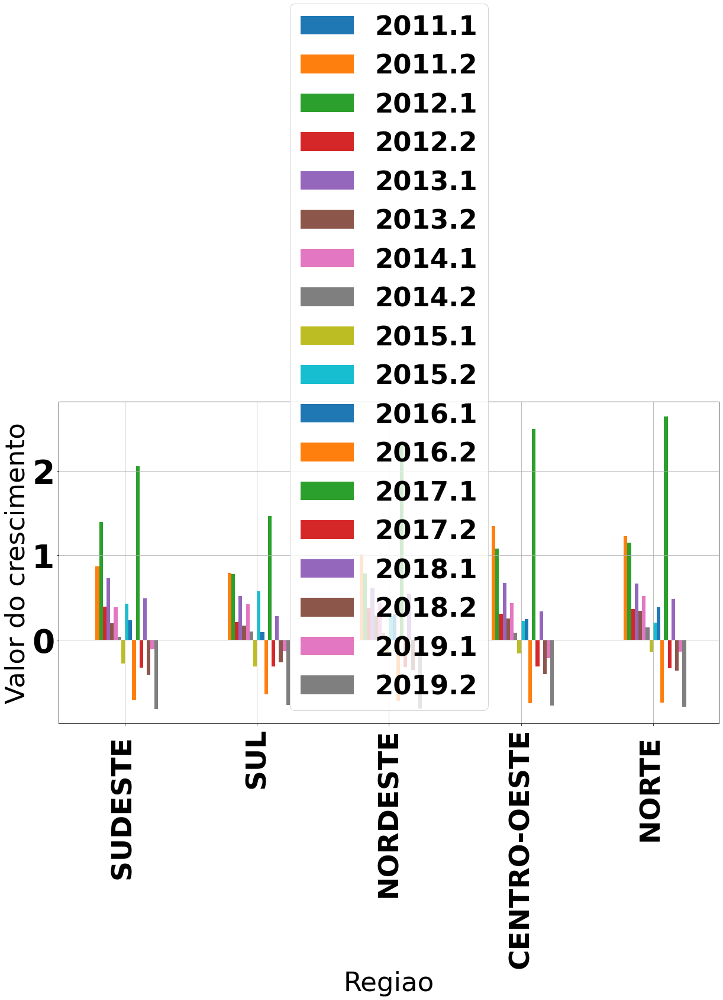

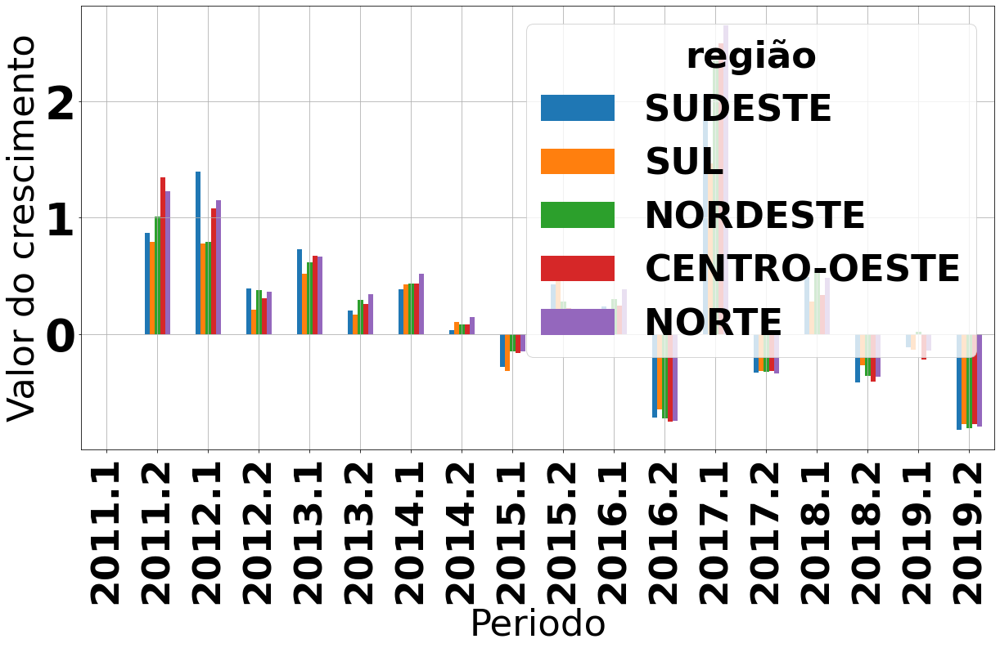

In [ ]:
graficoRegiaoVsPeriodoCrescimento = dfSemestreRegiaoPorcentagemCrescimento.plot.bar(
     grid=True, figsize= (20,10),
xlabel ="Regiao" ,ylabel= "Valor do crescimento")

graficoPorPeriodoVsRegiaoCrescimento = dfSemestreRegiaoPorcentagemCrescimentoTransposta.plot.bar(
     
grid=True, figsize= (20,10), xlabel ="Periodo" ,ylabel= "Valor do crescimento" )

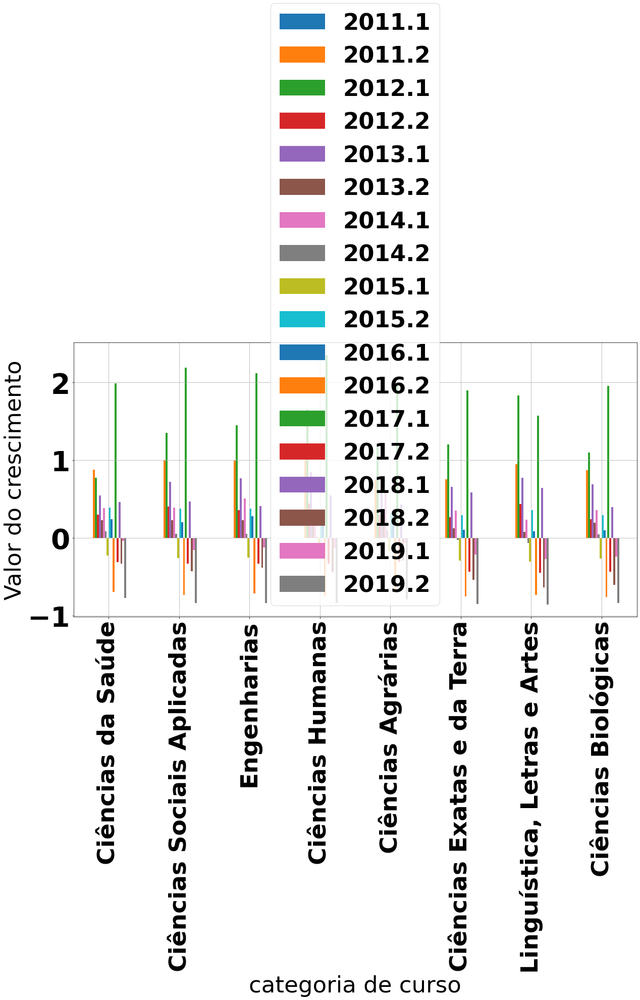

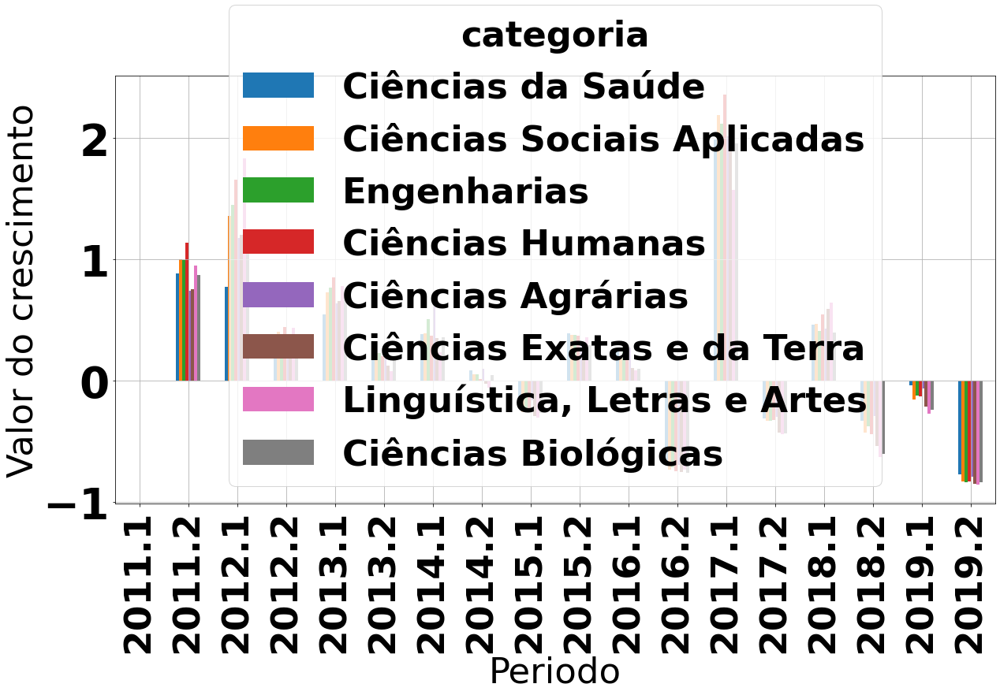

In [ ]:
graficoCategoriaCursoVsPeriodoCrescimento = dfSemestreCategoriaCursoPorcentagemCrescimento.plot.bar(
     grid=True, figsize= (20,10),
xlabel ="categoria de curso" ,ylabel= "Valor do crescimento")

graficoPorPeriodoVsCategoriaCursoCrescimento = dfSemestreCategoriaCursoPorcentagemCrescimentoTransposta.plot.bar(
     
grid=True, figsize= (20,10), xlabel ="Periodo" ,ylabel= "Valor do crescimento" )


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f405bb268b0>,
      dtype=object)

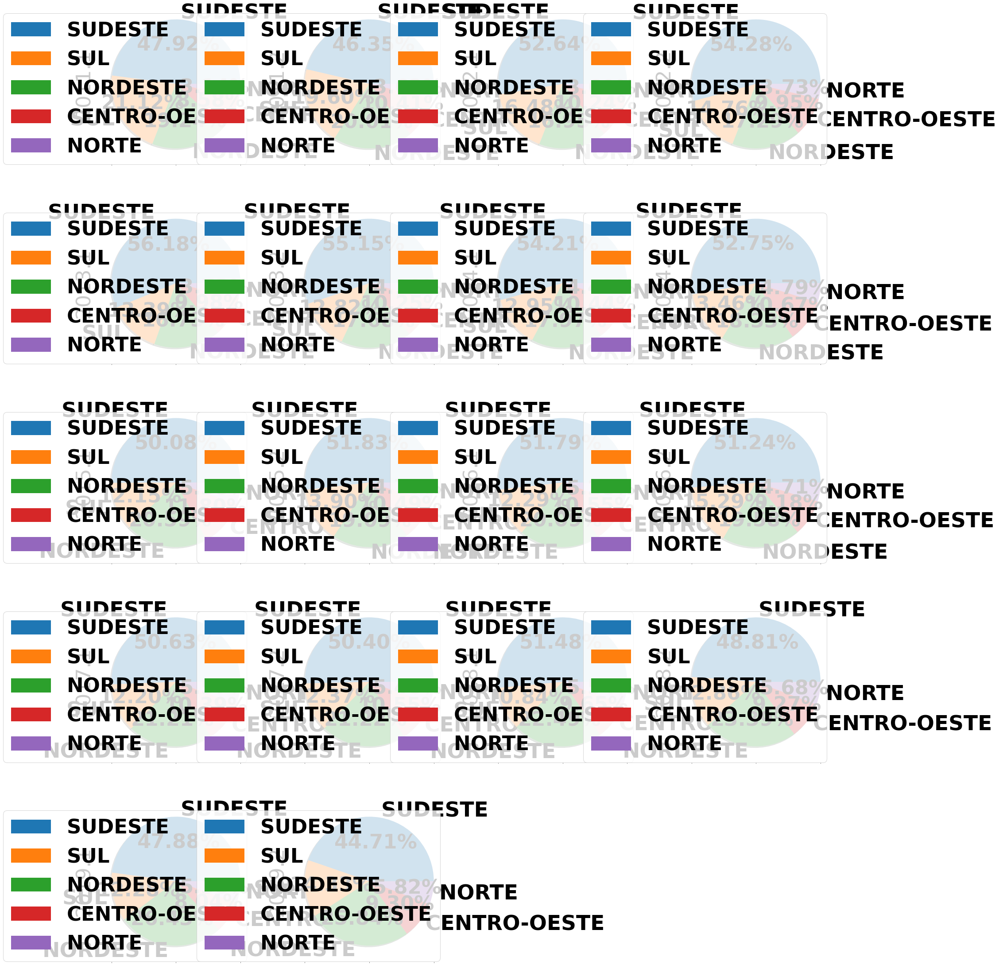

In [ ]:
dfSemestreRegiao.plot.pie(subplots=True, layout=(5,4), figsize=(30,40), shadow=True, autopct='%1.2f%%')

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f405b12b1f0>,
      dtype=object)

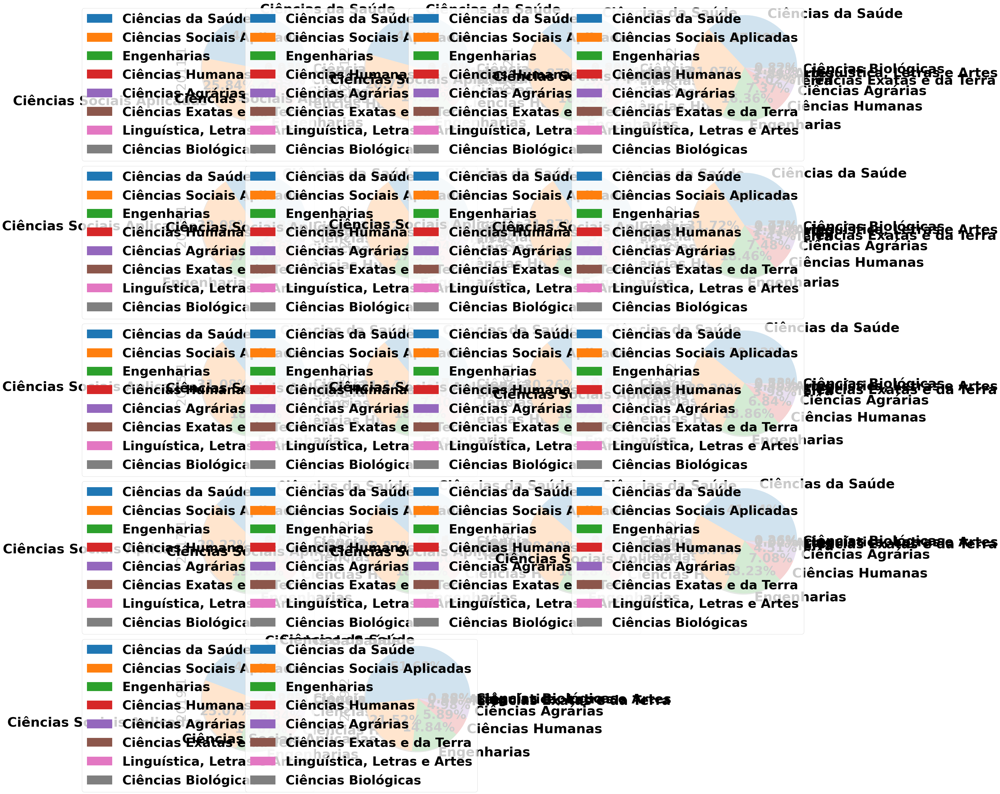

In [ ]:
dfSemestreCategoriaCurso.plot.pie(subplots=True, layout=(5,4), figsize=(40,50), shadow=True, autopct='%1.2f%%')

In [ ]:
dfSemestreRegiaoTransposta.sum()

região
SUDESTE         40894392744
SUL             10237461596
NORDESTE        16028622876
CENTRO-OESTE     8061702627
NORTE            3928466696
dtype: int64

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f404d82ad30>,
      dtype=object)

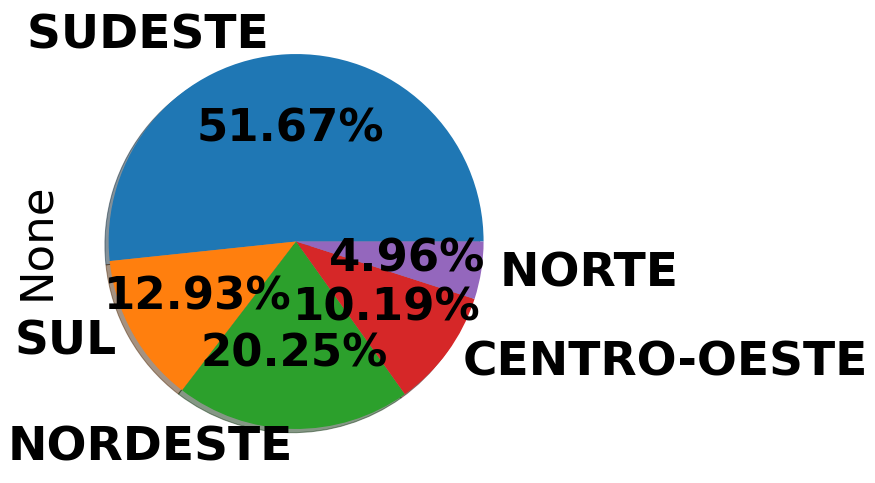

In [ ]:
dfSemestreRegiaoTransposta.sum().plot.pie(subplots=True, layout=(5,4), figsize=(40,50), shadow=True, autopct='%1.2f%%')

In [ ]:
dfSemestreCategoriaCursoTransposta.sum()

categoria
Ciências da Saúde              29599709620
Ciências Sociais Aplicadas     23640527613
Engenharias                    14381849998
Ciências Humanas                5904441073
Ciências Agrárias               2936371498
Ciências Exatas e da Terra      1509244459
Linguística, Letras e Artes      697872306
Ciências Biológicas              480629944
dtype: int64

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f404d34f2e0>,
      dtype=object)

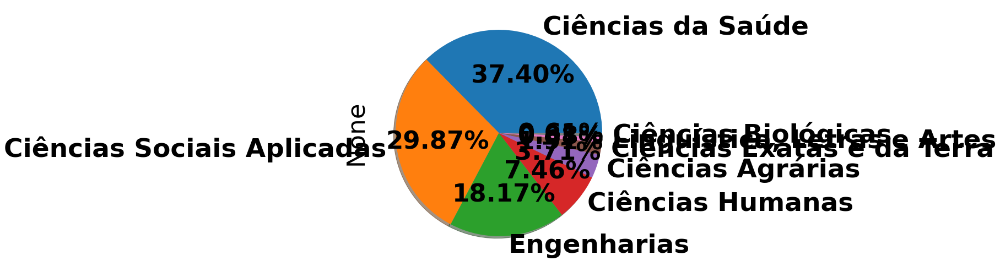

In [ ]:
dfSemestreCategoriaCursoTransposta.sum().plot.pie(subplots=True, layout=(5,4), figsize=(40,50), shadow=True, autopct='%1.2f%%')

##VALOR_ARQUIVO_PAGO

#Estimativa população brasileira


Usando os dados retirados no sidra, da estimativa da população brasileira por estado, temos:

In [ ]:
dfEstimativaPop = pd.read_csv('estimativa população brasileira.csv', engine='python', encoding="UTF-8", sep=';')
dfEstimativaPop.set_index('Brasil e Unidade da Federação', inplace=True)
dfEstimativaPop

,2011,2012,2013,2014,2015,2016,2017,2018,2019
Brasil e Unidade da Federação,,,,,,,,,
Brasil,192379287,193904015,201032714,202768562,204450049,206081432,207660929,208494900,210147125
Rondônia,1576455,1590011,1728214,1748531,1768204,1787279,1805788,1757589,1777225
Acre,746386,758786,776463,790101,803513,816687,829619,869265,881935
Amazonas,3538387,3590985,3807921,3873743,3938336,4001667,4063614,4080611,4144597
Roraima,460165,469524,488072,496936,505665,514229,522636,576568,605761
Pará,7688593,7777543,7969654,8073924,8175113,8272724,8366628,8513497,8602865
Amapá,684309,698602,734996,750912,766679,782295,797722,829494,845731
Tocantins,1400892,1417694,1478164,1496880,1515126,1532902,1550194,1555229,1572866
Maranhão,6645761,6714314,6794301,6850884,6904241,6954036,7000229,7035055,7075181


Usando os dados retirados no sidra, da estimativa da população brasileira por estado, separado por sexo, temos:

In [ ]:
pd.set_option('display.max_rows', 300)
dfEstimativaPopPorSexo = pd.read_csv('estimativa população brasileira por sexo.csv', engine='python', encoding="UTF-8", sep=';')
dfEstimativaPopPorSexo

,"Brasil, Grande Região e Unidade da Federação",#,Ano,Ano de edição da projeção x Sexo x Idade,Unnamed: 4,Unnamed: 5
0,"Brasil, Grande Região e Unidade da Federação",#,Ano,2018,NaN,NaN
1,"Brasil, Grande Região e Unidade da Federação",#,Ano,Total,Homens,Mulheres
2,"Brasil, Grande Região e Unidade da Federação",#,Ano,Total,Total,Total
3,Brasil,1,2011,196603732,96322635,100281097
4,Brasil,2,2012,198314934,97132054,101182880
5,Brasil,3,2013,200004188,97931331,102072857
6,Brasil,4,2014,201717541,98744098,102973443
7,Brasil,5,2015,203475683,99581002,103894681
8,Brasil,6,2016,205156587,100379640,104776947
9,Brasil,7,2017,206804741,101163599,105641142


Para facilitar a leitura, iremos analisar apenas por região, já que por estado está sendo analisado com os dados em dfEstimativaPop

In [ ]:
pd.set_option('display.max_rows', 46)
dfEstimativaPopPorSexoPorRegiao = pd.read_csv('estimativa população brasileira por sexo por região.csv', engine='python', encoding="UTF-8", sep=';')
dfEstimativaPopPorSexoPorRegiao

,Grande Região,#,Ano,Total,Homens,Mulheres
0,Norte,1,2011,16490166,8321963,8168203
1,Norte,2,2012,16732473,8439667,8292806
2,Norte,3,2013,16971695,8555588,8416107
3,Norte,4,2014,17214537,8673168,8541369
4,Norte,5,2015,17458469,8791176,8667293
5,Norte,6,2016,17691399,8903525,8787874
6,Norte,7,2017,17929800,9019452,8910348
7,Norte,8,2018,18182253,9143407,9038846
8,Norte,9,2019,18430980,9265204,9165776
9,Nordeste,1,2011,54552181,26617222,27934959


Iremos ordenar os dados de dfEstimativaPop, para facilitar a análise

In [ ]:
dfEstimativaSemTotal = dfEstimativaPop.drop('Brasil')
dfEstimativaSemTotal.sort_values(inplace=True, by='2011' )
dfEstimativaSemTotal

,2011,2012,2013,2014,2015,2016,2017,2018,2019
Brasil e Unidade da Federação,,,,,,,,,
Roraima,460165,469524,488072,496936,505665,514229,522636,576568,605761
Amapá,684309,698602,734996,750912,766679,782295,797722,829494,845731
Acre,746386,758786,776463,790101,803513,816687,829619,869265,881935
Tocantins,1400892,1417694,1478164,1496880,1515126,1532902,1550194,1555229,1572866
Rondônia,1576455,1590011,1728214,1748531,1768204,1787279,1805788,1757589,1777225
Sergipe,2089819,2110867,2195662,2219574,2242937,2265779,2288116,2278308,2298696
Mato Grosso do Sul,2477542,2500365,2587269,2619657,2651235,2682386,2713147,2748023,2778986
Distrito Federal,2609998,2648532,2789761,2852372,2914830,2977216,3039444,2974703,3015268
Mato Grosso,3075936,3115336,3182113,3224357,3265486,3305531,3344544,3441998,3484466


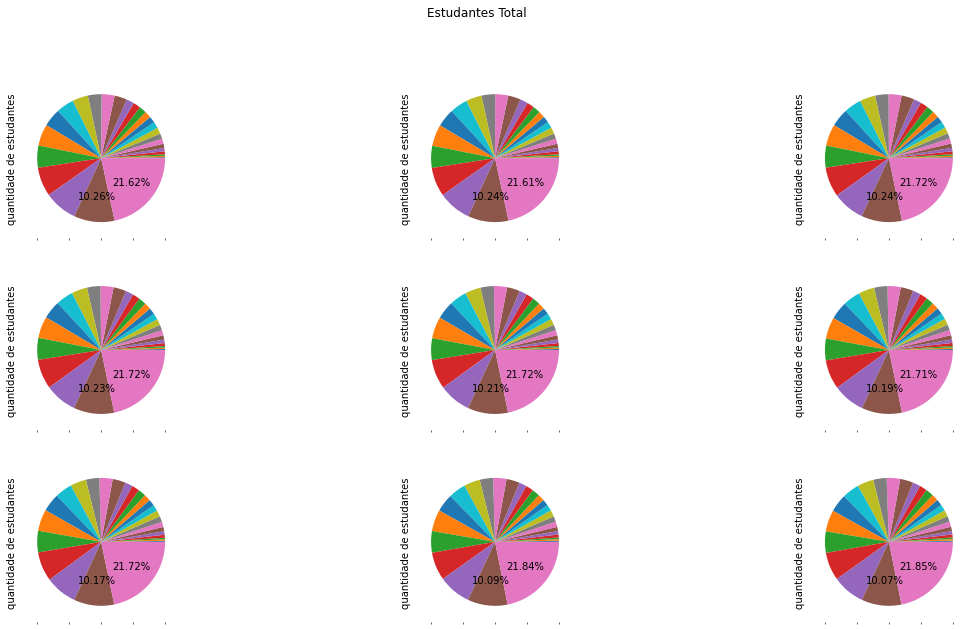

In [ ]:
autopct = lambda v: f'{v:.2f}%' if v > 10 else None
graficoEstimativaPopulacao = dfEstimativaSemTotal.plot.pie( layout=(3,3), grid=True, figsize= (20,10),
xlabel ="Estado" ,ylabel= "quantidade de estudantes", logy=True, subplots=True, legend=None, autopct=autopct, labels=None)

##Estimativas por ano dos estados

In [ ]:
dfEst2011 = dfEstimativaSemTotal.drop(['2012', '2013', '2014', '2015', '2016', '2017', '2018', '2019'], axis=1)

dfEst2012 = dfEstimativaSemTotal.drop(['2011', '2013', '2014', '2015', '2016', '2017', '2018', '2019'], axis=1)

dfEst2013 = dfEstimativaSemTotal.drop(['2012', '2011', '2014', '2015', '2016', '2017', '2018', '2019'], axis=1)

dfEst2014 = dfEstimativaSemTotal.drop(['2012', '2013', '2011', '2015', '2016', '2017', '2018', '2019'], axis=1)

dfEst2015 = dfEstimativaSemTotal.drop(['2012', '2013', '2014', '2011', '2016', '2017', '2018', '2019'], axis=1)

dfEst2016 = dfEstimativaSemTotal.drop(['2012', '2013', '2014', '2015', '2011', '2017', '2018', '2019'], axis=1)

dfEst2017 = dfEstimativaSemTotal.drop(['2012', '2013', '2014', '2015', '2016', '2011', '2018', '2019'], axis=1)

dfEst2018 = dfEstimativaSemTotal.drop(['2012', '2013', '2014', '2015', '2016', '2017', '2011', '2019'], axis=1)

dfEst2019 = dfEstimativaSemTotal.drop(['2012', '2013', '2014', '2015', '2016', '2017', '2018', '2011'], axis=1)


In [ ]:
dfEst2011

,2011
Brasil e Unidade da Federação,
Roraima,460165
Amapá,684309
Acre,746386
Tocantins,1400892
Rondônia,1576455
Sergipe,2089819
Mato Grosso do Sul,2477542
Distrito Federal,2609998
Mato Grosso,3075936


In [ ]:
dfEst2012

,2012
Brasil e Unidade da Federação,
Roraima,469524
Amapá,698602
Acre,758786
Tocantins,1417694
Rondônia,1590011
Sergipe,2110867
Mato Grosso do Sul,2500365
Distrito Federal,2648532
Mato Grosso,3115336


In [ ]:
dfEst2013

,2013
Brasil e Unidade da Federação,
Roraima,488072
Amapá,734996
Acre,776463
Tocantins,1478164
Rondônia,1728214
Sergipe,2195662
Mato Grosso do Sul,2587269
Distrito Federal,2789761
Mato Grosso,3182113


In [ ]:
dfEst2014

,2014
Brasil e Unidade da Federação,
Roraima,496936
Amapá,750912
Acre,790101
Tocantins,1496880
Rondônia,1748531
Sergipe,2219574
Mato Grosso do Sul,2619657
Distrito Federal,2852372
Mato Grosso,3224357


In [ ]:
dfEst2015

,2015
Brasil e Unidade da Federação,
Roraima,505665
Amapá,766679
Acre,803513
Tocantins,1515126
Rondônia,1768204
Sergipe,2242937
Mato Grosso do Sul,2651235
Distrito Federal,2914830
Mato Grosso,3265486


In [ ]:
dfEst2016

,2016
Brasil e Unidade da Federação,
Roraima,514229
Amapá,782295
Acre,816687
Tocantins,1532902
Rondônia,1787279
Sergipe,2265779
Mato Grosso do Sul,2682386
Distrito Federal,2977216
Mato Grosso,3305531


In [ ]:
dfEst2017

,2017
Brasil e Unidade da Federação,
Roraima,522636
Amapá,797722
Acre,829619
Tocantins,1550194
Rondônia,1805788
Sergipe,2288116
Mato Grosso do Sul,2713147
Distrito Federal,3039444
Mato Grosso,3344544


In [ ]:
dfEst2018

,2018
Brasil e Unidade da Federação,
Roraima,576568
Amapá,829494
Acre,869265
Tocantins,1555229
Rondônia,1757589
Sergipe,2278308
Mato Grosso do Sul,2748023
Distrito Federal,2974703
Mato Grosso,3441998


In [ ]:
dfEst2019

,2019
Brasil e Unidade da Federação,
Roraima,605761
Amapá,845731
Acre,881935
Tocantins,1572866
Rondônia,1777225
Sergipe,2298696
Mato Grosso do Sul,2778986
Distrito Federal,3015268
Mato Grosso,3484466
